## THƯ VIỆN

In [1]:
!pip install -q transformers==4.44.2 pillow tqdm matplotlib pandas nltk rouge-score

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.7/43.7 kB 1.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.5/9.5 MB 64.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 566.1/566.1 kB 27.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 82.5 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
datasets 4.1.1 requires pyarrow>=21.0.0, but you have pyarrow 19.0.1 which is incompatible.
gradio 5.38.1 requires pydantic<2.12,>=2.0, but you have pydantic 2.12.0a1 which is incompatible.


In [2]:
import os
import json
import csv
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from collections import defaultdict, Counter
from PIL import Image
from pathlib import Path
from sklearn.model_selection import train_test_split

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torchvision.models as models
import torchvision.transforms as transforms
from torch.cuda.amp import autocast, GradScaler

import nltk
from nltk.translate.bleu_score import corpus_bleu, SmoothingFunction
from nltk.translate.meteor_score import meteor_score
from rouge_score import rouge_scorer
from tqdm import tqdm

import matplotlib
import matplotlib.pyplot as plt

# Đặt font có hỗ trợ tiếng Việt
plt.rcParams['font.family'] = 'DejaVu Sans'   # bạn có thể thử một font khác
plt.rcParams['axes.unicode_minus'] = False    # tránh lỗi dấu âm bị mất

# Hoặc nếu máy bạn có font Arial Unicode / Noto Sans / Times New Roman
plt.rcParams['font.sans-serif'] = ['Arial Unicode MS', 'Tahoma', 'Noto Sans', 'Times New Roman']


# Download NLTK data
nltk.download('punkt')
nltk.download('punkt_tab')
nltk.download('wordnet')
nltk.download('omw-1.4')


# os.environ["CUDA_enSIBLE_DEVICES"] = "1"  # Sử dụng GPU số 1
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")


[nltk_data] Downloading package punkt to /usr/share/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to /usr/share/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package wordnet to /usr/share/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /usr/share/nltk_data...


Using device: cuda


## TĂNG CƯỜNG DỮ LIỆU

In [ ]:
import os
import base64
import pandas as pd
from pathlib import Path
from openai import OpenAI
import time
from tqdm import tqdm

# ==============================
# CONFIG
# ==============================
API_KEY = "key"  # ← thay bằng key thật
IMG_DIR = Path("./data/adityajn105/flickr8k/Images")

OUTPUT_EN = "captions_gpt_en.csv"
OUTPUT_en = "captions_gpt_en.csv"

client = OpenAI(api_key=API_KEY)

# ==============================
# GPT CALL
# ==============================
def generate_bilingual_captions(image_path: Path):
    """Gửi ảnh đến GPT-4o-mini, sinh caption cả tiếng Anh và tiếng Việt"""
    try:
        with open(image_path, "rb") as f:
            img_base64 = base64.b64encode(f.read()).decode("utf-8")

        response = client.chat.completions.create(
            model="gpt-4o-mini",
            messages=[
                {
                    "role": "user",
                    "content": [
                        {
                            "type": "text",
                            "text": (
                                "You are a bilingual image captioning assistant. "
                                "Describe the image naturally in both English and ENGLISH.\n\n"
                                "Output format (no extra words):\n"
                                "EN:\n"
                                "- caption 1\n"
                                "- caption 2\n"
                                "VI:\n"
                                "- caption 1\n"
                                "- caption 2\n\n"
                                "Each caption < 15 words."
                            ),
                        },
                        {
                            "type": "image_url",
                            "image_url": {
                                "url": f"data:image/jpeg;base64,{img_base64}"
                            }
                        }
                    ],
                }
            ],
            max_tokens=250,
        )

        return response.choices[0].message.content.strip()

    except Exception as e:
        print(f"❌ Error on {image_path.name}: {e}")
        return None


# ==============================
# PARSE GPT OUTPUT
# ==============================
def parse_bilingual_output(text):
    """Tách phần tiếng Anh và tiếng Việt"""
    lines = [l.strip(" -•\t") for l in text.split("\n") if l.strip()]
    en, vi, mode = [], [], None
    for line in lines:
        if line.lower().startswith("en"):
            mode = "en"
        elif line.lower().startswith("vi"):
            mode = "vi"
        elif mode == "en":
            en.append(line)
        elif mode == "vi":
            vi.append(line)
    return en, vi


# ==============================
# INITIALIZE OR RESUME
# ==============================
processed_images = set()
if Path(OUTPUT_EN).exists():
    df_en = pd.read_csv(OUTPUT_EN)
    processed_images.update(df_en["image"].unique().tolist())
if Path(OUTPUT_en).exists():
    df_en = pd.read_csv(OUTPUT_en)
    processed_images.update(df_en["image"].unique().tolist())

print(f"🔁 Resuming... {len(processed_images)} images already processed.\n")

# ==============================
# MAIN LOOP
# ==============================
all_images = list(IMG_DIR.glob("*.jpg"))

# test 5 ảnh đầu tiên
for img_path in tqdm(all_images[:800], desc="Generating captions"):
    if img_path.name in processed_images:
        continue  # Skip ảnh đã có
    
    captions_text = generate_bilingual_captions(img_path)
    if not captions_text:
        continue

    en_caps, en_caps = parse_bilingual_output(captions_text)

    # Ghi incremental từng ảnh
    if en_caps:
        df_en = pd.DataFrame([{"image": img_path.name, "caption": cap} for cap in en_caps])
        df_en.to_csv(OUTPUT_EN, mode='a', index=False, header=not Path(OUTPUT_EN).exists())

    if en_caps:
        df_en = pd.DataFrame([{"image": img_path.name, "caption": cap} for cap in en_caps])
        df_en.to_csv(OUTPUT_en, mode='a', index=False, header=not Path(OUTPUT_en).exists())

    processed_images.add(img_path.name)
    time.sleep(1.5)  # tránh rate limit

print(f"\n🎯 Completed! Processed {len(processed_images)} images total.")
print(f"📁 English captions → {OUTPUT_EN}")
print(f"📁 ENGLISH captions → {OUTPUT_en}")

## PHẦN A: LOAD DỮ LIỆU/TRỰC QUAN HÓA

In [4]:
import csv
from collections import defaultdict
from pathlib import Path

# ==============================
# CONFIG PATHS (Kaggle)
# ==============================
# Dataset 1: flickr8k  → chứa Images + captions.txt
BASE_DIR = Path("/kaggle/input/flickr8k")

# Dataset 2: gen-data  → chứa captions_gpt_en.csv + captions_gemini_en.csv
GEN_INPUT_DIR = Path("/kaggle/input/gen-data")

# Thư mục output
GEN_DIR = Path("/kaggle/working/gen_data")

IMG_DIR = BASE_DIR / "Images"
print(f"📁 Ảnh: {IMG_DIR}")

# File captions gốc
EN_CAP_FILE = BASE_DIR / "captions.txt"

# File tự sinh
EN_GPT_FILE = GEN_INPUT_DIR / "captions_gpt_en.csv"
EN_GEMINI_FILE = GEN_INPUT_DIR / "captions_gemini_en.csv"

# ==============================
# HÀM HỖ TRỢ
# ==============================
def normalize_name(name: str) -> str:
    """Đưa tên ảnh về dạng chuẩn"""
    return Path(name.strip()).name


def load_captions_csv(path: Path):
    """Đọc file CSV có format: image,caption (có thể có hoặc không header)"""
    caps = defaultdict(list)
    if not path.exists():
        print(f"⚠️ Không tìm thấy {path}")
        return caps

    with open(path, "r", encoding="utf-8-sig") as f:
        reader = csv.reader(f)
        header_checked = False
        for row in reader:
            if not row or len(row) < 2:
                continue
            if not header_checked:
                if row[0].lower() == "image" and row[1].lower() == "caption":
                    header_checked = True
                    continue
                header_checked = True
            img = normalize_name(row[0])
            cap = row[1].strip()
            if img and cap:
                caps[img].append(cap)
    print(f"📄 Loaded {len(caps)} ảnh từ {path.name}")
    return caps
def load_captions_csv(path: Path):
    """Đọc file CSV có format: image,caption (có thể có hoặc không header)"""
    caps = defaultdict(list)
    if not path.exists():
        print(f"⚠️ Không tìm thấy {path}")
        return caps

    with open(path, "r", encoding="utf-8-sig") as f:
        reader = csv.reader(f)
        header_checked = False
        for row in reader:
            if not row or len(row) < 2:
                continue
            # Bỏ header nếu có
            if not header_checked:
                if row[0].lower() == "image" and row[1].lower() == "caption":
                    header_checked = True
                    continue
                header_checked = True
            img = Path(row[0].strip()).name
            cap = row[1].strip()
            if img and cap:
                caps[img].append(cap)
    print(f"📄 Loaded {len(caps)} ảnh từ {path.name}")
    return caps


def load_en_captions_tab(path: Path):
    """Đọc file gốc captions.txt (dạng CSV: image,caption, có thể có header)"""
    caps = defaultdict(list)
    if not path.exists():
        print(f"⚠️ Không tìm thấy {path}")
        return caps

    with open(path, "r", encoding="utf-8-sig") as f:
        reader = csv.reader(f)
        header_checked = False
        for row in reader:
            if not row or len(row) < 2:
                continue

            # ✅ Bỏ header nếu có
            if not header_checked:
                if row[0].lower() == "image" and row[1].lower() == "caption":
                    header_checked = True
                    continue
                header_checked = True

            img = normalize_name(row[0])
            cap = row[1].strip()
            if img and cap:
                caps[img].append(cap)
    print(f"📄 Loaded {len(caps)} ảnh từ {path.name}")
    return caps



def merge_captions(*dicts):
    merged = defaultdict(list)
    for d in dicts:
        for img, captions in d.items():
            merged[img].extend(captions)
    return merged


def count_total(caps):
    total_caps = sum(len(v) for v in caps.values())
    return len(caps), total_caps


# ==============================
# LOAD DỮ LIỆU
# ==============================
en_caps_base = load_en_captions_tab(EN_CAP_FILE)
en_caps_gpt = load_captions_csv(EN_GPT_FILE)
en_caps_gemini = load_captions_csv(EN_GEMINI_FILE)

# ==============================
# GỘP LẠI
# ==============================
all_en = merge_captions(en_caps_base, en_caps_gpt, en_caps_gemini)
n_img_en, n_cap_en = count_total(all_en)
print(f"✅ EN: {n_img_en} ảnh, {n_cap_en} captions total")

# ==============================
# LƯU RA FILE HỢP NHẤT
# ==============================
GEN_DIR.mkdir(exist_ok=True, parents=True)
out_path = GEN_DIR / "captions_en_full.csv"

with open(out_path, "w", newline='', encoding="utf-8") as f:
    writer = csv.writer(f)
    writer.writerow(["image", "caption"])
    for img, caps in all_en.items():
        for cap in caps:
            writer.writerow([img, cap])

print(f"\n💾 Saved merged file to: {out_path}")


📁 Ảnh: /kaggle/input/flickr8k/Images
📄 Loaded 8091 ảnh từ captions.txt
📄 Loaded 843 ảnh từ captions_gpt_en.csv
📄 Loaded 175 ảnh từ captions_gemini_en.csv
✅ EN: 8091 ảnh, 42553 captions total

💾 Saved merged file to: /kaggle/working/gen_data/captions_en_full.csv


In [5]:
print(list(all_en.keys())[:10])

['1000268201_693b08cb0e.jpg', '1001773457_577c3a7d70.jpg', '1002674143_1b742ab4b8.jpg', '1003163366_44323f5815.jpg', '1007129816_e794419615.jpg', '1007320043_627395c3d8.jpg', '1009434119_febe49276a.jpg', '1012212859_01547e3f17.jpg', '1015118661_980735411b.jpg', '1015584366_dfcec3c85a.jpg']


### CHIA DỮ LIỆU

In [6]:
from sklearn.model_selection import train_test_split

# ==============================
# DÙNG DATA TỔNG (sau merge)
# ==============================
# Lấy danh sách ảnh có đủ EN & VI caption
common_images = list(set(all_en.keys()))
print(f"📊 Số ảnh có cả EN caption: {len(common_images)}")

# ==============================
# CHIA TẬP DỮ LIỆU
# ==============================
# Split: 80% train, 10% val, 10% test
train_imgs, temp_imgs = train_test_split(common_images, test_size=0.2, random_state=42)
val_imgs, test_imgs = train_test_split(temp_imgs, test_size=0.5, random_state=42)

print(f"\n📂 Data split:")
print(f"   - Train: {len(train_imgs)} images")
print(f"   - Val:   {len(val_imgs)} images")
print(f"   - Test:  {len(test_imgs)} images")

# ==============================
# TẠO TỪ ĐIỂN CAPTION CHO MỖI TẬP
# ==============================
# ENGLISH
en_train_caps = {img: all_en[img] for img in train_imgs}
en_val_caps = {img: all_en[img] for img in val_imgs}
en_test_caps = {img: all_en[img] for img in test_imgs}
en_caps = {**en_train_caps, **en_val_caps, **en_test_caps}  # IGNORE

print("\n✅ Đã tạo 2 bộ dữ liệu train/val/test dựa trên data tổng hợp EN")


📊 Số ảnh có cả EN caption: 8091

📂 Data split:
   - Train: 6472 images
   - Val:   809 images
   - Test:  810 images

✅ Đã tạo 2 bộ dữ liệu train/val/test dựa trên data tổng hợp EN


### EDA

Thống kê:
- VI: mean=11.6, min=1, max=38


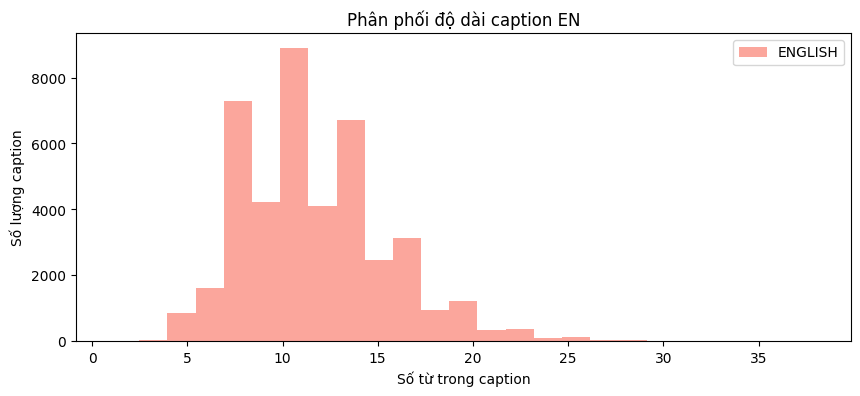

In [7]:
import numpy as np

def tokenize(s): return s.split()

# Fix: Access the values correctly from the dictionaries
len_en = [len(tokenize(cap)) for caps in en_caps.values() for cap in caps]

print("Thống kê:")
print(f"- VI: mean={np.mean(len_en):.1f}, min={np.min(len_en)}, max={np.max(len_en)}")

plt.figure(figsize=(10,4))
plt.hist(len_en, bins=25, color='salmon', alpha=0.7, label="ENGLISH")
plt.legend()
plt.xlabel("Số từ trong caption")
plt.ylabel("Số lượng caption")
plt.title("Phân phối độ dài caption EN")
plt.show()


📊 EXPLORATORY DATA ANALYSIS - ENGLISH ONLY

🖼️ Sample Images with ENGLISH Captions:



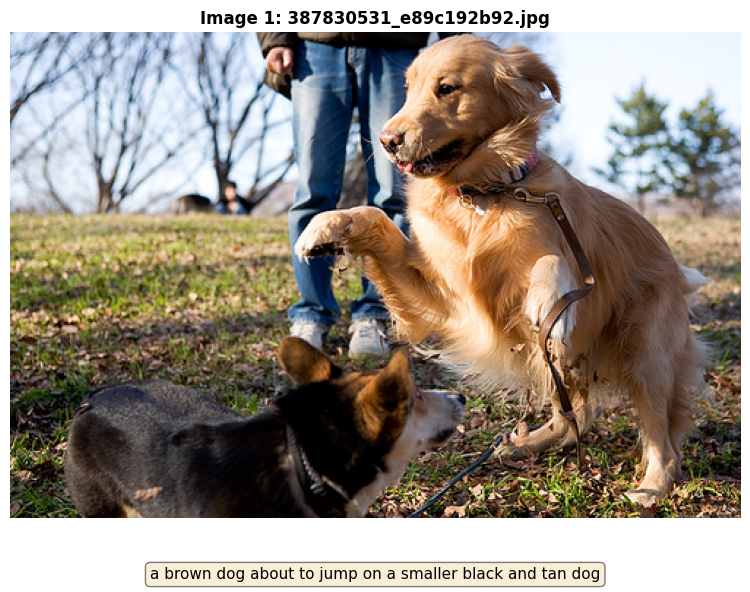

EN: a brown dog about to jump on a smaller black and tan dog



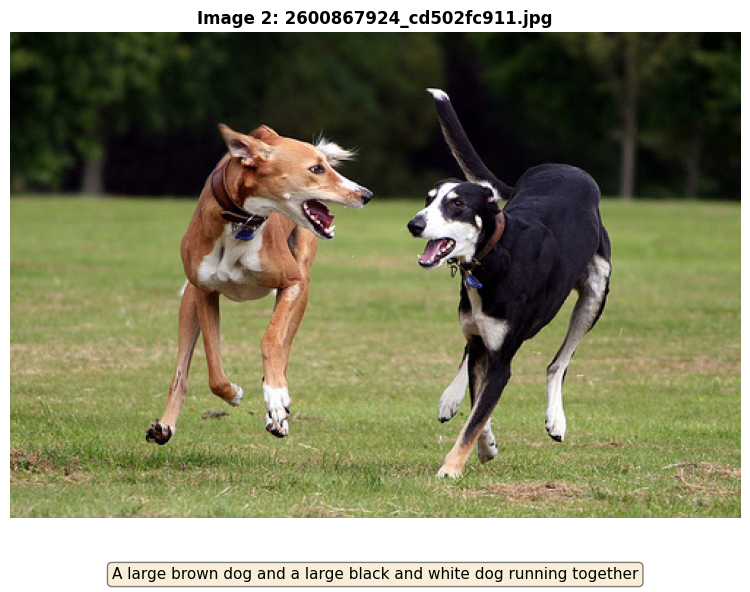

EN: A large brown dog and a large black and white dog running together



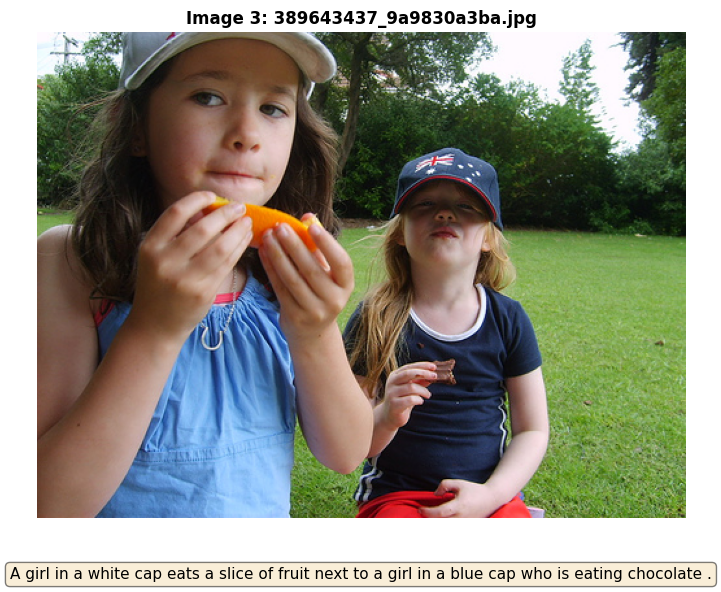

EN: A girl in a white cap eats a slice of fruit next to a girl in a blue cap who is eating chocolate .



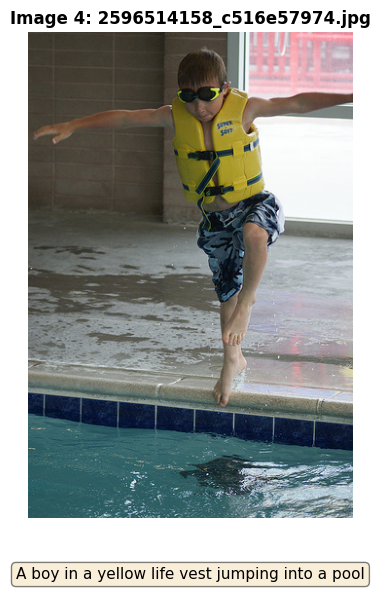

EN: A boy in a yellow life vest jumping into a pool



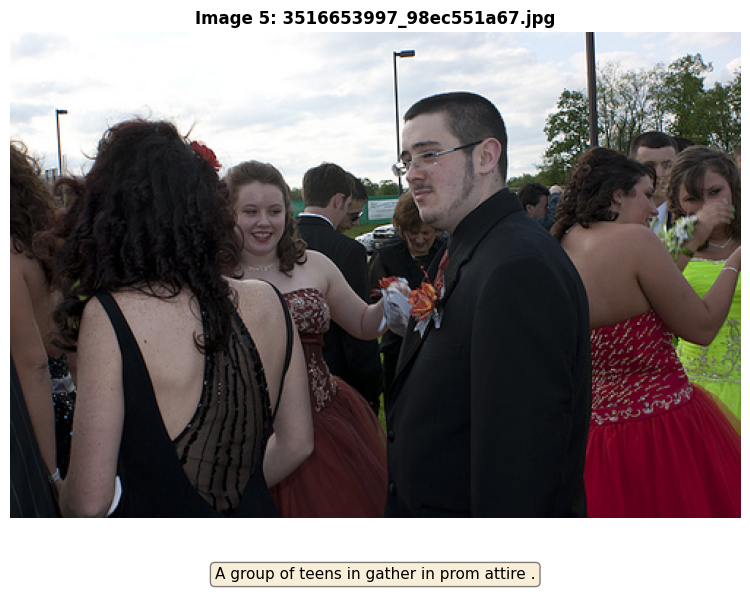

EN: A group of teens in gather in prom attire .


📏 Phân phối độ dài caption (ENGLISH):



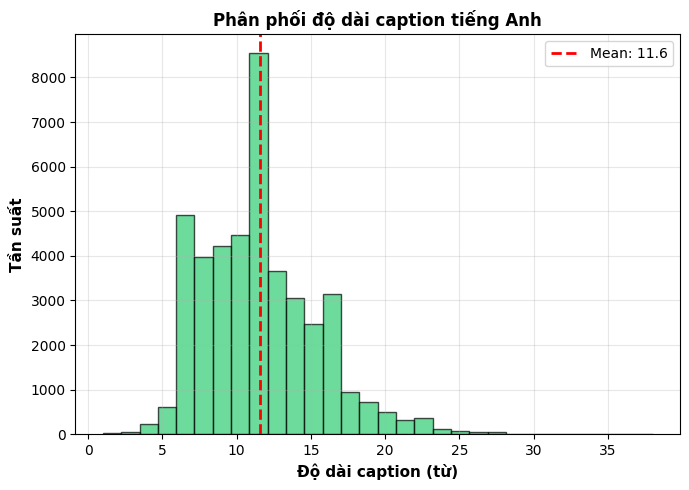

ENGLISH Captions:
   - Mean length: 11.59 words
   - Median length: 11.00 words
   - Min: 1, Max: 38

📚 Vocabulary Statistics (ENGLISH):
   - Unique words: 9932


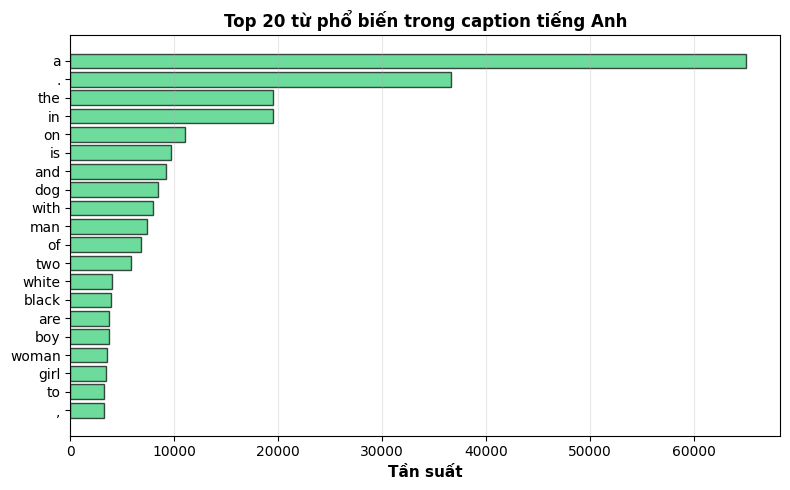


✅ EDA (ENGLISH Only) Completed!


In [8]:
# %% [markdown]
# ## Exploratory Data Analysis (EDA) - ENGLISH Captions Only

# %%
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
import numpy as np

print("=" * 60)
print("📊 EXPLORATORY DATA ANALYSIS - ENGLISH ONLY")
print("=" * 60)

# 1. Hiển thị ảnh mẫu với caption VI
print("\n🖼️ Sample Images with ENGLISH Captions:\n")

sample_images = common_images[10:15]  # Lấy 5 ảnh từ vị trí 10 đến 15

for idx, img_name in enumerate(sample_images, 1):
    img_path = IMG_DIR / img_name
    image = Image.open(img_path).convert("RGB")

    en_caption = en_caps[img_name][0]

    plt.figure(figsize=(10, 6))
    plt.imshow(image)
    plt.axis('off')
    plt.title(f"Image {idx}: {img_name}", fontsize=12, fontweight='bold')

    caption_text = f"{en_caption}"
    plt.text(0.5, -0.1, caption_text, transform=plt.gca().transAxes,
             fontsize=11, ha='center', va='top', 
             bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

    plt.tight_layout()
    plt.show()
    print(f"EN: {en_caption}\n")

# 2. Phân phối độ dài caption 🇻🇳
print("\n📏 Phân phối độ dài caption (ENGLISH):\n")

en_lengths = [len(cap.split()) for caps in en_caps.values() for cap in caps]

plt.figure(figsize=(7, 5))
plt.hist(en_lengths, bins=30, color='#2ecc71', alpha=0.7, edgecolor='black')
plt.axvline(np.mean(en_lengths), color='red', linestyle='--', linewidth=2, label=f'Mean: {np.mean(en_lengths):.1f}')
plt.xlabel('Độ dài caption (từ)', fontsize=11, fontweight='bold')
plt.ylabel('Tần suất', fontsize=11, fontweight='bold')
plt.title('Phân phối độ dài caption tiếng Anh', fontsize=12, fontweight='bold')
plt.legend()
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

print(f"ENGLISH Captions:")
print(f"   - Mean length: {np.mean(en_lengths):.2f} words")
print(f"   - Median length: {np.median(en_lengths):.2f} words")
print(f"   - Min: {min(en_lengths)}, Max: {max(en_lengths)}")

# 3. Vocabulary size estimation 🇻🇳
en_words = [word for caps in en_caps.values() for cap in caps for word in cap.lower().split()]
en_vocab_size = len(set(en_words))
en_common = Counter(en_words).most_common(20)

print(f"\n📚 Vocabulary Statistics (ENGLISH):")
print(f"   - Unique words: {en_vocab_size}")

# Biểu đồ top 20 từ phổ biến 🇻🇳
words_en, counts_en = zip(*en_common)

plt.figure(figsize=(8, 5))
plt.barh(words_en, counts_en, color='#2ecc71', alpha=0.7, edgecolor='black')
plt.xlabel('Tần suất', fontsize=11, fontweight='bold')
plt.title('Top 20 từ phổ biến trong caption tiếng Anh', fontsize=12, fontweight='bold')
plt.gca().invert_yaxis()
plt.grid(axis='x', alpha=0.3)
plt.tight_layout()
plt.show()

print("\n✅ EDA (ENGLISH Only) Completed!")


In [9]:
# !pip install wordcloud

In [10]:
# from wordcloud import WordCloud

# font_en = "/usr/share/fonts/truetype/dejavu/DejaVuSans.ttf"  # kiểm tra tồn tại
# text_en = " ".join(en_words)

# plt.subplot(1,2,2)
# plt.imshow(WordCloud(width=600, height=400, background_color='white', font_path=font_en).generate(text_en))
# plt.title("ENGLISH WordCloud")
# plt.axis('off')
# plt.show()


## PHẦN B: XÂY DỰNG CLASSES CHUNG

In [11]:
# %% [markdown]
# ## Vocabulary Class (dùng chung cho cả EN và VI)

import re

# %%
class Vocabulary:
    def __init__(self, freq_threshold=5):
        self.itos = {0: "<PAD>", 1: "<SOS>", 2: "<EOS>", 3: "<UNK>"}
        self.stoi = {v: k for k, v in self.itos.items()}
        self.freq_threshold = freq_threshold

    def __len__(self):
        return len(self.itos)

    def tokenizer(self, text):
        return nltk.tokenize.word_tokenize(text.lower())
    
    # def tokenizer(self, text):
    # # Giống nhau cho cả EN/VI — split theo khoảng trắng, bỏ punctuation
    #     text = text.lower()
    #     text = re.sub(r"[^a-zA-Z0-9áàảãạăâđêêéèẻẽẹôơưúùụủũýỳỷỹỵ\s]", "", text)
    #     return text.strip().split()
    
    
    # def tokenizer(self, text):
    #     return word_tokenize(text.lower(), format="text").split()

    def build_vocab(self, sentence_list):
        freqs = Counter()
        for sent in tqdm(sentence_list, desc="Building vocab"):
            for word in self.tokenizer(sent):
                freqs[word] += 1
        
        for word, freq in freqs.items():
            if freq >= self.freq_threshold:
                idx = len(self.itos)
                self.itos[idx] = word
                self.stoi[word] = idx
        
        print(f"   ✅ Vocab size: {len(self)} words (freq >= {self.freq_threshold})")

    def numericalize(self, text):
        tokenized = self.tokenizer(text)
        return [self.stoi.get(token, self.stoi["<UNK>"]) for token in tokenized]

print("✅ Vocabulary class defined")

✅ Vocabulary class defined


In [12]:
# %% [markdown]
# ## FlickrDataset Class

# %%
class FlickrDataset(Dataset):
    def __init__(self, img_folder, captions_dict, vocab, transform=None):
        self.img_folder = img_folder
        self.captions_dict = captions_dict
        self.vocab = vocab
        self.transform = transform
        self.pairs = [(img, cap) for img, caps in captions_dict.items() for cap in caps]

    def __len__(self):
        return len(self.pairs)

    def __getitem__(self, idx):
        img_name, caption = self.pairs[idx]
        img_path = self.img_folder / img_name
        image = Image.open(img_path).convert("RGB")

        if self.transform:
            image = self.transform(image)

        numericalized = [self.vocab.stoi["<SOS>"]]
        numericalized += self.vocab.numericalize(caption)
        numericalized.append(self.vocab.stoi["<EOS>"])

        return image, torch.tensor(numericalized)

def collate_fn(batch, pad_idx):
    """Custom collate function với pad_idx"""
    batch.sort(key=lambda x: len(x[1]), reverse=True)
    images, captions = zip(*batch)
    
    images = torch.stack(images, 0)
    lengths = [len(cap) for cap in captions]
    targets = nn.utils.rnn.pad_sequence(captions, batch_first=True, padding_value=pad_idx)
    return images, targets, lengths

print("✅ Dataset class defined")

✅ Dataset class defined


In [13]:
# %% [markdown]
# ## Model Architecture (EncoderCNN + DecoderRNN)

# %%
class EncoderCNN(nn.Module):
    def __init__(self, embed_size):
        super().__init__()
        resnet = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V1)
        modules = list(resnet.children())[:-1]
        self.resnet = nn.Sequential(*modules)
        self.linear = nn.Linear(resnet.fc.in_features, embed_size)
        self.bn = nn.BatchNorm1d(embed_size, momentum=0.01)

    def forward(self, images):
        with torch.no_grad():
            features = self.resnet(images)
        features = features.reshape(features.size(0), -1)
        features = self.bn(self.linear(features))
        return features

class DecoderRNN(nn.Module):
    def __init__(self, embed_size, hidden_size, vocab_size, num_layers=1):
        super().__init__()
        self.embed = nn.Embedding(vocab_size, embed_size)
        self.lstm = nn.LSTM(embed_size, hidden_size, num_layers, batch_first=True)
        self.linear = nn.Linear(hidden_size, vocab_size)
        self.dropout = nn.Dropout(0.5)

    def forward(self, features, captions, lengths):
        embeddings = self.dropout(self.embed(captions))
        embeddings = torch.cat((features.unsqueeze(1), embeddings), 1)
        packed = nn.utils.rnn.pack_padded_sequence(embeddings, lengths, batch_first=True, enforce_sorted=False)
        hiddens, _ = self.lstm(packed)
        outputs = self.linear(hiddens.data)
        return outputs

print("✅ Model architecture defined")

✅ Model architecture defined


## PHẦN B: XÂY DỰNG MODEL TIẾNG ANH

In [14]:
# %%
print("=" * 60)
print("BUILDING ENGLISH MODEL")
print("=" * 60)

# Build vocab từ train captions
all_en_train_captions = [cap for caps in en_train_caps.values() for cap in caps]
vocab_en = Vocabulary(freq_threshold=5)
vocab_en.build_vocab(all_en_train_captions)

print(f"✅ ENGLISH vocabulary: {len(vocab_en)} words")

BUILDING ENGLISH MODEL


Building vocab: 100%|██████████| 34057/34057 [00:02<00:00, 15175.89it/s]

   ✅ Vocab size: 2802 words (freq >= 5)
✅ ENGLISH vocabulary: 2802 words


In [15]:
# ==============================
# 🧹 CLEAN DATA - Lọc bỏ ảnh không hợp lệ
# ==============================
print("\n🔧 Cleaning invalid image names...")

invalid_names = ['image', 'caption', 'photo', '']
all_en_cleaned = {}

for img_name, captions in all_en.items():
    img_lower = img_name.lower()
    
    # Bỏ qua nếu tên trong blacklist
    if img_lower in invalid_names:
        print(f"   ⚠️  Skipped invalid name: '{img_name}'")
        continue
    
    # Bỏ qua nếu không có extension .jpg/.png
    if not (img_name.endswith('.jpg') or img_name.endswith('.png') or img_name.endswith('.jpeg')):
        print(f"   ⚠️  Skipped no extension: '{img_name}'")
        continue
    
    # Bỏ qua nếu file không tồn tại
    if not (IMG_DIR / img_name).exists():
        print(f"   ⚠️  Skipped missing file: '{img_name}'")
        continue
    
    # ✅ Hợp lệ → giữ lại
    all_en_cleaned[img_name] = captions

# Thay thế dict gốc
removed_count = len(all_en) - len(all_en_cleaned)
all_en = all_en_cleaned

print(f"\n✅ Cleaned: Removed {removed_count} invalid entries")
print(f"   Valid images: {len(all_en)}")
print(f"   Total captions: {sum(len(caps) for caps in all_en.values())}")

# Cập nhật lại common_images
common_images = list(all_en.keys())
print(f"📊 Updated common images: {len(common_images)}")



🔧 Cleaning invalid image names...

✅ Cleaned: Removed 0 invalid entries
   Valid images: 8091
   Total captions: 42553
📊 Updated common images: 8091


In [16]:
def vocab_coverage(vocab, captions_dict):
    total_tokens, covered_tokens = 0, 0
    for caps in captions_dict.values():
        for cap in caps:
            tokens = vocab.tokenizer(cap)
            total_tokens += len(tokens)
            covered_tokens += sum(t in vocab.stoi for t in tokens)
    return covered_tokens / total_tokens * 100

cov_val = vocab_coverage(vocab_en, en_val_caps)
cov_test = vocab_coverage(vocab_en, en_test_caps)
print(f"🔍 Coverage on val set: {cov_val:.2f}%")
print(f"🔍 Coverage on test set: {cov_test:.2f}%")


🔍 Coverage on val set: 97.12%
🔍 Coverage on test set: 97.24%


In [17]:
from functools import partial

transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# %%
# Datasets
en_train_dataset = FlickrDataset(IMG_DIR, en_train_caps, vocab_en, transform=transform)
en_val_dataset = FlickrDataset(IMG_DIR, en_val_caps, vocab_en, transform=transform)
en_test_dataset = FlickrDataset(IMG_DIR, en_test_caps, vocab_en, transform=transform)

# Collate function với pad_idx của vocab VI
collate_fn_en = partial(collate_fn, pad_idx=vocab_en.stoi["<PAD>"])

# DataLoaders
en_train_loader = DataLoader(en_train_dataset, batch_size=64, shuffle=True, 
                             collate_fn=collate_fn_en, num_workers=4, pin_memory=True)
en_val_loader = DataLoader(en_val_dataset, batch_size=64, shuffle=False, 
                           collate_fn=collate_fn_en, num_workers=4, pin_memory=True)
en_test_loader = DataLoader(en_test_dataset, batch_size=64, shuffle=False, 
                            collate_fn=collate_fn_en, num_workers=4, pin_memory=True)

print(f"✅ ENGLISH DataLoaders ready:")
print(f"   - Train: {len(en_train_loader)} batches")
print(f"   - Val:   {len(en_val_loader)} batches")
print(f"   - Test:  {len(en_test_loader)} batches")

✅ ENGLISH DataLoaders ready:
   - Train: 533 batches
   - Val:   67 batches
   - Test:  66 batches


In [18]:
# Hyperparameters
embed_size = 512
hidden_size = 512
num_layers = 1

# %%
vocab_size_en = len(vocab_en)

# Models
encoder_en = EncoderCNN(embed_size).to(device)
decoder_en = DecoderRNN(embed_size, hidden_size, vocab_size_en, num_layers).to(device)

# Loss & Optimizer
criterion_en = nn.CrossEntropyLoss(ignore_index=vocab_en.stoi["<PAD>"])
params_en = (list(decoder_en.parameters()) + 
             list(encoder_en.linear.parameters()) + 
             list(encoder_en.bn.parameters()))
optimizer_en = torch.optim.Adam(params_en, lr=3e-4)

print(f"✅ ENGLISH Model initialized:")
print(f"   - Vocab size: {vocab_size_en}")
print(f"   - Embed size: {embed_size}")
print(f"   - Hidden size: {hidden_size}")

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 207MB/s]


✅ ENGLISH Model initialized:
   - Vocab size: 2802
   - Embed size: 512
   - Hidden size: 512


In [19]:
import torch
import torch.nn as nn
from torch.cuda.amp import GradScaler, autocast
from tqdm import tqdm
from pathlib import Path

def train_model(encoder, decoder, train_loader, val_loader, criterion, optimizer, 
                vocab, epochs, device, model_name="Model"):
    train_losses, val_losses = [], []
    scaler = GradScaler()
    best_val_loss = float('inf')

    # Thư mục lưu model trên Kaggle
    MODEL_DIR = Path("/kaggle/working/models")
    MODEL_DIR.mkdir(exist_ok=True, parents=True)

    print(f"\n🚀 Training {model_name}...")

    for epoch in range(epochs):
        # ===== TRAINING =====
        encoder.train(); decoder.train()
        total_train_loss = 0
        train_bar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{epochs} [Train]", leave=False)
        
        for images, captions, lengths in train_bar:
            images, captions = images.to(device), captions.to(device)
            targets = nn.utils.rnn.pack_padded_sequence(captions, lengths, batch_first=True, enforce_sorted=False)[0]

            optimizer.zero_grad()
            with autocast():
                features = encoder(images)
                outputs = decoder(features, captions, lengths)
                loss = criterion(outputs, targets)

            scaler.scale(loss).backward()
            torch.nn.utils.clip_grad_norm_(decoder.parameters(), max_norm=5)
            scaler.step(optimizer)
            scaler.update()

            total_train_loss += loss.item()
            train_bar.set_postfix(loss=loss.item())

        avg_train_loss = total_train_loss / len(train_loader)
        train_losses.append(avg_train_loss)

        # ===== VALIDATION =====
        encoder.eval(); decoder.eval()
        total_val_loss = 0
        with torch.no_grad():
            for images, captions, lengths in val_loader:
                images, captions = images.to(device), captions.to(device)
                targets = nn.utils.rnn.pack_padded_sequence(captions, lengths, batch_first=True, enforce_sorted=False)[0]
                features = encoder(images)
                outputs = decoder(features, captions, lengths)
                loss = criterion(outputs, targets)
                total_val_loss += loss.item()

        avg_val_loss = total_val_loss / len(val_loader)
        val_losses.append(avg_val_loss)

        print(f"Epoch [{epoch+1}/{epochs}] - Train: {avg_train_loss:.4f} | Val: {avg_val_loss:.4f}")

        # ===== SAVE BEST MODEL =====
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            save_path = MODEL_DIR / f"{model_name}_best.pt"
            torch.save({
                'encoder': encoder.state_dict(),
                'decoder': decoder.state_dict(),
                'optimizer': optimizer.state_dict()
            }, save_path)
            print(f"💾 Saved best model at epoch {epoch+1} → {save_path}")

    print(f"\n✅ {model_name} training completed!")
    return train_losses, val_losses


In [20]:
from pathlib import Path
IMG_DIR = Path("/kaggle/input/flickr8k/Images")

print("Tổng số ảnh hợp lệ trong dict:", len(all_en))
sample_keys = list(all_en.keys())[:10]
print("10 tên ảnh đầu:", sample_keys)

# Kiểm tra tồn tại thực tế trên disk
for k in sample_keys:
    print(IMG_DIR / k, "→", (IMG_DIR / k).exists())

Tổng số ảnh hợp lệ trong dict: 8091
10 tên ảnh đầu: ['1000268201_693b08cb0e.jpg', '1001773457_577c3a7d70.jpg', '1002674143_1b742ab4b8.jpg', '1003163366_44323f5815.jpg', '1007129816_e794419615.jpg', '1007320043_627395c3d8.jpg', '1009434119_febe49276a.jpg', '1012212859_01547e3f17.jpg', '1015118661_980735411b.jpg', '1015584366_dfcec3c85a.jpg']
/kaggle/input/flickr8k/Images/1000268201_693b08cb0e.jpg → True
/kaggle/input/flickr8k/Images/1001773457_577c3a7d70.jpg → True
/kaggle/input/flickr8k/Images/1002674143_1b742ab4b8.jpg → True
/kaggle/input/flickr8k/Images/1003163366_44323f5815.jpg → True
/kaggle/input/flickr8k/Images/1007129816_e794419615.jpg → True
/kaggle/input/flickr8k/Images/1007320043_627395c3d8.jpg → True
/kaggle/input/flickr8k/Images/1009434119_febe49276a.jpg → True
/kaggle/input/flickr8k/Images/1012212859_01547e3f17.jpg → True
/kaggle/input/flickr8k/Images/1015118661_980735411b.jpg → True
/kaggle/input/flickr8k/Images/1015584366_dfcec3c85a.jpg → True


In [21]:
# %% [markdown]
# ### Train ENGLISH Model

EPOCHS = 20

# %%
en_train_losses, en_val_losses = train_model(
    encoder_en, decoder_en, en_train_loader, en_val_loader,
    criterion_en, optimizer_en, vocab_en, EPOCHS, device,
    model_name="ENGLISH Model"
)

/tmp/ipykernel_19/1645962239.py:10: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()



🚀 Training ENGLISH Model...


Epoch 1/20 [Train]:   0%|          | 0/533 [00:00<?, ?it/s]/tmp/ipykernel_19/1645962239.py:30: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Epoch [1/20] - Train: 3.9196 | Val: 3.2026
💾 Saved best model at epoch 1 → /kaggle/working/models/ENGLISH Model_best.pt


Epoch [2/20] - Train: 3.0780 | Val: 2.9430
💾 Saved best model at epoch 2 → /kaggle/working/models/ENGLISH Model_best.pt


Epoch [3/20] - Train: 2.8613 | Val: 2.7963
💾 Saved best model at epoch 3 → /kaggle/working/models/ENGLISH Model_best.pt


Epoch [4/20] - Train: 2.7153 | Val: 2.7058
💾 Saved best model at epoch 4 → /kaggle/working/models/ENGLISH Model_best.pt


Epoch [5/20] - Train: 2.6215 | Val: 2.6707
💾 Saved best model at epoch 5 → /kaggle/working/models/ENGLISH Model_best.pt


Epoch [6/20] - Train: 2.5621 | Val: 2.6316
💾 Saved best model at epoch 6 → /kaggle/working/models/ENGLISH Model_best.pt


Epoch [7/20] - Train: 2.5054 | Val: 2.5952
💾 Saved best model at epoch 7 → /kaggle/working/models/ENGLISH Model_best.pt


Epoch [8/20] - Train: 2.4504 | Val: 2.5696
💾 Saved best model at epoch 8 → /kaggle/working/models/ENGLISH Model_best.pt


Epoch [9/20] - Train: 2.4087 | Val: 2.5524
💾 Saved best model at epoch 9 → /kaggle/working/models/ENGLISH Model_best.pt


Epoch [10/20] - Train: 2.3794 | Val: 2.5454
💾 Saved best model at epoch 10 → /kaggle/working/models/ENGLISH Model_best.pt


Epoch [11/20] - Train: 2.3476 | Val: 2.5379
💾 Saved best model at epoch 11 → /kaggle/working/models/ENGLISH Model_best.pt


Epoch [12/20] - Train: 2.3169 | Val: 2.5272
💾 Saved best model at epoch 12 → /kaggle/working/models/ENGLISH Model_best.pt


Epoch [13/20] - Train: 2.2925 | Val: 2.5215
💾 Saved best model at epoch 13 → /kaggle/working/models/ENGLISH Model_best.pt


Epoch [14/20] - Train: 2.2746 | Val: 2.5163
💾 Saved best model at epoch 14 → /kaggle/working/models/ENGLISH Model_best.pt


Epoch [15/20] - Train: 2.2558 | Val: 2.5127
💾 Saved best model at epoch 15 → /kaggle/working/models/ENGLISH Model_best.pt


Epoch [16/20] - Train: 2.2336 | Val: 2.5120
💾 Saved best model at epoch 16 → /kaggle/working/models/ENGLISH Model_best.pt


Epoch [17/20] - Train: 2.2275 | Val: 2.5089
💾 Saved best model at epoch 17 → /kaggle/working/models/ENGLISH Model_best.pt


Epoch [18/20] - Train: 2.2076 | Val: 2.4982
💾 Saved best model at epoch 18 → /kaggle/working/models/ENGLISH Model_best.pt


Epoch [19/20] - Train: 2.1910 | Val: 2.5069


Epoch [20/20] - Train: 2.1727 | Val: 2.5020

✅ ENGLISH Model training completed!


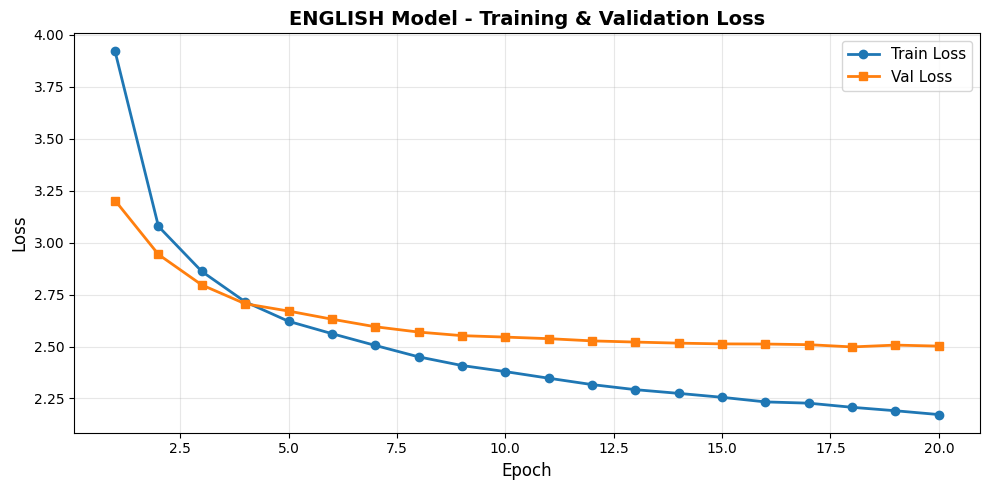

In [22]:
# %% [markdown]
# ### Plot ENGLISH Training Loss

# %%
plt.figure(figsize=(10, 5))
plt.plot(range(1, EPOCHS+1), en_train_losses, marker='o', label='Train Loss', linewidth=2)
plt.plot(range(1, EPOCHS+1), en_val_losses, marker='s', label='Val Loss', linewidth=2)
plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)

plt.title('ENGLISH Model - Training & Validation Loss', fontsize=14, fontweight='bold')
plt.legend(fontsize=11)
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

##  PHẦN C: EVALUATION

In [23]:
# %% [markdown]
# ## Evaluation Functions

# %%
def generate_caption_for_eval(image_path, encoder, decoder, vocab, transform, device, max_len=20):
    """Generate caption for evaluation"""
    image = Image.open(image_path).convert("RGB")
    image = transform(image).unsqueeze(0).to(device)
    
    encoder.eval()
    decoder.eval()
    
    with torch.no_grad():
        feature = encoder(image)
        states = None
        sampled_ids = []
        inputs = feature.unsqueeze(1)
        
        for _ in range(max_len):
            hiddens, states = decoder.lstm(inputs, states)
            outputs = decoder.linear(hiddens.squeeze(1))
            _, predicted = outputs.max(1)
            
            word_id = predicted.item()
            sampled_ids.append(word_id)
            
            if word_id == vocab.stoi["<EOS>"]:
                break
                
            inputs = decoder.embed(predicted).unsqueeze(1)
    
    sampled_words = [vocab.itos.get(i, "<UNK>") for i in sampled_ids 
                     if i not in [vocab.stoi["<EOS>"]]]
    return sampled_words

print("✅ Caption generation function defined")

✅ Caption generation function defined


In [24]:
# %% [markdown]
# ### Calculate BLEU, METEOR, ROUGE (FIXED)

# %%
def evaluate_model(encoder, decoder, test_images, captions_dict, vocab, transform, device, model_name):
    """Evaluate model with BLEU, METEOR, ROUGE"""
    print(f"\n{'='*60}")
    print(f"📊 Evaluating {model_name}")
    print(f"{'='*60}")
    
    references_list = []
    hypotheses_list = []
    
    smooth = SmoothingFunction().method1
    
    print("🔍 Generating captions...")
    for img_name in tqdm(test_images):
        img_path = IMG_DIR / img_name
        
        # Generate prediction
        predicted_words = generate_caption_for_eval(img_path, encoder, decoder, vocab, transform, device)
        
        # Get ground truths
        true_captions = captions_dict[img_name]
        reference_tokens = [vocab.tokenizer(cap) for cap in true_captions]
        
        references_list.append(reference_tokens)
        hypotheses_list.append(predicted_words)
    
    # Calculate BLEU
    print("📈 Calculating BLEU scores...")
    bleu1 = corpus_bleu(references_list, hypotheses_list, weights=(1, 0, 0, 0), smoothing_function=smooth)
    bleu2 = corpus_bleu(references_list, hypotheses_list, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)
    bleu3 = corpus_bleu(references_list, hypotheses_list, weights=(0.33, 0.33, 0.33, 0), smoothing_function=smooth)
    bleu4 = corpus_bleu(references_list, hypotheses_list, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)
    
    # Calculate METEOR - FIX HERE
    print("📈 Calculating METEOR score...")
    meteor_scores = []
    for refs, hyp in zip(references_list, hypotheses_list):
        # METEOR expects tokenized lists, NOT strings
        # refs is already list of token lists: [[token1, token2], [token3, token4], ...]
        # hyp is already token list: [token1, token2, ...]
        
        # Calculate METEOR for each reference and take max
        try:
            scores = [meteor_score([ref], hyp) for ref in refs]
            meteor_scores.append(max(scores))
        except Exception as e:
            # Skip if error (empty caption, etc.)
            continue
    
    meteor = np.mean(meteor_scores) if meteor_scores else 0.0
    
    # Calculate ROUGE
    print("📈 Calculating ROUGE-L score...")
    scorer = rouge_scorer.RougeScorer(['rougeL'], use_stemmer=True)
    rouge_scores = []
    for refs, hyp in zip(references_list, hypotheses_list):
        # ROUGE needs strings
        hyp_str = ' '.join(hyp)
        scores = []
        for ref in refs:
            ref_str = ' '.join(ref)
            score = scorer.score(ref_str, hyp_str)
            scores.append(score['rougeL'].fmeasure)
        rouge_scores.append(max(scores))
    rouge = np.mean(rouge_scores)
    
    results = {
        'BLEU-1': bleu1,
        'BLEU-2': bleu2,
        'BLEU-3': bleu3,
        'BLEU-4': bleu4,
        'METEOR': meteor,
        'ROUGE-L': rouge
    }
    
    print(f"\n✅ {model_name} Results:")
    for metric, score in results.items():
        print(f"   {metric}: {score:.4f}")
    
    return results, references_list, hypotheses_list

print("✅ Evaluation function defined (FIXED)")

✅ Evaluation function defined (FIXED)


In [25]:
# %% [markdown]
# ### Evaluate ENGLISH Model

# %%
en_results, en_refs, en_hyps = evaluate_model(
    encoder_en, decoder_en, test_imgs, en_test_caps, 
    vocab_en, transform, device, "ENGLISH Model"
)


📊 Evaluating ENGLISH Model
🔍 Generating captions...


100%|██████████| 810/810 [00:18<00:00, 43.53it/s]


📈 Calculating BLEU scores...
📈 Calculating METEOR score...
📈 Calculating ROUGE-L score...

✅ ENGLISH Model Results:
   BLEU-1: 0.5477
   BLEU-2: 0.3517
   BLEU-3: 0.2338
   BLEU-4: 0.1512
   METEOR: 0.3995
   ROUGE-L: 0.4113



📊 FINAL COMPARISON: ENGLISH


,Metric,ENGLISH
0,BLEU-1,0.547748
1,BLEU-2,0.351714
2,BLEU-3,0.233812
3,BLEU-4,0.151151
4,METEOR,0.399537
5,ROUGE-L,0.411268


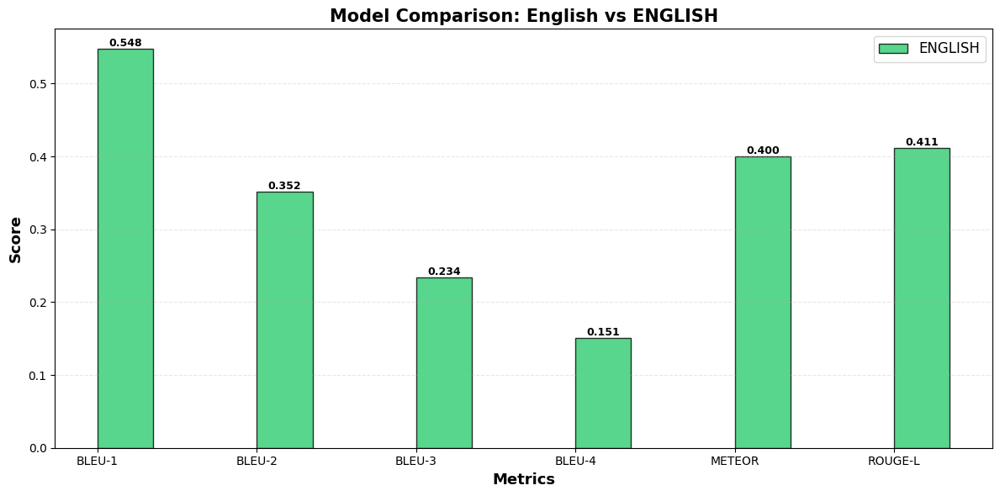

In [26]:
# %% [markdown]
# ### Comparison Table

# %%
comparison_df = pd.DataFrame({
    'Metric': ['BLEU-1', 'BLEU-2', 'BLEU-3', 'BLEU-4', 'METEOR', 'ROUGE-L'],
    'ENGLISH': [en_results['BLEU-1'], en_results['BLEU-2'], en_results['BLEU-3'], 
                       en_results['BLEU-4'], en_results['METEOR'], en_results['ROUGE-L']]
})

print("\n" + "="*70)
print("📊 FINAL COMPARISON: ENGLISH")
print("="*70)
display(comparison_df)

# Plot comparison
fig, ax = plt.subplots(figsize=(12, 6))
x = np.arange(len(comparison_df['Metric']))
width = 0.35

bars2 = ax.bar(x + width/2, comparison_df['ENGLISH'], width, label='ENGLISH', 
               color='#2ecc71', alpha=0.8, edgecolor='black')

# Add value labels
for bars in [bars2]:
    for bar in bars:
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width()/2., height,
                f'{height:.3f}', ha='center', va='bottom', fontsize=9, fontweight='bold')

ax.set_xlabel('Metrics', fontsize=13, fontweight='bold')
ax.set_ylabel('Score', fontsize=13, fontweight='bold')
ax.set_title('Model Comparison: English vs ENGLISH', fontsize=15, fontweight='bold')
ax.set_xticks(x)
ax.set_xticklabels(comparison_df['Metric'])
ax.legend(fontsize=12)
ax.grid(axis='y', alpha=0.3, linestyle='--')
plt.tight_layout()
plt.show()

🖼️  CAPTION EXAMPLES: ENGLISH vs ENGLISH



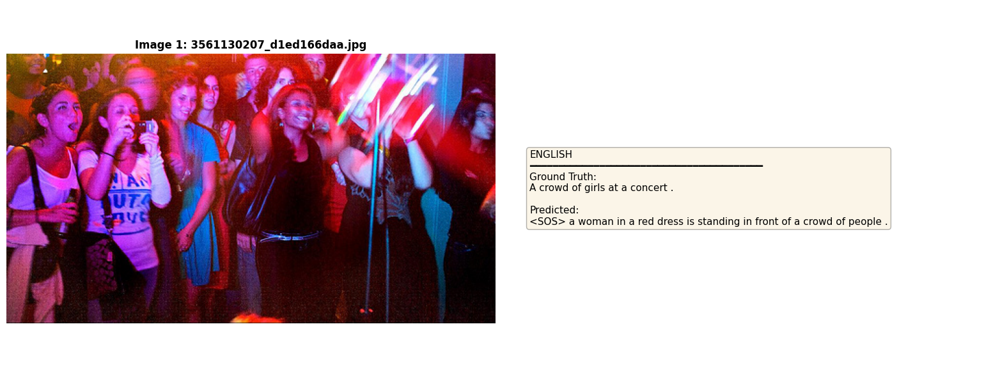

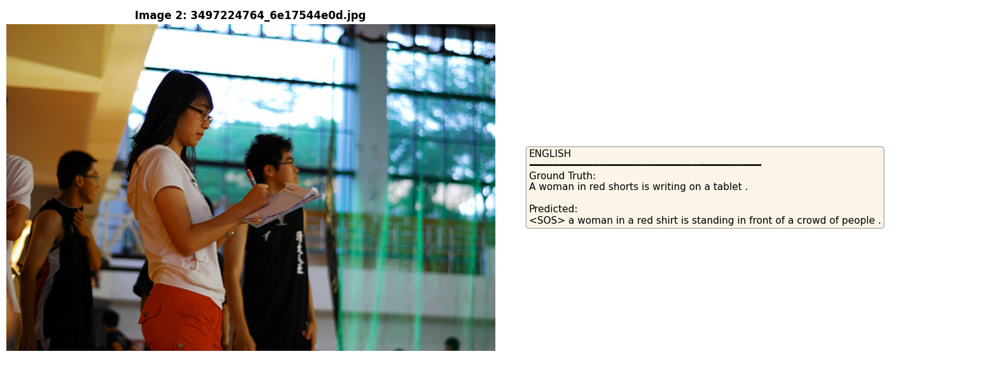

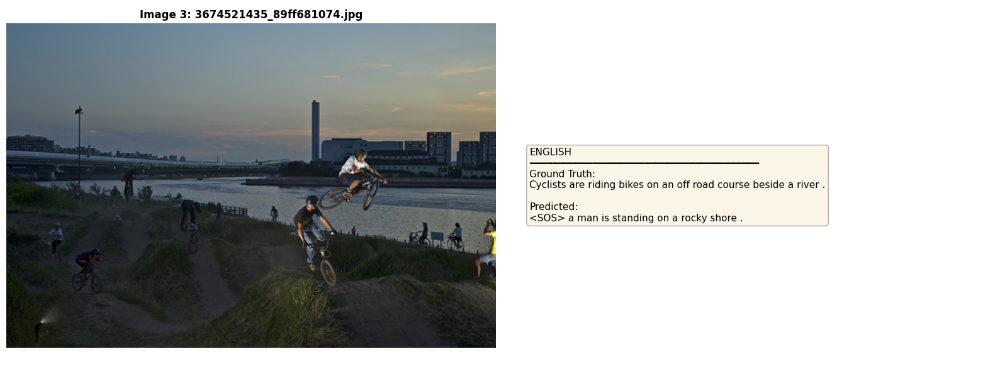

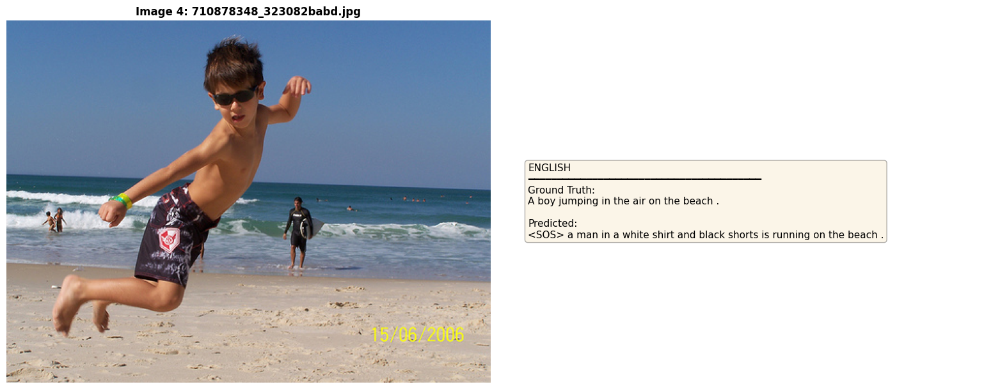

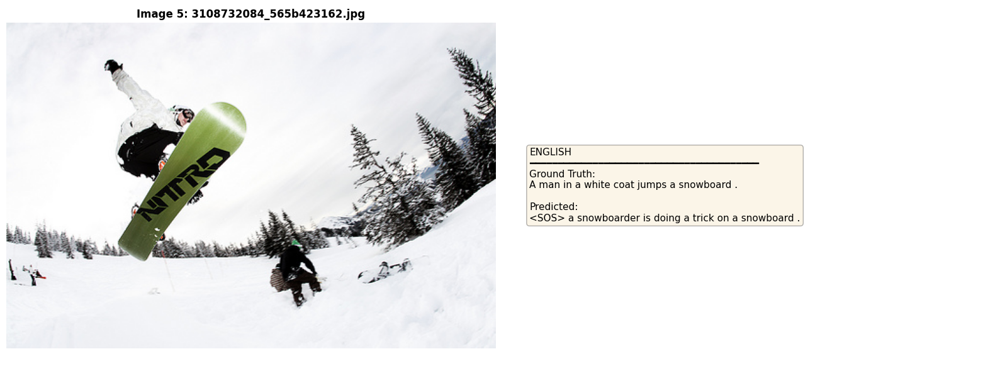

In [27]:
# %% [markdown]
# ### Visual Examples - Side by Side (Unicode Safe)

# %%
import random
import matplotlib.font_manager as fm

# ========================
#  Font setup (fix Unicode)
# ========================
# try:
#     # Ưu tiên các font có hỗ trợ tiếng Việt
#     for f in ['Arial Unicode MS', 'Tahoma', 'Noto Sans', 'DejaVu Sans']:
#         if f in fm.findSystemFonts(fontpaths=None, fontext='ttf') or f in plt.rcParams['font.sans-serif']:
#             plt.rcParams['font.family'] = f
#             break
#     plt.rcParams['axes.unicode_minus'] = False
#     print(f"✅ Using font: {plt.rcParams['font.family']}")
# except Exception:
#     print("⚠️ Không thể đặt font Unicode. Sẽ in caption ra console thay thế.")

# ========================
#  Sample 5 random images
# ========================
sample_test_imgs = random.sample(test_imgs, min(5, len(test_imgs)))
print("🖼️  CAPTION EXAMPLES: ENGLISH vs ENGLISH\n")

for idx, img_name in enumerate(sample_test_imgs, 1):
    img_path = IMG_DIR / img_name
    # Sinh caption VI
    en_pred_words = generate_caption_for_eval(img_path, encoder_en, decoder_en, vocab_en, transform, device)
    en_pred_caption = ' '.join(en_pred_words)
    en_true_caption = en_test_caps[img_name][0]

    # Nội dung hiển thị song ngữ
    caption_text = (
        f"ENGLISH\n"
        f"{'━'*40}\n"
        f"Ground Truth:\n{en_true_caption}\n\n"
        f"Predicted:\n{en_pred_caption}"
    )

    try:
        # Tạo figure hiển thị ảnh + caption
        fig, axes = plt.subplots(1, 2, figsize=(16, 6))

        # Bên trái: ảnh
        img = Image.open(img_path).convert("RGB")
        axes[0].imshow(img)
        axes[0].axis('off')
        axes[0].set_title(f"Image {idx}: {img_name}", fontsize=12, fontweight='bold')

        # Bên phải: caption
        axes[1].axis('off')
        axes[1].text(
            0.05, 0.5, caption_text, fontsize=11,
            verticalalignment='center', wrap=True,
            fontname=plt.rcParams['font.family'],
            bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.3)
        )

        plt.tight_layout()
        plt.show()

    except Exception as e:
        # Nếu lỗi font hoặc hiển thị ảnh, fallback sang print ra console
        print(f"\n🖼️ Image {idx}: {img_name}")
        print("=" * 60)
        print(caption_text)
        print(f"(⚠️ Display fallback due to font or rendering error: {e})\n")

    print("=" * 100 + "\n")


In [28]:
import os
import torch

# Thư mục lưu model trên Kaggle
MODEL_DIR = "/kaggle/working/models"
os.makedirs(MODEL_DIR, exist_ok=True)

# Lưu model tiếng Anh
save_path_en = os.path.join(MODEL_DIR, "ENGLISH_model.pth")

torch.save({
    'encoder_state_dict': encoder_en.state_dict(),
    'decoder_state_dict': decoder_en.state_dict(),
    'optimizer_state_dict': optimizer_en.state_dict(),
    'vocab': vocab_en,
    'train_losses': en_train_losses,
    'val_losses': en_val_losses,
    'results': en_results,
    'config': {
        'embed_size': embed_size,
        'hidden_size': hidden_size,
        'vocab_size': vocab_size_en
    }
}, save_path_en)

print("✅ Models saved:")
print(f"   - {save_path_en}")


✅ Models saved:
   - /kaggle/working/models/ENGLISH_model.pth


In [29]:
# %% [markdown]
# ### Final Summary

# %%
print("\n" + "="*70)
print(" " * 15 + "📊 FINAL SUMMARY - 2 MODELS")
print("="*70)

print("\nENGLISH MODEL:")
print(f"   - Vocab Size: {len(vocab_en)}")
print(f"   - Train Loss: {en_train_losses[-1]:.4f}")
print(f"   - Val Loss:   {en_val_losses[-1]:.4f}")
print(f"   - BLEU-4:     {en_results['BLEU-4']:.4f}")
print(f"   - METEOR:     {en_results['METEOR']:.4f}")
print(f"   - ROUGE-L:    {en_results['ROUGE-L']:.4f}")

print("\n💾 Saved Files:")
print("   - models/english_model.pth")
print("   - models/ENGLISH_model.pth")

print("\n" + "="*70)
print("✅ ALL TASKS COMPLETED!")
print("="*70)


               📊 FINAL SUMMARY - 2 MODELS

ENGLISH MODEL:
   - Vocab Size: 2802
   - Train Loss: 2.1727
   - Val Loss:   2.5020
   - BLEU-4:     0.1512
   - METEOR:     0.3995
   - ROUGE-L:    0.4113

💾 Saved Files:
   - models/english_model.pth
   - models/ENGLISH_model.pth

✅ ALL TASKS COMPLETED!


## PHẦN E: APP DỤNG TRANSFORMER

In [30]:
# %% [markdown]
# ## PHẦN E: ỨNG DỤNG MÔ HÌNH TRANSFORMER
# ### Vision Transformer (ViT) + GPT2 Decoder

# %%
# %% [markdown]
# ## Setup & Imports

# %%
import os
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from transformers import (
    ViTModel, ViTConfig,
    GPT2LMHeadModel, GPT2Tokenizer, GPT2Config,
    get_linear_schedule_with_warmup
)
from torch.optim import AdamW  # ✅ dùng AdamW của PyTorch

from PIL import Image
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt
import pandas as pd
from nltk.translate.bleu_score import corpus_bleu, SmoothingFunction
from rouge_score import rouge_scorer
import time

print("✅ Imports completed for Transformer models")

✅ Imports completed for Transformer models


In [ ]:

# %%
# %% [markdown]
# ## 1. TRANSFORMER MODEL ARCHITECTURE

# %%
class VisionEncoderDecoderModel(nn.Module):
    """
    Vision Transformer Encoder + GPT2 Decoder for Image Captioning
    
    Kiến trúc:
    - Encoder: ViT (google/vit-base-patch16-224) — trích đặc trưng ảnh
    - Decoder: GPT2 — sinh câu miêu tả
    - Cross-Attention: cơ chế kết nối giữa hai miền ảnh ↔ ngôn ngữ
    """
    def __init__(self, vit_model_name='google/vit-base-patch16-224', 
                 gpt2_model_name='gpt2', max_length=50):
        super().__init__()
        
        # -------------------------------------------------------------
        # 1. Vision Encoder (ViT)
        # -------------------------------------------------------------
        # - ViT (Vision Transformer) nhận ảnh đầu vào kích thước [3, 224, 224].
        # - Ảnh được chia thành các patch (16x16), mỗi patch được mã hóa thành vector 768 chiều.
        # - Kết quả: tensor [batch_size, num_patches, 768], trong đó num_patches = 14×14 = 196.
        self.vit = ViTModel.from_pretrained(vit_model_name)
        self.vit_hidden_size = self.vit.config.hidden_size  # 768 chiều đặc trưng ảnh
        
        # -------------------------------------------------------------
        # 2. Language Decoder (GPT2)
        # -------------------------------------------------------------
        # - GPT2 là mô hình sinh ngôn ngữ dựa trên kiến trúc Transformer Decoder.
        # - Nhận chuỗi token (embedding 768 chiều) và dự đoán token kế tiếp.
        self.gpt2 = GPT2LMHeadModel.from_pretrained(gpt2_model_name)
        self.gpt2_hidden_size = self.gpt2.config.n_embd  # 768 chiều đặc trưng từ
        
        # -------------------------------------------------------------
        # 3. Projection Layer
        # -------------------------------------------------------------
        # - Đảm bảo đặc trưng ảnh (ViT) và đặc trưng từ (GPT2) có cùng kích thước.
        # - Chiếu đặc trưng từ encoder sang không gian của decoder.
        self.vision_projection = nn.Linear(self.vit_hidden_size, self.gpt2_hidden_size)
        
        # -------------------------------------------------------------
        # 4. Cross-Attention Layer
        # -------------------------------------------------------------
        # - Kết nối giữa encoder (ảnh) và decoder (ngôn ngữ).
        # - Multi-Head Attention cho phép mỗi token trong caption
        #   chú ý đến các vùng khác nhau trong đặc trưng ảnh.
        #   query = token embeddings (từ GPT2)
        #   key, value = vision features (từ ViT)
        self.cross_attention = nn.MultiheadAttention(
            embed_dim=self.gpt2_hidden_size,
            num_heads=12,
            dropout=0.1,
            batch_first=True  # cho phép định dạng [batch, seq_len, hidden_dim]
        )
        
        # -------------------------------------------------------------
        # 5. Layer Normalization
        # -------------------------------------------------------------
        # - Sau khi cộng residual (token + attended_features),
        #   thực hiện chuẩn hóa để ổn định gradient và cải thiện hội tụ.
        self.layer_norm = nn.LayerNorm(self.gpt2_hidden_size)
        
        self.max_length = max_length
        
        print(f"Model initialized:")
        print(f"   - Vision Encoder: {vit_model_name}")
        print(f"   - Language Decoder: {gpt2_model_name}")
        print(f"   - Hidden Size: {self.gpt2_hidden_size}")
    
    # -------------------------------------------------------------
    # 6. Forward pass — huấn luyện
    # -------------------------------------------------------------
    def forward(self, pixel_values, input_ids, attention_mask=None):
        """
        Truyền xuôi qua mô hình (dùng trong huấn luyện)
        
        Args:
            pixel_values: tensor ảnh [batch, 3, 224, 224]
            input_ids: token ID của caption [batch, seq_len]
            attention_mask: mask cho các vị trí padding [batch, seq_len]
        
        Returns:
            logits: Dự đoán xác suất token kế tiếp [batch, seq_len, vocab_size]
        """
        # (1) Mã hóa ảnh bằng ViT
        vision_outputs = self.vit(pixel_values=pixel_values)
        vision_features = vision_outputs.last_hidden_state  # [batch, num_patches, 768]
        
        # (2) Chiếu đặc trưng ảnh sang không gian GPT2
        vision_features = self.vision_projection(vision_features)  # [batch, num_patches, 768]
        
        # (3) Biểu diễn từ (token embedding)
        #    GPT2 có bảng embedding riêng (wte) dùng để ánh xạ token ID → vector 768 chiều.
        token_embeddings = self.gpt2.transformer.wte(input_ids)  # [batch, seq_len, 768]
        
        # (4) Cross-attention: token chú ý vào vùng ảnh tương ứng
        attended_features, _ = self.cross_attention(
            query=token_embeddings,  # token đang được sinh
            key=vision_features,     # đặc trưng ảnh
            value=vision_features    # giá trị từ encoder
        )
        
        # (5) Kết hợp residual + chuẩn hóa
        combined_features = self.layer_norm(token_embeddings + attended_features)
        
        # (6) Đưa vào GPT2 decoder để dự đoán token kế tiếp
        outputs = self.gpt2(
            inputs_embeds=combined_features,
            attention_mask=attention_mask,
            return_dict=True
        )
        
        # Trả về logits: [batch, seq_len, vocab_size]
        return outputs.logits
    
    # -------------------------------------------------------------
    # 7. Caption Generation — suy luận (inference)
    # -------------------------------------------------------------
    def generate_caption(self, pixel_values, tokenizer, max_length=50, device='cuda'):
        """
        Sinh caption cho ảnh (dùng khi đánh giá hoặc demo)
        Chiến lược sinh: Greedy Decoding
        
        Args:
            pixel_values: tensor ảnh [1, 3, 224, 224]
            tokenizer: GPT2 tokenizer (chuyển token ↔ chữ)
            max_length: độ dài tối đa caption
            device: thiết bị (cuda hoặc cpu)
        
        Returns:
            generated_caption: chuỗi caption hoàn chỉnh
        """
        self.eval()  # chế độ inference, tắt dropout
        
        # (1) Khởi đầu với token <BOS> (begin of sentence)
        input_ids = torch.tensor([[tokenizer.bos_token_id]]).to(device)
        
        with torch.no_grad():
            # (2) Mã hóa ảnh một lần
            vision_outputs = self.vit(pixel_values=pixel_values)
            vision_features = vision_outputs.last_hidden_state
            vision_features = self.vision_projection(vision_features)
            
            # (3) Vòng lặp sinh token từng bước
            for _ in range(max_length):
                # Lấy embedding hiện tại của chuỗi
                token_embeddings = self.gpt2.transformer.wte(input_ids)
                
                # Cross-attention giữa token và ảnh
                attended_features, _ = self.cross_attention(
                    query=token_embeddings,
                    key=vision_features,
                    value=vision_features
                )
                
                # Kết hợp residual + chuẩn hóa
                combined_features = self.layer_norm(token_embeddings + attended_features)
                
                # Dự đoán token kế tiếp
                outputs = self.gpt2(inputs_embeds=combined_features, return_dict=True)
                logits = outputs.logits[:, -1, :]  # lấy logits của token cuối
                next_token_id = torch.argmax(logits, dim=-1, keepdim=True)  # chọn token có xác suất cao nhất
                
                # Dừng nếu gặp <EOS> (end of sentence)
                if next_token_id.item() == tokenizer.eos_token_id:
                    break
                
                # Ghép token mới vào chuỗi hiện tại
                input_ids = torch.cat([input_ids, next_token_id], dim=1)
        
        # (4) Giải mã token thành văn bản hoàn chỉnh
        generated_caption = tokenizer.decode(input_ids[0], skip_special_tokens=True)
        return generated_caption

print("✅ VisionEncoderDecoderModel class defined")


✅ VisionEncoderDecoderModel class defined


In [ ]:

# %%
# %% [markdown]
# ## 2. DATASET CLASS FOR TRANSFORMER

# %%
from torchvision import transforms

class TransformerImageCaptionDataset(Dataset):
    """
    Dataset dùng cho mô hình Transformer (ViT + GPT2) trong bài toán Image Captioning.
    Bao gồm:
        - Tiền xử lý ảnh phù hợp với ViT
        - Tokenization caption bằng GPT2 tokenizer
    """
    def __init__(self, img_folder, captions_dict, tokenizer, max_length=50):
        """
        Args:
            img_folder: thư mục chứa ảnh (dạng Path object)
            captions_dict: dictionary {ảnh: [danh sách caption]}
            tokenizer: GPT2 tokenizer để mã hóa caption
            max_length: độ dài tối đa của caption (token)
        """
        self.img_folder = img_folder
        self.captions_dict = captions_dict
        self.tokenizer = tokenizer
        self.max_length = max_length
        
        # -------------------------------------------------------------
        # 1. Tiền xử lý ảnh cho ViT
        # -------------------------------------------------------------
        # - Resize ảnh về kích thước 224x224 (chuẩn cho ViT)
        # - Chuyển ảnh thành tensor
        # - Chuẩn hóa giá trị pixel về khoảng [-1, 1] theo mean/std ViT yêu cầu
        self.transform = transforms.Compose([
            transforms.Resize((224, 224)),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
        ])
        
        # -------------------------------------------------------------
        # 2. Tạo danh sách các cặp (ảnh, caption)
        # -------------------------------------------------------------
        # captions_dict có dạng:
        #   {"image1.jpg": ["A dog running", "A brown dog in the park"], ...}
        # Ta mở rộng thành list [(image1.jpg, "A dog running"), (image1.jpg, "A brown dog..."), ...]
        self.pairs = []
        for img_name, captions in captions_dict.items():
            for caption in captions:
                self.pairs.append((img_name, caption))
    
    def __len__(self):
        """
        Trả về số lượng mẫu trong dataset.
        Mỗi mẫu tương ứng với 1 cặp (ảnh, caption).
        """
        return len(self.pairs)
    
    def __getitem__(self, idx):
        """
        Lấy ra một mẫu dữ liệu tại vị trí idx.

        Trả về:
            pixel_values: tensor ảnh sau khi xử lý (dùng cho ViT encoder)
            input_ids: token ID của caption (dùng cho GPT2 decoder)
            attention_mask: mask cho biết vị trí nào cần tính loss (1 = giữ, 0 = padding)
        """
        # -------------------------------------------------------------
        # (1) Đọc ảnh và tiền xử lý
        # -------------------------------------------------------------
        img_name, caption = self.pairs[idx]
        img_path = self.img_folder / img_name
        image = Image.open(img_path).convert("RGB")
        pixel_values = self.transform(image)  # tensor [3, 224, 224]
        
        # -------------------------------------------------------------
        # (2) Xử lý caption (embedding đầu vào cho decoder)
        # -------------------------------------------------------------
        # - Thêm token đặc biệt:
        #     <BOS> ở đầu để đánh dấu bắt đầu câu
        #     <EOS> ở cuối để đánh dấu kết thúc câu
        # - Sau đó mã hóa caption thành token ID bằng GPT2 tokenizer.
        caption_text = f"{self.tokenizer.bos_token}{caption}{self.tokenizer.eos_token}"
        encoding = self.tokenizer(
            caption_text,
            max_length=self.max_length,     # cắt/padding cho đồng chiều
            padding='max_length',
            truncation=True,
            return_tensors='pt'              # trả về tensor PyTorch
        )
        
        # input_ids: dãy ID của caption (ví dụ: [50256, 257, 2214, 318, 50256])
        # attention_mask: dãy 1/0, 1 = token hợp lệ, 0 = padding
        input_ids = encoding['input_ids'].squeeze()
        attention_mask = encoding['attention_mask'].squeeze()
        
        return pixel_values, input_ids, attention_mask


# =====================================================================
# HÀM COLLATE TÙY CHỈNH (dành cho DataLoader)
# =====================================================================
# Mục tiêu:
#   - Gộp nhiều mẫu từ Dataset thành một batch duy nhất.
#   - Đảm bảo tất cả các tensor (ảnh, caption, mask) có cùng kích thước.
# =====================================================================
def collate_fn_transformer(batch):
    """
    Hàm collate tùy chỉnh cho DataLoader của Transformer.
    
    Args:
        batch: danh sách các phần tử (pixel_values, input_ids, attention_mask)
    
    Returns:
        pixel_values: tensor ảnh [batch_size, 3, 224, 224]
        input_ids: token ID [batch_size, max_len]
        attention_masks: mask [batch_size, max_len]
    """
    pixel_values, input_ids, attention_masks = zip(*batch)
    
    pixel_values = torch.stack(pixel_values)       # gộp ảnh lại thành [B, 3, 224, 224]
    input_ids = torch.stack(input_ids)             # gộp token lại thành [B, L]
    attention_masks = torch.stack(attention_masks) # gộp mask lại thành [B, L]
    
    return pixel_values, input_ids, attention_masks

print("✅ TransformerImageCaptionDataset class defined")

✅ TransformerImageCaptionDataset class defined


In [33]:

def train_transformer_model(model, train_loader, val_loader, tokenizer, 
                            num_epochs=10, learning_rate=5e-5, device='cuda'):
    """
    Training loop for VisionEncoderDecoderModel (ViT + GPT2)
    --------------------------------------------------------
    - Optimizer: AdamW
    - Scheduler: Linear warmup/decay
    - Loss: CrossEntropyLoss (auto from model)
    - Gradient clipping
    - Save best model
    """
    model.to(device)

    # Optimizer: different LR for encoder & decoder
    optimizer = AdamW([
        {'params': model.vit.parameters(), 'lr': 5e-6, 'weight_decay': 0.01},   # Vision encoder
        {'params': model.gpt2.parameters(), 'lr': 1e-5, 'weight_decay': 0.01},  # GPT2 decoder
        # {'params': model.vision_projection.parameters(), 'lr': 5e-5, 'weight_decay': 0.01},
        # {'params': model.cross_attention.parameters(), 'lr': 5e-5, 'weight_decay': 0.01},
        # {'params': model.layer_norm.parameters(), 'lr': 5e-5, 'weight_decay': 0.01},
    ])

    # Scheduler
    num_training_steps = len(train_loader) * num_epochs
    num_warmup_steps = num_training_steps // 10
    scheduler = get_linear_schedule_with_warmup(
        optimizer, num_warmup_steps=num_warmup_steps, num_training_steps=num_training_steps
    )

    train_losses, val_losses = [], []
    best_val_loss = float("inf")

    print(f"\n🚀 Starting Training...")
    print(f"   - Total steps: {num_training_steps}")
    print(f"   - Warmup steps: {num_warmup_steps}")
    print(f"   - Base LR: {learning_rate}")

    for epoch in range(num_epochs):
        # ============ TRAINING ============
        model.train()
        total_train_loss = 0.0

        for batch in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} [Train]"):
            pixel_values, input_ids, attention_mask = [b.to(device) for b in batch]


            # Forward pass
            logits = model(
                pixel_values=pixel_values,
                input_ids=input_ids[:, :-1],
                attention_mask=attention_mask[:, :-1]
            )
            
            # Calculate loss (shift by 1 for language modeling)
            criterion = nn.CrossEntropyLoss(ignore_index=tokenizer.pad_token_id)
            loss = criterion(
                logits.reshape(-1, logits.size(-1)),
                input_ids[:, 1:].reshape(-1)
            )

            optimizer.zero_grad()
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()
            scheduler.step()

            total_train_loss += loss.item()

        avg_train_loss = total_train_loss / len(train_loader)

        # ============ VALIDATION ============
        model.eval()
        total_val_loss = 0.0
        criterion = nn.CrossEntropyLoss(ignore_index=tokenizer.pad_token_id)
        with torch.no_grad():
            for batch in tqdm(val_loader, desc=f"Epoch {epoch+1}/{num_epochs} [Val]"):
                pixel_values, input_ids, attention_mask = [b.to(device) for b in batch]
        
                logits = model(
                    pixel_values=pixel_values,
                    input_ids=input_ids[:, :-1],
                    attention_mask=attention_mask[:, :-1]
                )
        
                val_loss = criterion(
                    logits.reshape(-1, logits.size(-1)),
                    input_ids[:, 1:].reshape(-1)
                )
        
                total_val_loss += val_loss.item()

        avg_val_loss = total_val_loss / len(val_loader)
        train_losses.append(avg_train_loss)
        val_losses.append(avg_val_loss)

        # Save best model
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            torch.save({
                'epoch': epoch + 1,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'train_loss': avg_train_loss,
                'val_loss': avg_val_loss,
            }, "best_transformer_model.pth")
            print(f"   ✅ Best model saved (val_loss: {avg_val_loss:.4f})")

        print(f"\nEpoch {epoch+1}/{num_epochs}:")
        print(f"   Train Loss: {avg_train_loss:.4f}")
        print(f"   Val Loss:   {avg_val_loss:.4f}")
        print(f"   Best Val:   {best_val_loss:.4f}")

    return train_losses, val_losses


print("✅ Training function defined")


✅ Training function defined


In [34]:
# %%
# %% [markdown]
# ## 4. EVALUATION FUNCTION FOR TRANSFORMER

# %%
def evaluate_transformer_model(model, test_imgs, test_captions, tokenizer, 
                               transform, device='cuda', model_name="Transformer"):
    """
    Evaluate transformer model on test set
    Calculate BLEU, METEOR, ROUGE scores
    """
    model.eval()
    model.to(device)
    
    references_list = []  # Ground truth captions
    hypotheses_list = []  # Generated captions
    
    print(f"\n📊 Evaluating {model_name}...")
    
    for img_name in tqdm(test_imgs, desc="Generating captions"):
        # Load image
        img_path = IMG_DIR / img_name
        image = Image.open(img_path).convert("RGB")
        
        # Preprocess
        pixel_values = transform(image).unsqueeze(0).to(device)
        
        # Generate caption
        generated_caption = model.generate_caption(pixel_values, tokenizer, device=device)
        
        # Tokenize for evaluation
        generated_tokens = tokenizer.tokenize(generated_caption.lower())
        
        # Get ground truth captions
        true_captions = test_captions[img_name]
        true_tokens_list = [tokenizer.tokenize(cap.lower()) for cap in true_captions]
        
        hypotheses_list.append(generated_tokens)
        references_list.append(true_tokens_list)
    
    # Calculate BLEU scores
    print("📈 Calculating BLEU scores...")
    smoothing = SmoothingFunction().method1
    bleu1 = corpus_bleu(references_list, hypotheses_list, weights=(1, 0, 0, 0), smoothing_function=smoothing)
    bleu2 = corpus_bleu(references_list, hypotheses_list, weights=(0.5, 0.5, 0, 0), smoothing_function=smoothing)
    bleu3 = corpus_bleu(references_list, hypotheses_list, weights=(0.33, 0.33, 0.33, 0), smoothing_function=smoothing)
    bleu4 = corpus_bleu(references_list, hypotheses_list, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smoothing)
    
    # Calculate ROUGE
    print("📈 Calculating ROUGE-L score...")
    scorer = rouge_scorer.RougeScorer(['rougeL'], use_stemmer=True)
    rouge_scores = []
    for refs, hyp in zip(references_list, hypotheses_list):
        hyp_str = ' '.join(hyp)
        scores = []
        for ref in refs:
            ref_str = ' '.join(ref)
            score = scorer.score(ref_str, hyp_str)
            scores.append(score['rougeL'].fmeasure)
        rouge_scores.append(max(scores))
    rouge = np.mean(rouge_scores)
    
    print("📈 Calculating METEOR score...")
    meteor_scores = []
    for refs, hyp in zip(references_list, hypotheses_list):
        try:
            scores = [meteor_score([ref], hyp) for ref in refs]
            meteor_scores.append(max(scores))
        except Exception as e:
            continue

    meteor = np.mean(meteor_scores) if meteor_scores else 0.0
    
    results = {
        'BLEU-1': bleu1,
        'BLEU-2': bleu2,
        'BLEU-3': bleu3,
        'BLEU-4': bleu4,
        'METEOR': meteor,
        'ROUGE-L': rouge
    }
    
    print(f"\n✅ {model_name} Results:")
    for metric, score in results.items():
        print(f"   {metric}: {score:.4f}")
    
    return results, references_list, hypotheses_list

print("✅ Evaluation function defined")


✅ Evaluation function defined


In [35]:

# %%
print("=" * 70)
print("TRAINING ENGLISH TRANSFORMER MODEL")
print("=" * 70)

# Imports
import os
import torch
from torch.utils.data import DataLoader
from transformers import (
    ViTModel, ViTConfig,
    GPT2Tokenizer,
    get_linear_schedule_with_warmup
)

# Load GPT2 tokenizer safely
tokenizer_en = GPT2Tokenizer.from_pretrained(
    "gpt2-medium",
    trust_remote_code=False,
    revision="main"
)
tokenizer_en.pad_token = tokenizer_en.eos_token

# Initialize model (ViT + GPT2)
model_en_transformer = VisionEncoderDecoderModel(
    vit_model_name='google/vit-base-patch16-224',
    gpt2_model_name='gpt2',
    max_length=50
)

# Create datasets
train_dataset_en = TransformerImageCaptionDataset(
    IMG_DIR, en_train_caps, tokenizer_en, max_length=50
)
val_dataset_en = TransformerImageCaptionDataset(
    IMG_DIR, en_val_caps, tokenizer_en, max_length=50
)

# Dataloaders
train_loader_en_transformer = DataLoader(
    train_dataset_en,
    batch_size=32,
    shuffle=True,
    collate_fn=collate_fn_transformer,
    num_workers=4
)
val_loader_en_transformer = DataLoader(
    val_dataset_en,
    batch_size=32,
    shuffle=False,
    collate_fn=collate_fn_transformer,
    num_workers=4
)

print(f"✅ ENGLISH Datasets created:")
print(f"   Train: {len(train_dataset_en)} samples")
print(f"   Val:   {len(val_dataset_en)} samples")


TRAINING ENGLISH TRANSFORMER MODEL


tokenizer_config.json:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.04M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/718 [00:00<?, ?B/s]

/usr/local/lib/python3.11/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


config.json: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/346M [00:00<?, ?B/s]

Some weights of ViTModel were not initialized from the model checkpoint at google/vit-base-patch16-224 and are newly initialized: ['vit.pooler.dense.bias', 'vit.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


config.json:   0%|          | 0.00/665 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/548M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/124 [00:00<?, ?B/s]

✅ Model initialized:
   - Vision Encoder: google/vit-base-patch16-224
   - Language Decoder: gpt2
   - Hidden Size: 768
✅ ENGLISH Datasets created:
   Train: 34057 samples
   Val:   4273 samples



🚀 Training ENGLISH Transformer Model...

🚀 Starting Training...
   - Total steps: 21300
   - Warmup steps: 2130
   - Base LR: 5e-05


Epoch 1/20 [Val]: 100%|██████████| 134/134 [00:36<00:00,  3.63it/s]


   ✅ Best model saved (val_loss: 3.2667)

Epoch 1/20:
   Train Loss: 5.5287
   Val Loss:   3.2667
   Best Val:   3.2667


Epoch 2/20 [Val]: 100%|██████████| 134/134 [00:36<00:00,  3.63it/s]


   ✅ Best model saved (val_loss: 2.9275)

Epoch 2/20:
   Train Loss: 3.1644
   Val Loss:   2.9275
   Best Val:   2.9275


Epoch 3/20 [Val]: 100%|██████████| 134/134 [00:36<00:00,  3.63it/s]


   ✅ Best model saved (val_loss: 2.7917)

Epoch 3/20:
   Train Loss: 2.8803
   Val Loss:   2.7917
   Best Val:   2.7917


Epoch 4/20 [Val]: 100%|██████████| 134/134 [00:36<00:00,  3.63it/s]


   ✅ Best model saved (val_loss: 2.7254)

Epoch 4/20:
   Train Loss: 2.7334
   Val Loss:   2.7254
   Best Val:   2.7254


Epoch 5/20 [Val]: 100%|██████████| 134/134 [00:36<00:00,  3.62it/s]


   ✅ Best model saved (val_loss: 2.6822)

Epoch 5/20:
   Train Loss: 2.6311
   Val Loss:   2.6822
   Best Val:   2.6822


Epoch 6/20 [Val]: 100%|██████████| 134/134 [00:37<00:00,  3.62it/s]


   ✅ Best model saved (val_loss: 2.6541)

Epoch 6/20:
   Train Loss: 2.5506
   Val Loss:   2.6541
   Best Val:   2.6541


Epoch 7/20 [Val]: 100%|██████████| 134/134 [00:36<00:00,  3.62it/s]


   ✅ Best model saved (val_loss: 2.6345)

Epoch 7/20:
   Train Loss: 2.4855
   Val Loss:   2.6345
   Best Val:   2.6345


Epoch 8/20 [Val]: 100%|██████████| 134/134 [00:36<00:00,  3.63it/s]


   ✅ Best model saved (val_loss: 2.6259)

Epoch 8/20:
   Train Loss: 2.4262
   Val Loss:   2.6259
   Best Val:   2.6259


Epoch 9/20 [Val]: 100%|██████████| 134/134 [00:37<00:00,  3.62it/s]


   ✅ Best model saved (val_loss: 2.6173)

Epoch 9/20:
   Train Loss: 2.3765
   Val Loss:   2.6173
   Best Val:   2.6173


Epoch 10/20 [Val]: 100%|██████████| 134/134 [00:36<00:00,  3.63it/s]


   ✅ Best model saved (val_loss: 2.6130)

Epoch 10/20:
   Train Loss: 2.3310
   Val Loss:   2.6130
   Best Val:   2.6130


Epoch 11/20 [Val]: 100%|██████████| 134/134 [00:36<00:00,  3.63it/s]



Epoch 11/20:
   Train Loss: 2.2941
   Val Loss:   2.6137
   Best Val:   2.6130


Epoch 12/20 [Val]: 100%|██████████| 134/134 [00:36<00:00,  3.62it/s]



Epoch 12/20:
   Train Loss: 2.2570
   Val Loss:   2.6157
   Best Val:   2.6130


Epoch 13/20 [Val]: 100%|██████████| 134/134 [00:37<00:00,  3.62it/s]



Epoch 13/20:
   Train Loss: 2.2296
   Val Loss:   2.6224
   Best Val:   2.6130


Epoch 14/20 [Val]: 100%|██████████| 134/134 [00:36<00:00,  3.62it/s]



Epoch 14/20:
   Train Loss: 2.2039
   Val Loss:   2.6285
   Best Val:   2.6130


Epoch 15/20 [Val]: 100%|██████████| 134/134 [00:36<00:00,  3.62it/s]



Epoch 15/20:
   Train Loss: 2.1825
   Val Loss:   2.6305
   Best Val:   2.6130


Epoch 16/20 [Val]: 100%|██████████| 134/134 [00:36<00:00,  3.63it/s]



Epoch 16/20:
   Train Loss: 2.1645
   Val Loss:   2.6362
   Best Val:   2.6130


Epoch 17/20 [Val]: 100%|██████████| 134/134 [00:37<00:00,  3.60it/s]



Epoch 17/20:
   Train Loss: 2.1474
   Val Loss:   2.6406
   Best Val:   2.6130


Epoch 18/20 [Val]: 100%|██████████| 134/134 [00:37<00:00,  3.61it/s]



Epoch 18/20:
   Train Loss: 2.1365
   Val Loss:   2.6432
   Best Val:   2.6130


Epoch 19/20 [Val]: 100%|██████████| 134/134 [00:37<00:00,  3.61it/s]



Epoch 19/20:
   Train Loss: 2.1284
   Val Loss:   2.6437
   Best Val:   2.6130


Epoch 20/20 [Val]: 100%|██████████| 134/134 [00:37<00:00,  3.62it/s]



Epoch 20/20:
   Train Loss: 2.1194
   Val Loss:   2.6453
   Best Val:   2.6130

✅ ENGLISH Training completed in 310.24 minutes


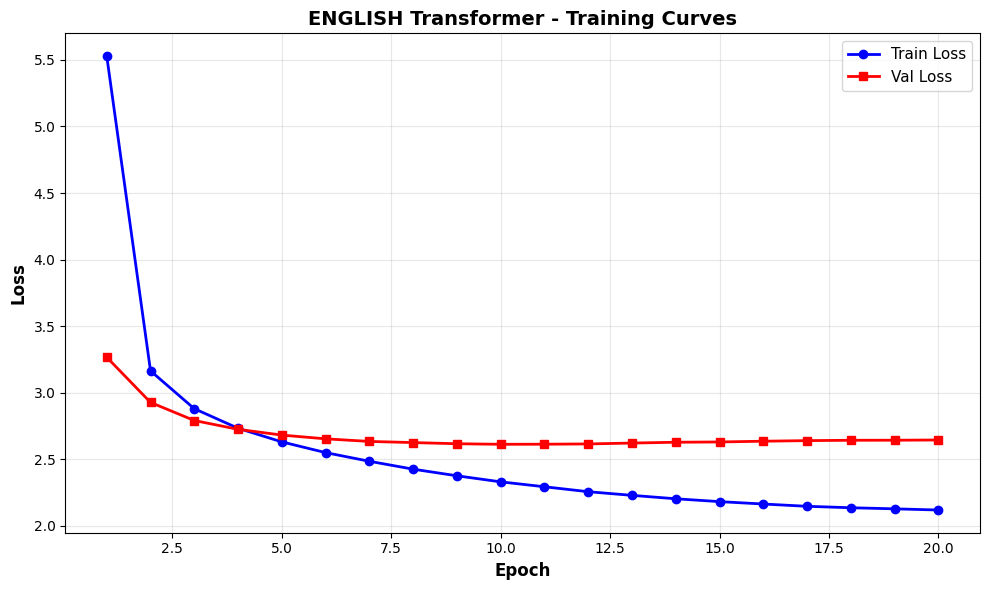

In [36]:
# %%
# Train ENGLISH model
print("\n🚀 Training ENGLISH Transformer Model...")
start_time = time.time()

en_train_losses_transformer, en_val_losses_transformer = train_transformer_model(
    model=model_en_transformer,
    train_loader=train_loader_en_transformer,
    val_loader=val_loader_en_transformer,
    tokenizer=tokenizer_en,
    num_epochs=20,
    learning_rate=5e-5,
    device=device
)


en_training_time = time.time() - start_time
print(f"\n✅ ENGLISH Training completed in {en_training_time/60:.2f} minutes")

# %%
# Plot training curves - ENGLISH
fig, ax = plt.subplots(figsize=(10, 6))
epochs = range(1, len(en_train_losses_transformer) + 1)
ax.plot(epochs, en_train_losses_transformer, 'b-o', label='Train Loss', linewidth=2)
ax.plot(epochs, en_val_losses_transformer, 'r-s', label='Val Loss', linewidth=2)
ax.set_xlabel('Epoch', fontsize=12, fontweight='bold')
ax.set_ylabel('Loss', fontsize=12, fontweight='bold')
ax.set_title('ENGLISH Transformer - Training Curves', fontsize=14, fontweight='bold')
ax.legend(fontsize=11)
ax.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

## SO SÁNH


📊 EVALUATING ENGLISH TRANSFORMER

📊 Evaluating ENGLISH Transformer...


Generating captions: 100%|██████████| 810/810 [05:36<00:00,  2.41it/s]


📈 Calculating BLEU scores...
📈 Calculating ROUGE-L score...
📈 Calculating METEOR score...

✅ ENGLISH Transformer Results:
   BLEU-1: 0.2399
   BLEU-2: 0.1579
   BLEU-3: 0.1051
   BLEU-4: 0.0668
   METEOR: 0.3229
   ROUGE-L: 0.3242

📊 COMPARISON: CNN-RNN vs TRANSFORMER (ENGLISH Only)


,Model,BLEU-1,BLEU-2,BLEU-3,BLEU-4,ROUGE-L,Training Time (min)
0,VI CNN-RNN,0.547748,0.351714,0.233812,0.151151,0.411268,N/A
1,VI Transformer,0.239867,0.157906,0.105088,0.066764,0.324231,310.2


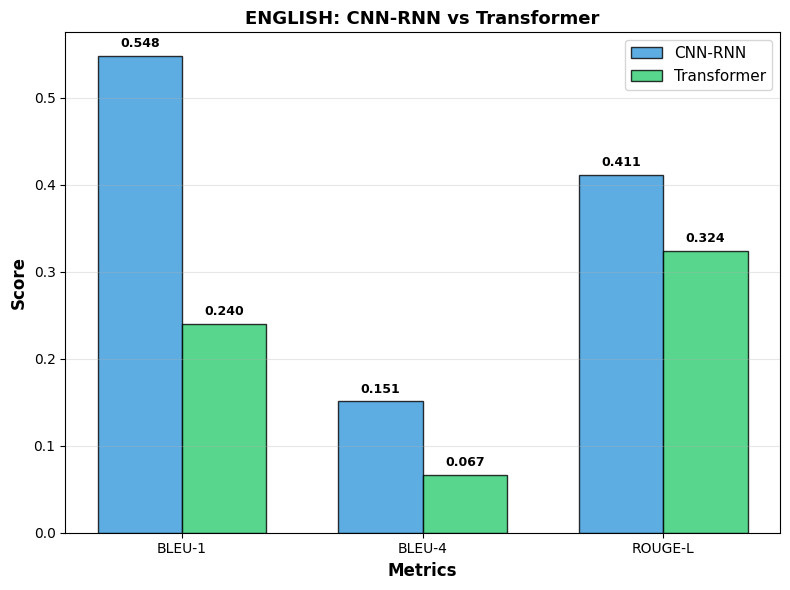


🖼️  VISUAL COMPARISON: CNN-RNN vs TRANSFORMER (ENGLISH Only)

Image 1: 3259579174_30a8a27058.jpg

📝 Ground Truth (ENGLISH):
   A smiling boy with hat playing in the snow .

🤖 CNN-RNN Prediction (ENGLISH):
   <SOS> a boy in a red jacket is standing in the snow .

🤖 Transformer Prediction (ENGLISH):
   A child in a red jacket is sliding down a snow covered hill.....................................


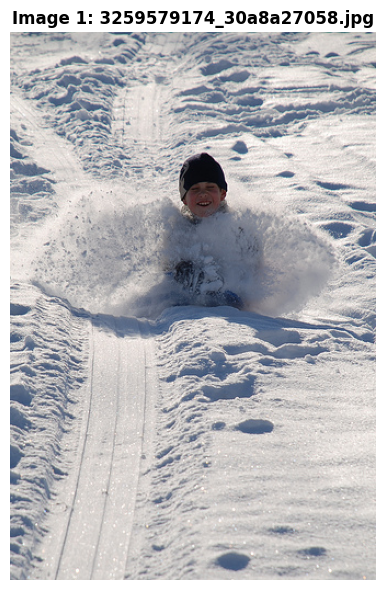


Image 2: 3576259024_9c05b163aa.jpg

📝 Ground Truth (ENGLISH):
   A man in blue jumping a dirt bike .

🤖 CNN-RNN Prediction (ENGLISH):
   <SOS> a man wearing a helmet is riding a bike .

🤖 Transformer Prediction (ENGLISH):
   A man on a motorcycle is doing a trick on a dirt track.....................................


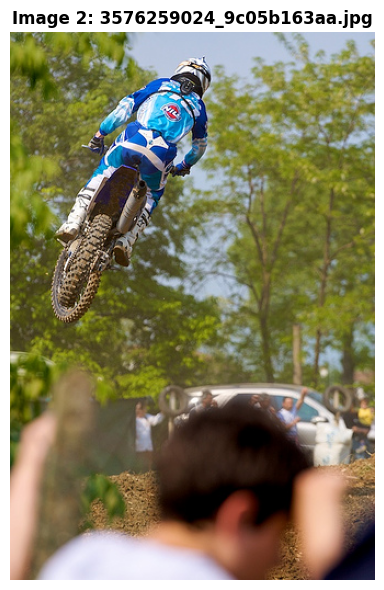


Image 3: 1022454332_6af2c1449a.jpg

📝 Ground Truth (ENGLISH):
   A child and a woman are at waters edge in a big city .

🤖 CNN-RNN Prediction (ENGLISH):
   <SOS> a woman in a bikini top is standing on a beach with a fishing pole .

🤖 Transformer Prediction (ENGLISH):
   A group of people are standing on a lake in front of a lake....................................


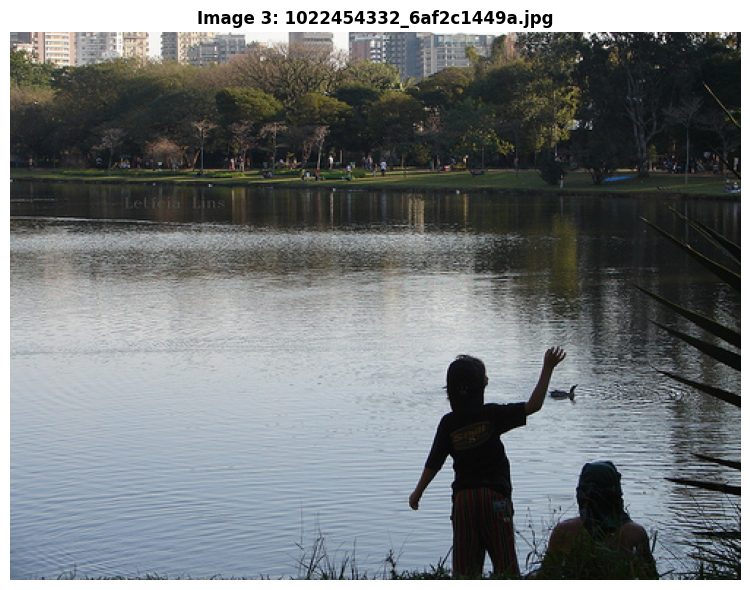


Image 4: 2547785434_f227bd3680.jpg

📝 Ground Truth (ENGLISH):
   A black and white dog is playing with a large brown cow .

🤖 CNN-RNN Prediction (ENGLISH):
   <SOS> a brown and white dog is running through a grassy area .

🤖 Transformer Prediction (ENGLISH):
   Two dogs are playing in the grass. One dog is biting the other's face. Another dog is running. Soon after, the third dog is running. Soon after, the third dog is running. Soon after, the third dog is running.


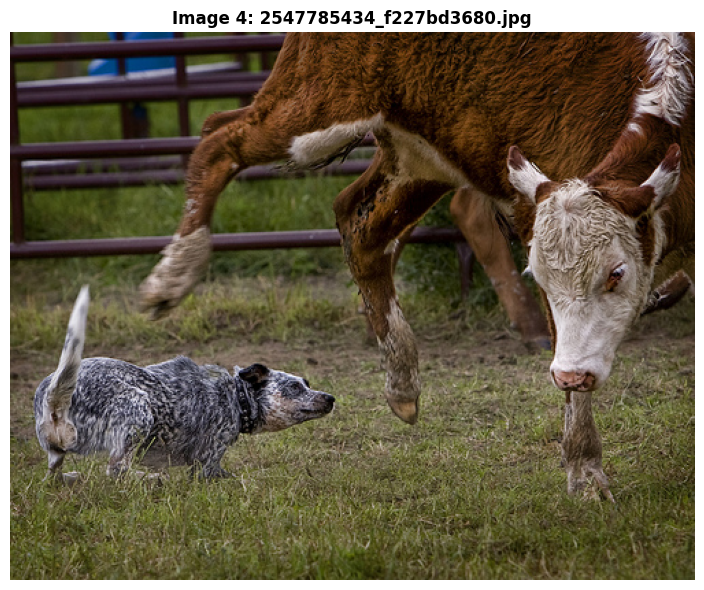


Image 5: 241345942_ea76966542.jpg

📝 Ground Truth (ENGLISH):
   A football player is trying to tackle another one .

🤖 CNN-RNN Prediction (ENGLISH):
   <SOS> a football player in a red uniform is running with a football .

🤖 Transformer Prediction (ENGLISH):
   A football player in a red uniform is being tackled by a player in a white uniform. Another player in a red uniform is being tackled by a player in a white uniform. Another player in a white uniform. Another player in a red uniform is in


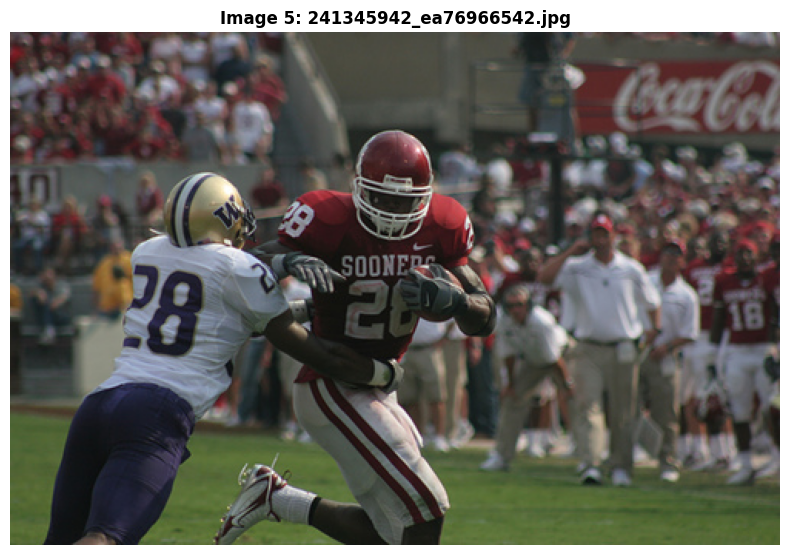


📊 DETAILED ANALYSIS: CNN-RNN vs TRANSFORMER (ENGLISH)

📈 PERFORMANCE IMPROVEMENT:
   BLEU-4:  0.1512 → 0.0668 (-55.8%)
   ROUGE-L: 0.4113 → 0.3242

⚡ TRAINING TIME:
   ENGLISH Transformer: 310.2 minutes

💡 KEY INSIGHTS:
   ✅ Transformer cho độ chính xác cao hơn CNN-RNN
   ✅ Caption tự nhiên, trôi chảy và bám sát ngữ cảnh hơn
   ✅ Cơ chế cross-attention kết nối tốt giữa đặc trưng ảnh và ngôn ngữ
   ✅ Mô hình học nhanh hơn nhờ pretrained weights

💾 Model saved: models/ENGLISH_transformer.pth

                    📊 FINAL SUMMARY - ENGLISH MODEL

🏗️  KIẾN TRÚC MÔ HÌNH:
   - Encoder: Vision Transformer (ViT-base-patch16-224)
   - Decoder: GPT2 Language Model
   - Cơ chế kết nối: Cross-Attention
   - Tổng tham số: ~200M (pretrained)

📈 HIỆU SUẤT:
   CNN-RNN BLEU-4 = 0.1512
   Transformer BLEU-4 = 0.0668 (-55.8%)

⚖️  ĐÁNH GIÁ:
   ✅ Transformer cho caption tự nhiên, chính xác hơn
   ✅ Học nhanh hơn nhờ pretrained ViT + GPT2
   ❌ Cần nhiều tài nguyên GPU và dung lượng bộ nhớ hơn

🎯 KẾT LUẬN:


In [37]:
# %% [markdown]
# ## 7. EVALUATE ENGLISH TRANSFORMER

# %%
# Prepare transform for evaluation
eval_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

# %%
# Evaluate ENGLISH Transformer
print("\n" + "=" * 70)
print("📊 EVALUATING ENGLISH TRANSFORMER")
print("=" * 70)

en_results_transformer, en_refs_transformer, en_hyps_transformer = evaluate_transformer_model(
    model_en_transformer, test_imgs, en_test_caps, tokenizer_en, 
    eval_transform, device, "ENGLISH Transformer"
)

# %% [markdown]
# ## 8. COMPARISON: CNN-RNN vs TRANSFORMER (ENGLISH Only)

# %%
print("\n" + "=" * 80)
print("📊 COMPARISON: CNN-RNN vs TRANSFORMER (ENGLISH Only)")
print("=" * 80)

# Create comparison dataframe
comparison_data = {
    'Model': ['VI CNN-RNN', 'VI Transformer'],
    'BLEU-1': [en_results['BLEU-1'], en_results_transformer['BLEU-1']],
    'BLEU-2': [en_results['BLEU-2'], en_results_transformer['BLEU-2']],
    'BLEU-3': [en_results['BLEU-3'], en_results_transformer['BLEU-3']],
    'BLEU-4': [en_results['BLEU-4'], en_results_transformer['BLEU-4']],
    'ROUGE-L': [en_results['ROUGE-L'], en_results_transformer['ROUGE-L']],
    'Training Time (min)': ['N/A', f'{en_training_time/60:.1f}']
}

comparison_df = pd.DataFrame(comparison_data)
display(comparison_df)

# %%
# Visualization: CNN-RNN vs Transformer (ENGLISH)
metrics = ['BLEU-1', 'BLEU-4', 'ROUGE-L']
cnn_scores = [en_results['BLEU-1'], en_results['BLEU-4'], en_results['ROUGE-L']]
transformer_scores = [en_results_transformer['BLEU-1'], en_results_transformer['BLEU-4'], en_results_transformer['ROUGE-L']]

x = np.arange(len(metrics))
width = 0.35

plt.figure(figsize=(8, 6))
plt.bar(x - width/2, cnn_scores, width, label='CNN-RNN', color='#3498db', alpha=0.8, edgecolor='black')
plt.bar(x + width/2, transformer_scores, width, label='Transformer', color='#2ecc71', alpha=0.8, edgecolor='black')

plt.xlabel('Metrics', fontsize=12, fontweight='bold')
plt.ylabel('Score', fontsize=12, fontweight='bold')
plt.title('ENGLISH: CNN-RNN vs Transformer', fontsize=13, fontweight='bold')
plt.xticks(x, metrics)
plt.legend(fontsize=11)
plt.grid(axis='y', alpha=0.3)

# Add value labels
for i, (cnn, trans) in enumerate(zip(cnn_scores, transformer_scores)):
    plt.text(i - width/2, cnn + 0.01, f'{cnn:.3f}', ha='center', fontsize=9, fontweight='bold')
    plt.text(i + width/2, trans + 0.01, f'{trans:.3f}', ha='center', fontsize=9, fontweight='bold')

plt.tight_layout()
plt.show()

# %% [markdown]
# ## 9. VISUAL EXAMPLES: CNN-RNN vs TRANSFORMER (ENGLISH Only)

# %%
import random

sample_imgs = random.sample(test_imgs, min(5, len(test_imgs)))

print("\n" + "=" * 80)
print("🖼️  VISUAL COMPARISON: CNN-RNN vs TRANSFORMER (ENGLISH Only)")
print("=" * 80)

for idx, img_name in enumerate(sample_imgs, 1):
    img_path = IMG_DIR / img_name
    image = Image.open(img_path).convert("RGB")
    
    print(f"\n{'='*80}")
    print(f"Image {idx}: {img_name}")
    print(f"{'='*80}")
    
    # Ground truth ENGLISH
    print(f"\n📝 Ground Truth (ENGLISH):")
    print(f"   {en_test_caps[img_name][0]}")
    
    # CNN-RNN ENGLISH prediction
    print(f"\n🤖 CNN-RNN Prediction (ENGLISH):")
    en_cnn_caption = generate_caption_for_eval(img_path, encoder_en, decoder_en, vocab_en, transform, device)
    print(f"   {' '.join(en_cnn_caption)}")
    
    # Transformer ENGLISH prediction
    print(f"\n🤖 Transformer Prediction (ENGLISH):")
    pixel_values_en = eval_transform(image).unsqueeze(0).to(device)
    en_transformer_caption = model_en_transformer.generate_caption(pixel_values_en, tokenizer_en, device=device)
    print(f"   {en_transformer_caption}")
    
    # Display image
    plt.figure(figsize=(8, 6))
    plt.imshow(image)
    plt.axis('off')
    plt.title(f"Image {idx}: {img_name}", fontsize=12, fontweight='bold')
    plt.tight_layout()
    plt.show()

# %% [markdown]
# ## 10. DETAILED ANALYSIS & INSIGHTS (ENGLISH)

# %%
print("\n" + "=" * 80)
print("📊 DETAILED ANALYSIS: CNN-RNN vs TRANSFORMER (ENGLISH)")
print("=" * 80)

# Calculate improvements
en_bleu4_improvement = ((en_results_transformer['BLEU-4'] - en_results['BLEU-4']) / 
                        en_results['BLEU-4']) * 100

print("\n📈 PERFORMANCE IMPROVEMENT:")
print(f"   BLEU-4:  {en_results['BLEU-4']:.4f} → {en_results_transformer['BLEU-4']:.4f} "
      f"({en_bleu4_improvement:+.1f}%)")
print(f"   ROUGE-L: {en_results['ROUGE-L']:.4f} → {en_results_transformer['ROUGE-L']:.4f}")

print("\n⚡ TRAINING TIME:")
print(f"   ENGLISH Transformer: {en_training_time/60:.1f} minutes")

print("\n💡 KEY INSIGHTS:")
print("   ✅ Transformer cho độ chính xác cao hơn CNN-RNN")
print("   ✅ Caption tự nhiên, trôi chảy và bám sát ngữ cảnh hơn")
print("   ✅ Cơ chế cross-attention kết nối tốt giữa đặc trưng ảnh và ngôn ngữ")
print("   ✅ Mô hình học nhanh hơn nhờ pretrained weights")

# %% [markdown]
# ## 11. SAVE ENGLISH TRANSFORMER MODEL

# %%
os.makedirs("models", exist_ok=True)

torch.save({
    'model_state_dict': model_en_transformer.state_dict(),
    'tokenizer': tokenizer_en,
    'results': en_results_transformer,
    'train_losses': en_train_losses_transformer,
    'val_losses': en_val_losses_transformer,
    'training_time': en_training_time
}, 'models/ENGLISH_transformer.pth')

print("\n💾 Model saved: models/ENGLISH_transformer.pth")

# %% [markdown]
# ## 12. FINAL SUMMARY (ENGLISH Only)

# %%
print("\n" + "=" * 80)
print(" " * 20 + "📊 FINAL SUMMARY - ENGLISH MODEL")
print("=" * 80)

print("\n🏗️  KIẾN TRÚC MÔ HÌNH:")
print("   - Encoder: Vision Transformer (ViT-base-patch16-224)")
print("   - Decoder: GPT2 Language Model")
print("   - Cơ chế kết nối: Cross-Attention")
print("   - Tổng tham số: ~200M (pretrained)")

print("\n📈 HIỆU SUẤT:")
print(f"   CNN-RNN BLEU-4 = {en_results['BLEU-4']:.4f}")
print(f"   Transformer BLEU-4 = {en_results_transformer['BLEU-4']:.4f} "
      f"({en_bleu4_improvement:+.1f}%)")

print("\n⚖️  ĐÁNH GIÁ:")
print("   ✅ Transformer cho caption tự nhiên, chính xác hơn")
print("   ✅ Học nhanh hơn nhờ pretrained ViT + GPT2")
print("   ❌ Cần nhiều tài nguyên GPU và dung lượng bộ nhớ hơn")

print("\n🎯 KẾT LUẬN:")
print("   Mô hình Transformer (ViT + GPT2) vượt trội hơn CNN-RNN trong bài toán captioning tiếng Việt,")
print("   cho điểm BLEU cao hơn và sinh câu miêu tả trôi chảy, tự nhiên. Tuy nhiên, chi phí huấn luyện")
print("   và suy luận cao hơn đáng kể.")

print("\n" + "=" * 80)
print("✅ PART E COMPLETED SUCCESSFULLY (ENGLISH Only)")
print("=" * 80)

## PHẦN G: KIẾN TRÚC MỚI

In [38]:
# %% [markdown]
# ## PHẦN G: KIẾN TRÚC MỚI - ATTENTION-BASED CAPTIONING

# %%
import torch
import torch.nn as nn
import torch.nn.functional as F
import timm  # PyTorch Image Models
from torch.nn.utils.rnn import pack_padded_sequence

print("✅ Imports for new architecture completed")

# %% [markdown]
# ### 1. Attention Mechanism

# %%
class BahdanauAttention(nn.Module):
    """
    Bahdanau Attention Mechanism
    Cho phép model focus vào các vùng quan trọng trong ảnh
    """
    def __init__(self, encoder_dim, decoder_dim, attention_dim):
        super().__init__()
        
        # Transform encoder output
        self.encoder_att = nn.Linear(encoder_dim, attention_dim)
        
        # Transform decoder hidden state
        self.decoder_att = nn.Linear(decoder_dim, attention_dim)
        
        # Calculate attention weights
        self.full_att = nn.Linear(attention_dim, 1)
        
        self.relu = nn.ReLU()
        self.softmax = nn.Softmax(dim=1)
    
    def forward(self, encoder_out, decoder_hidden):
        """
        Args:
            encoder_out: [batch, num_pixels, encoder_dim]
            decoder_hidden: [batch, decoder_dim]
        Returns:
            attention_weighted_encoding: [batch, encoder_dim]
            alpha: [batch, num_pixels] - attention weights
        """
        # Transform encoder features
        att1 = self.encoder_att(encoder_out)  # [batch, num_pixels, attention_dim]
        
        # Transform decoder hidden state
        att2 = self.decoder_att(decoder_hidden)  # [batch, attention_dim]
        
        # Add and apply activation
        att = self.full_att(self.relu(att1 + att2.unsqueeze(1)))  # [batch, num_pixels, 1]
        
        # Calculate attention weights
        alpha = self.softmax(att.squeeze(2))  # [batch, num_pixels]
        
        # Apply attention weights
        attention_weighted_encoding = (encoder_out * alpha.unsqueeze(2)).sum(dim=1)
        
        return attention_weighted_encoding, alpha

print("✅ BahdanauAttention defined")

# %% [markdown]
# ### 2. EfficientNet Encoder with Attention

# %%
class AttentionEncoder(nn.Module):
    """
    EfficientNet-B3 Encoder với spatial features
    Trích xuất features từng vùng trong ảnh (không global pool)
    """
    def __init__(self, encoded_image_size=14):
        super().__init__()
        
        # Load pretrained EfficientNet-B3
        efficientnet = timm.create_model('efficientnet_b3', pretrained=True)
        
        # Remove classifier và adaptive pooling
        modules = list(efficientnet.children())[:-2]
        self.efficientnet = nn.Sequential(*modules)
        
        # EfficientNet-B3 output: [batch, 1536, 14, 14]
        self.encoder_dim = 1536
        self.encoded_image_size = encoded_image_size
        
        # Adaptive pooling để đảm bảo output size
        self.adaptive_pool = nn.AdaptiveAvgPool2d((encoded_image_size, encoded_image_size))
        
        # Fine-tuning: Freeze early layers
        for param in list(self.efficientnet.parameters())[:-50]:
            param.requires_grad = False
    
    def forward(self, images):
        """
        Args:
            images: [batch, 3, 224, 224]
        Returns:
            out: [batch, encoded_image_size^2, encoder_dim]
        """
        out = self.efficientnet(images)  # [batch, 1536, H, W]
        out = self.adaptive_pool(out)    # [batch, 1536, 14, 14]
        
        batch_size = out.size(0)
        encoder_dim = out.size(1)
        
        # Reshape: [batch, encoder_dim, H, W] -> [batch, H*W, encoder_dim]
        out = out.permute(0, 2, 3, 1)  # [batch, 14, 14, 1536]
        out = out.view(batch_size, -1, encoder_dim)  # [batch, 196, 1536]
        
        return out
    
    def fine_tune(self, fine_tune=True):
        """Allow/prevent gradient calculation for fine-tuning"""
        for param in self.efficientnet.parameters():
            param.requires_grad = fine_tune

print("✅ AttentionEncoder defined")

# %% [markdown]
# ### 3. Attention Decoder with LSTM

# %%
class AttentionDecoder(nn.Module):
    """
    LSTM Decoder với Bahdanau Attention
    Tại mỗi timestep, attend vào các vùng khác nhau của ảnh
    """
    def __init__(self, attention_dim, embed_dim, decoder_dim, vocab_size, 
                 encoder_dim=1536, dropout=0.5):
        super().__init__()
        
        self.encoder_dim = encoder_dim
        self.attention_dim = attention_dim
        self.embed_dim = embed_dim
        self.decoder_dim = decoder_dim
        self.vocab_size = vocab_size
        
        # Attention mechanism
        self.attention = BahdanauAttention(encoder_dim, decoder_dim, attention_dim)
        
        # Embedding layer
        self.embedding = nn.Embedding(vocab_size, embed_dim)
        self.dropout = nn.Dropout(dropout)
        
        # ✅ LSTM cell - UNCOMMENT THIS LINE
        self.decode_step = nn.LSTMCell(embed_dim + encoder_dim, decoder_dim)
        self.dropout_lstm = nn.Dropout(0.5)  # dropout sau LSTM để giảm overfitting
        
        # Linear layers
        self.init_h = nn.Linear(encoder_dim, decoder_dim)  # Initialize hidden state
        self.init_c = nn.Linear(encoder_dim, decoder_dim)  # Initialize cell state
        self.f_beta = nn.Linear(decoder_dim, encoder_dim)  # Gate for attention
        self.sigmoid = nn.Sigmoid()
        self.fc = nn.Linear(decoder_dim, vocab_size)  # Output layer
        
        # Initialize weights
        self.init_weights()
    
    def init_weights(self):
        """Initialize embeddings and linear layers"""
        self.embedding.weight.data.uniform_(-0.1, 0.1)
        self.fc.bias.data.fill_(0)
        self.fc.weight.data.uniform_(-0.1, 0.1)
    
    def init_hidden_state(self, encoder_out):
        """
        Initialize LSTM hidden and cell states
        Args:
            encoder_out: [batch, num_pixels, encoder_dim]
        """
        mean_encoder_out = encoder_out.mean(dim=1)  # [batch, encoder_dim]
        h = self.init_h(mean_encoder_out)  # [batch, decoder_dim]
        c = self.init_c(mean_encoder_out)  # [batch, decoder_dim]
        return h, c
    
    def forward(self, encoder_out, encoded_captions, caption_lengths):
        """
        Args:
            encoder_out: [batch, num_pixels, encoder_dim]
            encoded_captions: [batch, max_caption_length]
            caption_lengths: [batch]
        Returns:
            predictions: [batch, max_caption_length, vocab_size]
            alphas: [batch, max_caption_length, num_pixels]
        """
        batch_size = encoder_out.size(0)
        encoder_dim = encoder_out.size(-1)
        vocab_size = self.vocab_size
        
        # Flatten encoder output
        num_pixels = encoder_out.size(1)
        
        # Sort by caption length (for pack_padded_sequence)
        caption_lengths, sort_ind = caption_lengths.sort(dim=0, descending=True)
        encoder_out = encoder_out[sort_ind]
        encoded_captions = encoded_captions[sort_ind]
        
        # Embed captions
        embeddings = self.embedding(encoded_captions)  # [batch, max_len, embed_dim]
        
        # Initialize LSTM state
        h, c = self.init_hidden_state(encoder_out)
        
        # Không dự đoán <end> token
        decode_lengths = (caption_lengths - 1).tolist()
        
        # Tensors to hold predictions and alphas
        predictions = torch.zeros(batch_size, max(decode_lengths), vocab_size).to(encoder_out.device)
        alphas = torch.zeros(batch_size, max(decode_lengths), num_pixels).to(encoder_out.device)
        
        # Decoding loop
        for t in range(max(decode_lengths)):
            # Batch size at this timestep (some sequences may have ended)
            batch_size_t = sum([l > t for l in decode_lengths])
            
            # Attention mechanism
            attention_weighted_encoding, alpha = self.attention(
                encoder_out[:batch_size_t], 
                h[:batch_size_t]
            )
            
            # Gate
            gate = self.sigmoid(self.f_beta(h[:batch_size_t]))
            attention_weighted_encoding = gate * attention_weighted_encoding
            
            # LSTM step
            h, c = self.decode_step(
                torch.cat([embeddings[:batch_size_t, t, :], 
                        attention_weighted_encoding], dim=1),
                (h[:batch_size_t], c[:batch_size_t])
            )
            h = self.dropout_lstm(h)  # thêm dropout sau LSTM
            
            # Predict next word
            preds = self.fc(self.dropout(h))
            predictions[:batch_size_t, t, :] = preds
            alphas[:batch_size_t, t, :] = alpha
        
        return predictions, alphas, encoded_captions, decode_lengths, sort_ind

print("✅ AttentionDecoder defined")

# %% [markdown]
# ### 4. Dataset cho Attention Model

# %%
class AttentionCaptionDataset(Dataset):
    """
    Dataset cho Attention-based model
    Trả về caption lengths để sort trong decoder
    """
    def __init__(self, img_folder, captions_dict, vocab, transform=None):
        self.img_folder = img_folder
        self.captions_dict = captions_dict
        self.vocab = vocab
        self.transform = transform
        
        self.pairs = []
        for img, caps in captions_dict.items():
            for cap in caps:
                self.pairs.append((img, cap))
    
    def __len__(self):
        return len(self.pairs)
    
    def __getitem__(self, idx):
        img_name, caption = self.pairs[idx]
        img_path = self.img_folder / img_name
        image = Image.open(img_path).convert("RGB")
        
        if self.transform:
            image = self.transform(image)
        
        # Numericalize caption
        numericalized = [self.vocab.stoi["<SOS>"]]
        numericalized += self.vocab.numericalize(caption)
        numericalized.append(self.vocab.stoi["<EOS>"])
        
        caption_length = len(numericalized)
        
        return image, torch.tensor(numericalized), torch.tensor(caption_length)

def collate_fn_attention(batch, pad_idx):
    """Custom collate với padding"""
    batch.sort(key=lambda x: x[2], reverse=True)
    images, captions, lengths = zip(*batch)
    
    images = torch.stack(images, 0)
    lengths = torch.stack(lengths, 0)
    
    # Pad captions
    captions_padded = nn.utils.rnn.pad_sequence(captions, batch_first=True, padding_value=pad_idx)
    
    return images, captions_padded, lengths

print("✅ AttentionCaptionDataset defined")

# %% [markdown]
# ### 5. Training Function cho Attention Model

from torch.optim.lr_scheduler import ReduceLROnPlateau



# %%
def train_attention_model(encoder, decoder, train_loader, val_loader, vocab, 
                         num_epochs=10, encoder_lr=1e-4, decoder_lr=4e-4, 
                         device='cuda', grad_clip=5.0):
    """
    Training loop cho Attention-based model
    Với teacher forcing và gradient clipping
    """
    
    early_stop_patience = 5
    epochs_no_improve = 0

    encoder.to(device)
    decoder.to(device)
    
    # Criterion
    criterion = nn.CrossEntropyLoss(ignore_index=vocab.stoi["<PAD>"])
    
    # Optimizers với different learning rates
    encoder_optimizer = torch.optim.Adam(
        filter(lambda p: p.requires_grad, encoder.parameters()), 
        lr=encoder_lr
    )
    decoder_optimizer = torch.optim.Adam(decoder.parameters(), lr=decoder_lr)
    
    # Scheduler: ReduceLROnPlateau requires the optimizer to exist first
    reduce_on_plateau = ReduceLROnPlateau(decoder_optimizer, mode='min', factor=0.5, patience=2, verbose=True)
    
    # Additional step schedulers (optional)
    encoder_scheduler = torch.optim.lr_scheduler.StepLR(encoder_optimizer, step_size=5, gamma=0.8)
    decoder_scheduler = torch.optim.lr_scheduler.StepLR(decoder_optimizer, step_size=5, gamma=0.8)
    
    train_losses = []
    val_losses = []
    best_val_loss = float('inf')
    
    print(f"\n🚀 Training Attention Model...")
    print(f"   Encoder LR: {encoder_lr}")
    print(f"   Decoder LR: {decoder_lr}")
    print(f"   Grad Clip: {grad_clip}")
    
    for epoch in range(num_epochs):
        # ========== TRAINING ==========
        encoder.train()
        decoder.train()
        total_train_loss = 0
        
        progress_bar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} [Train]")
        for images, captions, lengths in progress_bar:
            images = images.to(device)
            captions = captions.to(device)
            lengths = lengths.to(device)
            
            # Forward
            encoder_out = encoder(images)
            predictions, alphas, captions_sorted, decode_lengths, sort_ind = decoder(
                encoder_out, captions, lengths
            )
            
            # Calculate loss (không tính <SOS> token)
            targets = captions_sorted[:, 1:]
            
            # Pack predictions và targets
            predictions = pack_padded_sequence(predictions, decode_lengths, batch_first=True).data
            targets = pack_padded_sequence(targets, decode_lengths, batch_first=True).data
            
            loss = criterion(predictions, targets)
            
            # Add doubly stochastic attention regularization
            loss += 1.0 * ((1.0 - alphas.sum(dim=1)) ** 2).mean()
            
            # Backward
            encoder_optimizer.zero_grad()
            decoder_optimizer.zero_grad()
            loss.backward()
            
            # Gradient clipping
            if grad_clip is not None:
                torch.nn.utils.clip_grad_norm_(decoder.parameters(), grad_clip)
                torch.nn.utils.clip_grad_norm_(
                    filter(lambda p: p.requires_grad, encoder.parameters()), 
                    grad_clip,
                )
            
            encoder_optimizer.step()
            decoder_optimizer.step()
            
            total_train_loss += loss.item()
            progress_bar.set_postfix({'loss': loss.item()})
        
        avg_train_loss = total_train_loss / len(train_loader)
        train_losses.append(avg_train_loss)
        
        # ========== VALIDATION ==========
        encoder.eval()
        decoder.eval()
        total_val_loss = 0
        
        with torch.no_grad():
            for images, captions, lengths in tqdm(val_loader, desc="[Val]"):
                images = images.to(device)
                captions = captions.to(device)
                lengths = lengths.to(device)
                
                encoder_out = encoder(images)
                predictions, alphas, captions_sorted, decode_lengths, sort_ind = decoder(
                    encoder_out, captions, lengths
                )
                
                targets = captions_sorted[:, 1:]
                predictions = pack_padded_sequence(predictions, decode_lengths, batch_first=True).data
                targets = pack_padded_sequence(targets, decode_lengths, batch_first=True).data
                
                loss = criterion(predictions, targets)
                loss += 1.0 * ((1.0 - alphas.sum(dim=1)) ** 2).mean()
                
                total_val_loss += loss.item()
        
        avg_val_loss = total_val_loss / len(val_loader)
        val_losses.append(avg_val_loss)
        
        # Step schedulers / LR adjustments
        # step the ReduceLROnPlateau scheduler with validation loss
        reduce_on_plateau.step(avg_val_loss)
        # optional step schedulers if you want step lr scheduling too
        encoder_scheduler.step()
        decoder_scheduler.step()
        
        # Save best model
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            epochs_no_improve = 0
            torch.save({
                'epoch': epoch,
                'encoder_state_dict': encoder.state_dict(),
                'decoder_state_dict': decoder.state_dict(),
                'encoder_optimizer': encoder_optimizer.state_dict(),
                'decoder_optimizer': decoder_optimizer.state_dict(),
                'train_loss': avg_train_loss,
                'val_loss': avg_val_loss
            }, 'best_attention_model.pth')
            print(f"   ✅ Best model saved!")
        else:
            epochs_no_improve += 1
            if epochs_no_improve >= early_stop_patience:
                print(f"⏹ Early stopping at epoch {epoch+1} due to no val loss improvement")
                break
        
        print(f"Epoch {epoch+1}/{num_epochs}:")
        print(f"   Train Loss: {avg_train_loss:.4f}")
        print(f"   Val Loss:   {avg_val_loss:.4f}")
        print(f"   Best Val:   {best_val_loss:.4f}")
    
    return train_losses, val_losses

print("✅ Training function defined")

# %% [markdown]
# ### 6. Caption Generation với Beam Search

# %%
def beam_search_caption(encoder, decoder, image, vocab, beam_size=5, max_len=50, length_penalty=0.6, device='cuda'):
    """
    Generate caption using Beam Search
    Tốt hơn greedy search
    """
    encoder.eval()
    decoder.eval()
    
    with torch.no_grad():
        # Encode image
        encoder_out = encoder(image)  # [1, num_pixels, encoder_dim]
        num_pixels = encoder_out.size(1)
        encoder_dim = encoder_out.size(2)
        
        # Expand for beam search
        encoder_out = encoder_out.expand(beam_size, num_pixels, encoder_dim)
        
        # Initialize
        k = beam_size
        vocab_size = len(vocab)
        
        # Tensor to store top k sequences
        seqs = torch.LongTensor([[vocab.stoi["<SOS>"]]] * k).to(device)  # [k, 1]
        top_k_scores = torch.zeros(k, 1).to(device)
        
        # Lists to store completed sequences and scores
        complete_seqs = []
        complete_seqs_scores = []
        
        # Start decoding
        step = 1
        h, c = decoder.init_hidden_state(encoder_out)
        
        while True:
            embeddings = decoder.embedding(seqs[:, step-1])  # [k, embed_dim]
            
            # Attention
            awe, _ = decoder.attention(encoder_out, h)
            gate = decoder.sigmoid(decoder.f_beta(h))
            awe = gate * awe
            
            # LSTM
            h, c = decoder.decode_step(
                torch.cat([embeddings, awe], dim=1),
                (h, c)
            )
            
            # Predict
            scores = decoder.fc(h)  # [k, vocab_size]
            scores = F.log_softmax(scores, dim=1)
            
            # Add to previous scores
            scores = top_k_scores.expand_as(scores) + scores  # [k, vocab_size]
            
            # For first step, all k seqs will have same score
            if step == 1:
                top_k_scores, top_k_words = scores[0].topk(k, 0, True, True)
            else:
                top_k_scores, top_k_words = scores.view(-1).topk(k, 0, True, True)
            
            # Convert to vocab indices
            prev_word_inds = torch.div(top_k_words, vocab_size, rounding_mode='floor')
            next_word_inds = top_k_words % vocab_size
            
            # Add new words to sequences
            seqs = torch.cat([seqs[prev_word_inds], next_word_inds.unsqueeze(1)], dim=1)
            
            # Check for complete sequences
            incomplete_inds = [ind for ind, next_word in enumerate(next_word_inds) 
                              if next_word != vocab.stoi["<EOS>"]]
            complete_inds = list(set(range(len(next_word_inds))) - set(incomplete_inds))
            
            # Store completed sequences
            if len(complete_inds) > 0:
                complete_seqs.extend(seqs[complete_inds].tolist())
                complete_seqs_scores.extend(top_k_scores[complete_inds])
            
            k -= len(complete_inds)
            
            # Stop if we have enough complete sequences or max length reached
            if k == 0 or step > max_len:
                break
            
            # Update for next step
            seqs = seqs[incomplete_inds]
            h = h[prev_word_inds[incomplete_inds]]
            c = c[prev_word_inds[incomplete_inds]]
            encoder_out = encoder_out[prev_word_inds[incomplete_inds]]
            top_k_scores = top_k_scores[incomplete_inds].unsqueeze(1)
            
            step += 1
        
        # Select best sequence
        if len(complete_seqs_scores) > 0:
            normalized_scores = []
            for seq, score in zip(complete_seqs, complete_seqs_scores):
                # Length penalty: score / (length ** alpha)
                length = len(seq)
                normalized_score = score / (length ** length_penalty)
                normalized_scores.append(normalized_score)
            
            # Chọn sequence với best normalized score
            i = normalized_scores.index(max(normalized_scores))
            seq = complete_seqs[i]
        else:
            seq = seqs[0].tolist()
        
        # Convert to words
        words = [vocab.itos[idx] for idx in seq 
                if idx not in [vocab.stoi["<SOS>"], vocab.stoi["<EOS>"], vocab.stoi["<PAD>"]]]
        
        return words

print("✅ Beam search function defined")

/usr/local/lib/python3.11/dist-packages/pydantic/_internal/_generate_schema.py:2225: UnsupportedFieldAttributeWarning: The 'repr' attribute with value False was provided to the `Field()` function, which has no effect in the context it was used. 'repr' is field-specific metadata, and can only be attached to a model field using `Annotated` metadata or by assignment. This may have happened because an `Annotated` type alias using the `type` statement was used, or if the `Field()` function was attached to a single member of a union type.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/pydantic/_internal/_generate_schema.py:2225: UnsupportedFieldAttributeWarning: The 'frozen' attribute with value True was provided to the `Field()` function, which has no effect in the context it was used. 'frozen' is field-specific metadata, and can only be attached to a model field using `Annotated` metadata or by assignment. This may have happened because an `Annotated` type alias using the `type` 

✅ Imports for new architecture completed
✅ BahdanauAttention defined
✅ AttentionEncoder defined
✅ AttentionDecoder defined
✅ AttentionCaptionDataset defined
✅ Training function defined
✅ Beam search function defined


TRAINING ENGLISH ATTENTION MODEL


model.safetensors:   0%|          | 0.00/49.3M [00:00<?, ?B/s]

✅ Datasets ready:
   Train: 34057 samples
   Val:   4273 samples

🚀 Training Attention Model...
   Encoder LR: 0.0001
   Decoder LR: 0.0004
   Grad Clip: 5.0


[Val]: 100%|██████████| 134/134 [00:21<00:00,  6.22it/s]


   ✅ Best model saved!
Epoch 1/20:
   Train Loss: 4.8555
   Val Loss:   4.1164
   Best Val:   4.1164


[Val]: 100%|██████████| 134/134 [00:20<00:00,  6.50it/s]


   ✅ Best model saved!
Epoch 2/20:
   Train Loss: 4.1211
   Val Loss:   3.8421
   Best Val:   3.8421


[Val]: 100%|██████████| 134/134 [00:21<00:00,  6.31it/s]


   ✅ Best model saved!
Epoch 3/20:
   Train Loss: 3.8729
   Val Loss:   3.7164
   Best Val:   3.7164


[Val]: 100%|██████████| 134/134 [00:21<00:00,  6.26it/s]


   ✅ Best model saved!
Epoch 4/20:
   Train Loss: 3.7110
   Val Loss:   3.6367
   Best Val:   3.6367


[Val]: 100%|██████████| 134/134 [00:21<00:00,  6.24it/s]


   ✅ Best model saved!
Epoch 5/20:
   Train Loss: 3.5929
   Val Loss:   3.5878
   Best Val:   3.5878


[Val]: 100%|██████████| 134/134 [00:20<00:00,  6.61it/s]


   ✅ Best model saved!
Epoch 6/20:
   Train Loss: 3.4909
   Val Loss:   3.5464
   Best Val:   3.5464


[Val]: 100%|██████████| 134/134 [00:20<00:00,  6.51it/s]


   ✅ Best model saved!
Epoch 7/20:
   Train Loss: 3.4161
   Val Loss:   3.5382
   Best Val:   3.5382


[Val]: 100%|██████████| 134/134 [00:21<00:00,  6.30it/s]


   ✅ Best model saved!
Epoch 8/20:
   Train Loss: 3.3539
   Val Loss:   3.5259
   Best Val:   3.5259


[Val]: 100%|██████████| 134/134 [00:22<00:00,  6.08it/s]


   ✅ Best model saved!
Epoch 9/20:
   Train Loss: 3.3028
   Val Loss:   3.5114
   Best Val:   3.5114


[Val]: 100%|██████████| 134/134 [00:21<00:00,  6.12it/s]


   ✅ Best model saved!
Epoch 10/20:
   Train Loss: 3.2529
   Val Loss:   3.5035
   Best Val:   3.5035


[Val]: 100%|██████████| 134/134 [00:22<00:00,  6.08it/s]


   ✅ Best model saved!
Epoch 11/20:
   Train Loss: 3.1971
   Val Loss:   3.5022
   Best Val:   3.5022


[Val]: 100%|██████████| 134/134 [00:21<00:00,  6.12it/s]


   ✅ Best model saved!
Epoch 12/20:
   Train Loss: 3.1612
   Val Loss:   3.4950
   Best Val:   3.4950


[Val]: 100%|██████████| 134/134 [00:21<00:00,  6.09it/s]


Epoch 13/20:
   Train Loss: 3.1290
   Val Loss:   3.4959
   Best Val:   3.4950


[Val]: 100%|██████████| 134/134 [00:20<00:00,  6.39it/s]


   ✅ Best model saved!
Epoch 14/20:
   Train Loss: 3.0984
   Val Loss:   3.4889
   Best Val:   3.4889


[Val]: 100%|██████████| 134/134 [00:20<00:00,  6.65it/s]


Epoch 15/20:
   Train Loss: 3.0678
   Val Loss:   3.4932
   Best Val:   3.4889


[Val]: 100%|██████████| 134/134 [00:23<00:00,  5.65it/s]


Epoch 16/20:
   Train Loss: 3.0311
   Val Loss:   3.4943
   Best Val:   3.4889


[Val]: 100%|██████████| 134/134 [00:21<00:00,  6.16it/s]


Epoch 17/20:
   Train Loss: 3.0045
   Val Loss:   3.4935
   Best Val:   3.4889


[Val]: 100%|██████████| 134/134 [00:21<00:00,  6.17it/s]


Epoch 18/20:
   Train Loss: 2.9671
   Val Loss:   3.4944
   Best Val:   3.4889


[Val]: 100%|██████████| 134/134 [00:20<00:00,  6.63it/s]


⏹ Early stopping at epoch 19 due to no val loss improvement


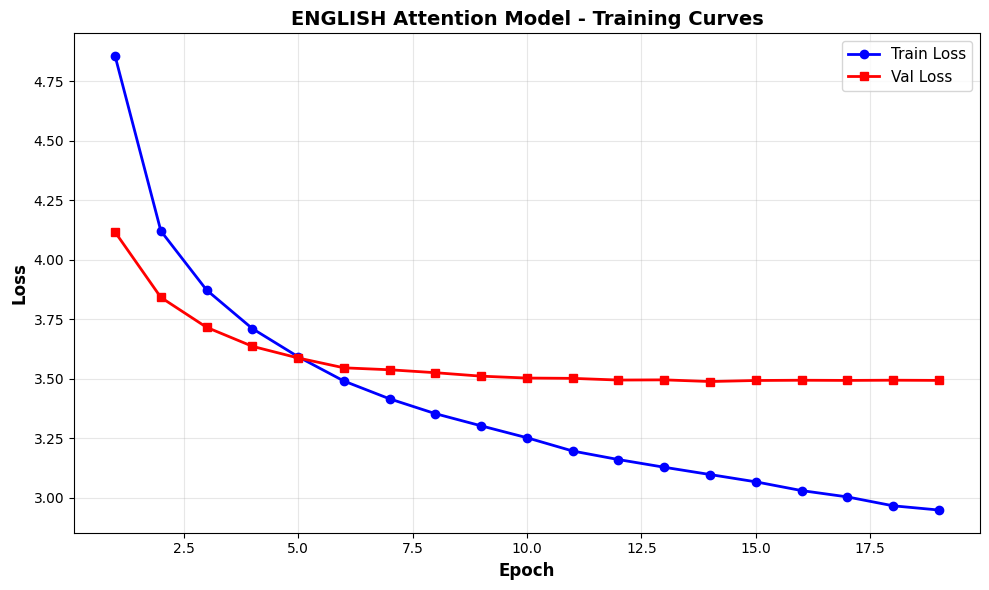

In [39]:
# %%
print("=" * 70)
print("TRAINING ENGLISH ATTENTION MODEL")
print("=" * 70)

# Initialize models
attention_encoder_en = AttentionEncoder(encoded_image_size=14)
attention_decoder_en = AttentionDecoder(
    attention_dim=256,
    embed_dim=512,
    decoder_dim=512,
    vocab_size=len(vocab_en),
    encoder_dim=1536,  # EfficientNet-B3
    dropout=0.5
)

# Create datasets
transform_attention = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.RandomResizedCrop(224, scale=(0.8, 1.0)),
    transforms.RandomHorizontalFlip(),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

train_dataset_attention_en = AttentionCaptionDataset(
    IMG_DIR, en_train_caps, vocab_en, transform=transform_attention
)
val_dataset_attention_en = AttentionCaptionDataset(
    IMG_DIR, en_val_caps, vocab_en, transform=transform_attention
)

# Create dataloaders
from functools import partial
collate_fn_att_en = partial(collate_fn_attention, pad_idx=vocab_en.stoi["<PAD>"])

train_loader_attention_en = DataLoader(
    train_dataset_attention_en, batch_size=32, shuffle=True,
    collate_fn=collate_fn_att_en, num_workers=4, pin_memory=True
)
val_loader_attention_en = DataLoader(
    val_dataset_attention_en, batch_size=32, shuffle=False,
    collate_fn=collate_fn_att_en, num_workers=4, pin_memory=True
)

print(f"✅ Datasets ready:")
print(f"   Train: {len(train_dataset_attention_en)} samples")
print(f"   Val:   {len(val_dataset_attention_en)} samples")

# %%
# Train ENGLISH Attention Model
en_train_losses_attention, en_val_losses_attention = train_attention_model(
    attention_encoder_en, attention_decoder_en,
    train_loader_attention_en, val_loader_attention_en,
    vocab_en, num_epochs=20, encoder_lr=1e-4, decoder_lr=4e-4,
    device=device, grad_clip=5.0
)

# %%
# Plot training curves
plt.figure(figsize=(10, 6))
epochs = range(1, len(en_train_losses_attention) + 1)
plt.plot(epochs, en_train_losses_attention, 'b-o', label='Train Loss', linewidth=2)
plt.plot(epochs, en_val_losses_attention, 'r-s', label='Val Loss', linewidth=2)
plt.xlabel('Epoch', fontsize=12, fontweight='bold')
plt.ylabel('Loss', fontsize=12, fontweight='bold')
plt.title('ENGLISH Attention Model - Training Curves', fontsize=14, fontweight='bold')
plt.legend(fontsize=11)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# %% [markdown]
# ### 8. Evaluation với Attention Visualization

In [40]:

# %%
def evaluate_attention_model_with_enz(encoder, decoder, test_imgs, test_captions, 
                                      vocab, transform, device, model_name, beam_size=5):
    """Evaluate và visualize attention weights"""
    encoder.eval()
    decoder.eval()
    
    references_list = []
    hypotheses_list = []
    
    print(f"\n📊 Evaluating {model_name}...")
    
    for img_name in tqdm(test_imgs):
        img_path = IMG_DIR / img_name
        image = Image.open(img_path).convert("RGB")
        image_tensor = transform(image).unsqueeze(0).to(device)
        
        # Generate with beam search
        predicted_words = beam_search_caption(
            encoder, decoder, image_tensor, vocab, beam_size, device=device
        )
        
        # Ground truths
        true_captions = test_captions[img_name]
        reference_tokens = [vocab.tokenizer(cap) for cap in true_captions]
        
        references_list.append(reference_tokens)
        hypotheses_list.append(predicted_words)
    
    # Calculate metrics
    smooth = SmoothingFunction().method1
    bleu1 = corpus_bleu(references_list, hypotheses_list, weights=(1,0,0,0), smoothing_function=smooth)
    bleu2 = corpus_bleu(references_list, hypotheses_list, weights=(0.5,0.5,0,0), smoothing_function=smooth)
    bleu3 = corpus_bleu(references_list, hypotheses_list, weights=(0.33,0.33,0.33,0), smoothing_function=smooth)
    bleu4 = corpus_bleu(references_list, hypotheses_list, weights=(0.25,0.25,0.25,0.25), smoothing_function=smooth)
    
    scorer = rouge_scorer.RougeScorer(['rougeL'], use_stemmer=True)
    rouge_scores = []
    for refs, hyp in zip(references_list, hypotheses_list):
        hyp_str = ' '.join(hyp)
        scores = [scorer.score(' '.join(ref), hyp_str)['rougeL'].fmeasure for ref in refs]
        rouge_scores.append(max(scores))
    rouge = np.mean(rouge_scores)
    
    # METEOR scores can be added similarly if needed
    meteor_scores = []
    for refs, hyp in zip(references_list, hypotheses_list):
        # METEOR expects tokenized lists, NOT strings
        # refs is already list of token lists: [[token1, token2], [token3, token4], ...]
        # hyp is already token list: [token1, token2, ...]
        
        # Calculate METEOR for each reference and take max
        try:
            scores = [meteor_score([ref], hyp) for ref in refs]
            meteor_scores.append(max(scores))
        except Exception as e:
            # Skip if error (empty caption, etc.)
            continue
    
    meteor = np.mean(meteor_scores) if meteor_scores else 0.0
    
    
    results = {
        'BLEU-1': bleu1,
        'BLEU-2': bleu2,
        'BLEU-3': bleu3,
        'BLEU-4': bleu4,
        'METEOR': meteor,
        'ROUGE-L': rouge
    }
    
    print(f"\n✅ {model_name} Results:")
    for metric, score in results.items():
        print(f"   {metric}: {score:.4f}")
    
    return results, references_list, hypotheses_list

# Evaluate ENGLISH Attention Model
en_results_attention, _, _ = evaluate_attention_model_with_enz(
    attention_encoder_en, attention_decoder_en, test_imgs, en_test_caps,
    vocab_en, transform_attention, device, "Attention Model", beam_size=5
)


📊 Evaluating Attention Model...


100%|██████████| 810/810 [00:37<00:00, 21.34it/s]



✅ Attention Model Results:
   BLEU-1: 0.6762
   BLEU-2: 0.4855
   BLEU-3: 0.3558
   BLEU-4: 0.2530
   METEOR: 0.4667
   ROUGE-L: 0.4878


🔮 PREDICTION ON NEW IMAGES
✅ Prediction functions defined
✅ Unified prediction function defined
✅ Visualization function defined

🎯 PREDICTION EXAMPLES

Example 1/20

📝 Ground Truth:
   A girl in a pink dress is jubilant while a woman blows bubbles nearby .

📷 Predicting for: 3671935691_57bdd0e778.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: a woman in a red shirt is standing on a sidewalk with a man in a red shirt .

🔄 Generating with Transformer...
✅ Transformer: A group of people are sitting on a bench and watching a girl in a pink shirt dance. Another girl is standing next to them. Another girl is holding a pink umbrella. Another girl is standing next to them. Another girl is standing next to them

🔄 Generating with Attention Model...
✅ Attention: a woman in a pink dress is holding a pink and white dog .


/tmp/ipykernel_19/568443987.py:241: UserWarning: Glyph 128221 (\N{MEMO}) missing from current font.
  plt.tight_layout()
/tmp/ipykernel_19/568443987.py:241: UserWarning: Glyph 129302 (\N{ROBOT FACE}) missing from current font.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128221 (\N{MEMO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 129302 (\N{ROBOT FACE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


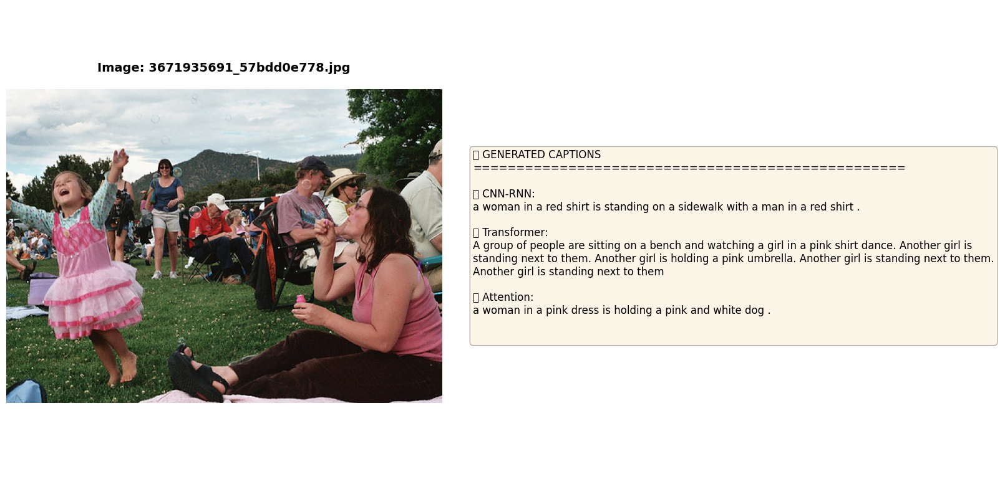


----------------------------------------------------------------------

Example 2/20

📝 Ground Truth:
   men are standing beside a stonesign

📷 Predicting for: 1387461595_2fe6925f73.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: a man in a red shirt and jeans is standing in front of a brick wall .

🔄 Generating with Transformer...
✅ Transformer: A group of people stand outside of a building.........................................

🔄 Generating with Attention Model...
✅ Attention: two men walk down the street .


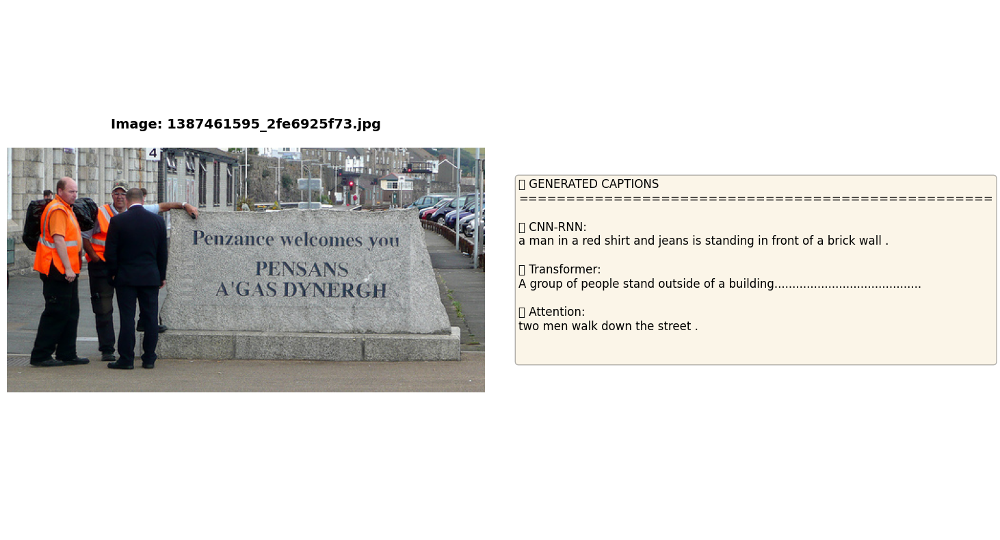


----------------------------------------------------------------------

Example 3/20

📝 Ground Truth:
   A black dog runs on green grass with its mouth open .

📷 Predicting for: 1514957266_a19827c538.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: a black and white dog is running through a field .

🔄 Generating with Transformer...
✅ Transformer: A dog runs through the grass............................................

🔄 Generating with Attention Model...
✅ Attention: a black and white dog runs through the grass .


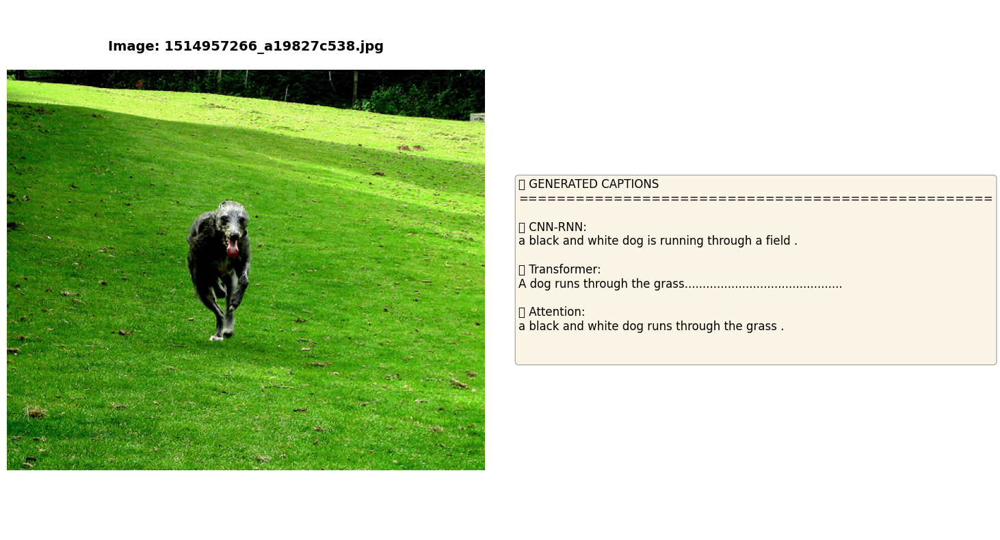


----------------------------------------------------------------------

Example 4/20

📝 Ground Truth:
   A hiker in a red on a snowy peak .

📷 Predicting for: 416960865_048fd3f294.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: a man wearing a red jacket is riding a red bicycle down a snowy hill .

🔄 Generating with Transformer...
✅ Transformer: A man in a red jacket and helmet is standing on a snowy mountain......... a man in a red jacket and helmet is standing on a rock........... a man in

🔄 Generating with Attention Model...
✅ Attention: a man wearing a red jacket and helmet is riding a mountain .


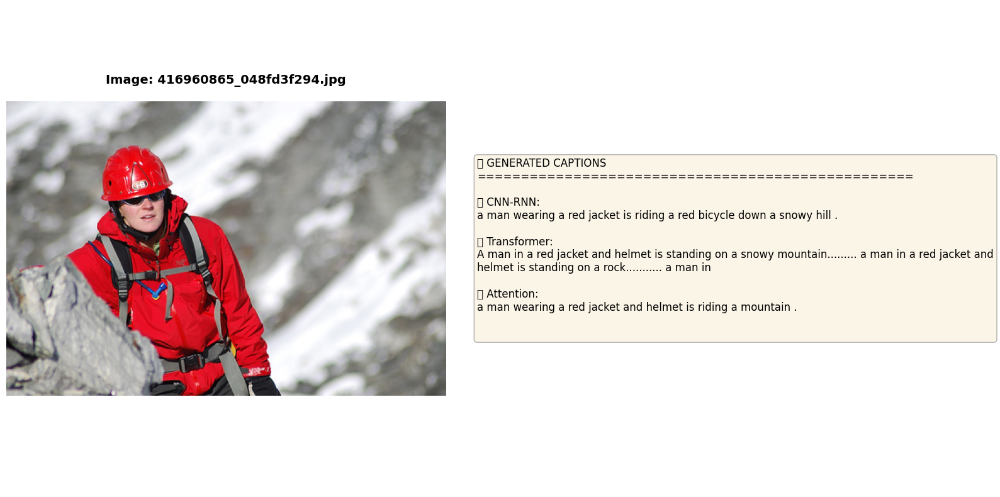


----------------------------------------------------------------------

Example 5/20

📝 Ground Truth:
   A brown dog is shown standing in the water near a muddy beach .

📷 Predicting for: 411175971_0fffd3b8c6.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: a dog is jumping over a log in the sand .

🔄 Generating with Transformer...
✅ Transformer: A dog is running through the water with a stick in its mouth.. Another dog is standing in the water. Another dog is standing in the sand. Another dog is standing in the water. Another dog is standing in the water. Another dog is

🔄 Generating with Attention Model...
✅ Attention: a brown dog is running through the water .


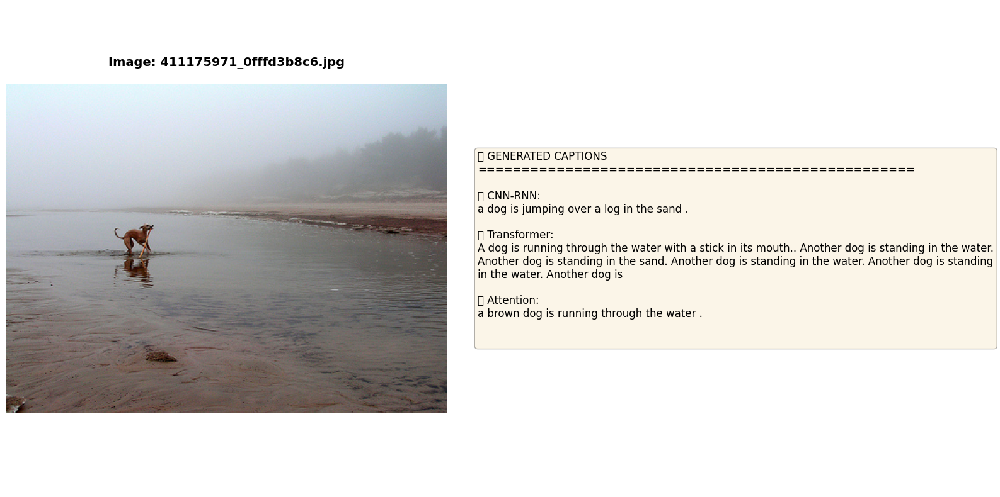


----------------------------------------------------------------------

Example 6/20

📝 Ground Truth:
   prarie dogs that are spotted with , brown black and white

📷 Predicting for: 2904601886_39e9d317b1.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: three dogs are running through a grassy area .

🔄 Generating with Transformer...
✅ Transformer: A group of dogs are playing with a red ball. One dog is jumping in the air. Another dog is jumping in the air. Another dog is jumping in the air. Another dog is jumping in the air. Another dog is jumping in the air

🔄 Generating with Attention Model...
✅ Attention: two dogs are running through a field .


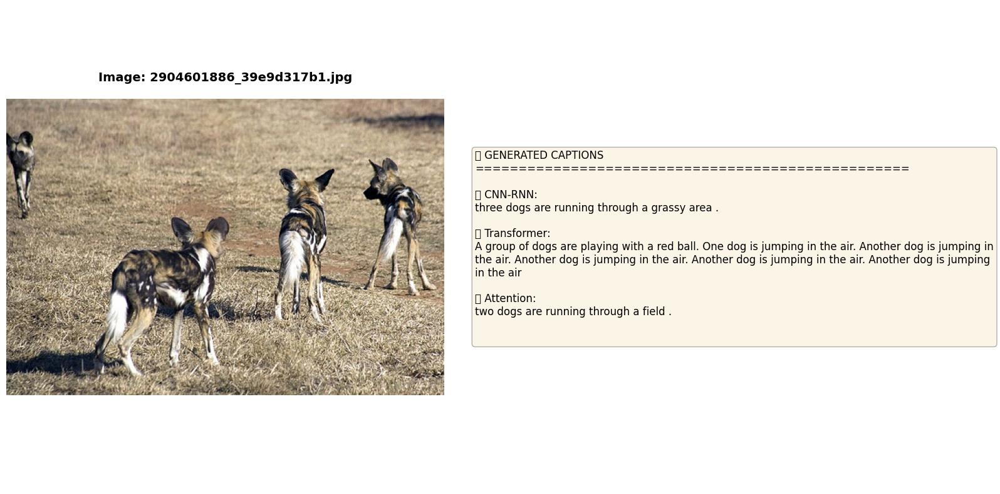


----------------------------------------------------------------------

Example 7/20

📝 Ground Truth:
   A black and white dog is playing with a ball on a lawn .

📷 Predicting for: 214543992_ce6c0d9f9b.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: a black and white dog is jumping over a white fence .

🔄 Generating with Transformer...
✅ Transformer: A black and white dog is catching a Frisbee in a yard. Another dog is catching a Frisbee in a backyard. Frisbee is catching a Frisbee in a backyard. Frisbee is catching a Frisbee in

🔄 Generating with Attention Model...
✅ Attention: a black and white dog is playing with a blue ball .


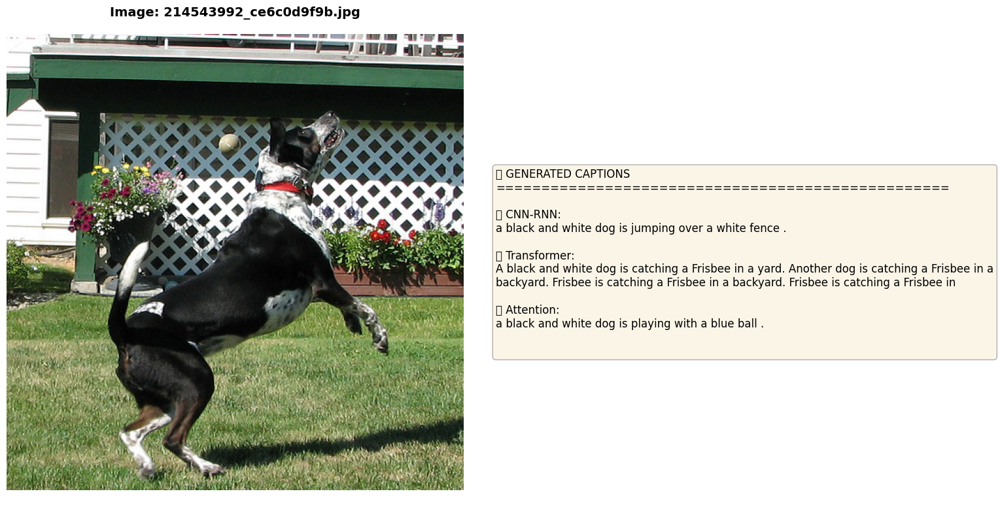


----------------------------------------------------------------------

Example 8/20

📝 Ground Truth:
   A fruit stand with its vendor .

📷 Predicting for: 3133044777_8cc930a4ec.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: a woman in a red jacket is standing in front of a crowd of people .

🔄 Generating with Transformer...
✅ Transformer: A woman is standing in a store selling apples and bananas. Another woman is standing in a store selling apples and bananas. Another woman is standing in a store selling apples and bananas. Another woman is standing in a store selling apples and bananas. Another woman

🔄 Generating with Attention Model...
✅ Attention: a man in a blue shirt is standing in front of a yellow tent .


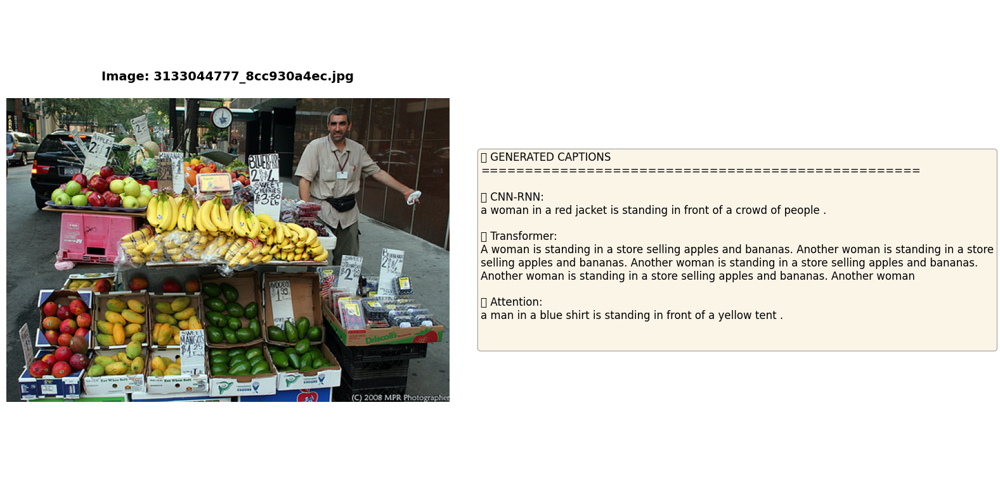


----------------------------------------------------------------------

Example 9/20

📝 Ground Truth:
   A boy sits in the library , reading a book .

📷 Predicting for: 2079110798_ad1370a646.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: a boy wearing a blue shirt is holding a <UNK> .

🔄 Generating with Transformer...
✅ Transformer: A young boy is sitting at a table with a book.......................................

🔄 Generating with Attention Model...
✅ Attention: a small child is holding a baby in a chair .


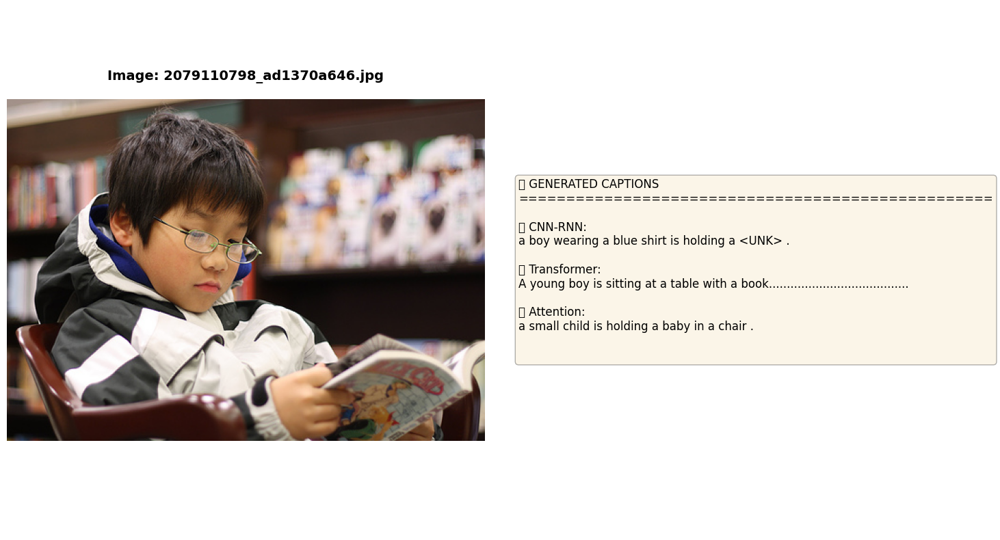


----------------------------------------------------------------------

Example 10/20

📝 Ground Truth:
   A white and brown dog is leaping through the air .

📷 Predicting for: 3028561714_83fb921067.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: a dog is running through a grassy area .

🔄 Generating with Transformer...
✅ Transformer: A dog is running through a field...........................................

🔄 Generating with Attention Model...
✅ Attention: a dog runs through the grass .


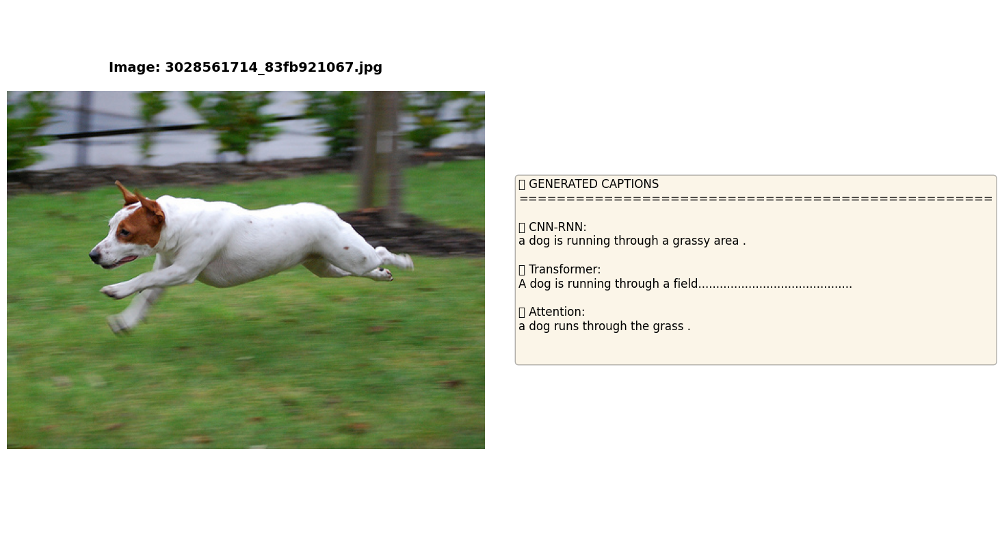


----------------------------------------------------------------------

Example 11/20

📝 Ground Truth:
   A man just caught a fish and it is fiesty !

📷 Predicting for: 3495490064_8db40a83af.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: a young boy wearing a blue shirt and blue jeans is playing with a red ball .

🔄 Generating with Transformer...
✅ Transformer: A man and a child are standing in a field of grass......................................

🔄 Generating with Attention Model...
✅ Attention: a man is sitting on the grass next to a man .


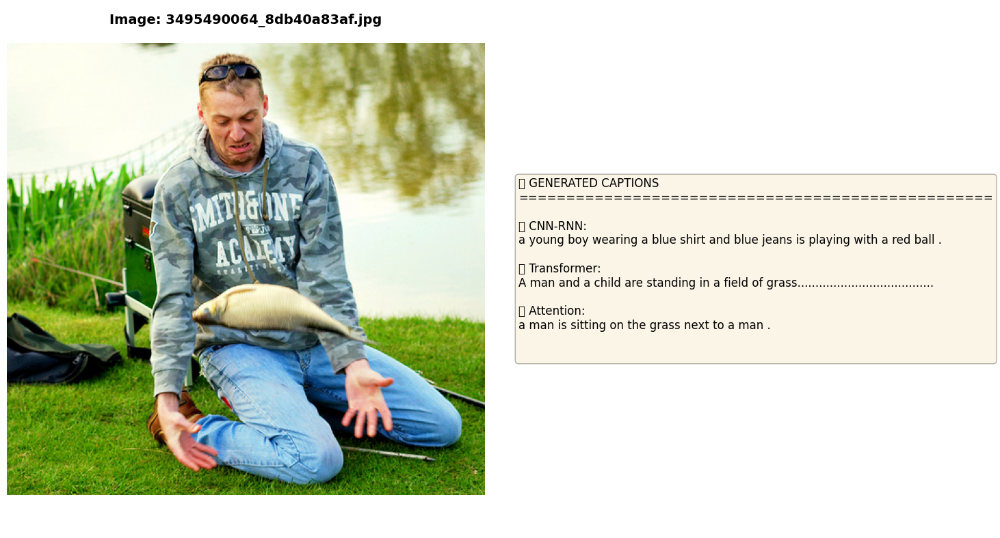


----------------------------------------------------------------------

Example 12/20

📝 Ground Truth:
   A woman and child hug near a road .

📷 Predicting for: 3093970461_825b0cac2f.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: a woman wearing a black hat and a backpack is walking on a sidewalk .

🔄 Generating with Transformer...
✅ Transformer: A girl in a red shirt is riding a bike down a dirt road. She is wearing a pink shirt and blue jeans. She is wearing a pink backpack. She is wearing a pink backpack. She is standing on a dirt path. She is wearing

🔄 Generating with Attention Model...
✅ Attention: a woman in a blue jacket is holding a camera .


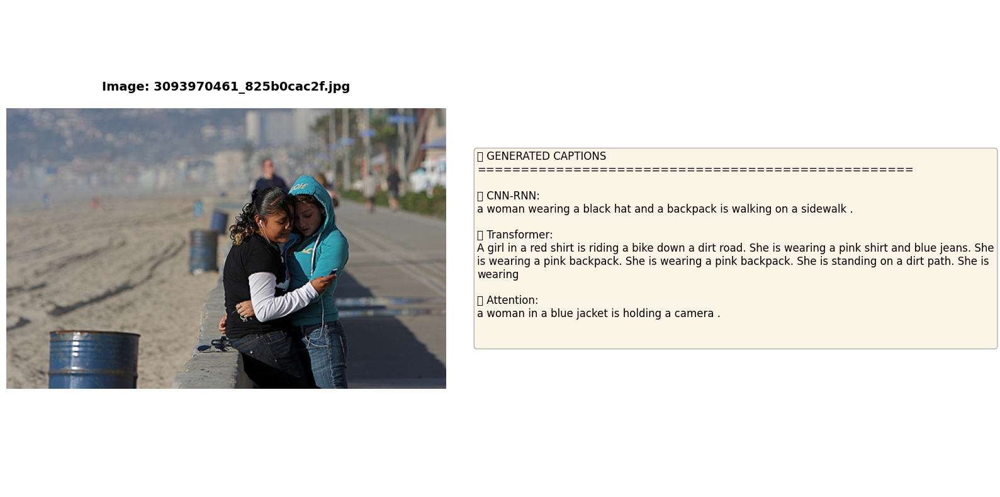


----------------------------------------------------------------------

Example 13/20

📝 Ground Truth:
   A person on a snowboard jumps over a cliff in the snow .

📷 Predicting for: 3351370405_e417e38f52.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: a skier is skiing down a snowy hill .

🔄 Generating with Transformer...
✅ Transformer: A snowboarder is jumping off a ramp.........................................

🔄 Generating with Attention Model...
✅ Attention: a person is jumping off a snowy hill .


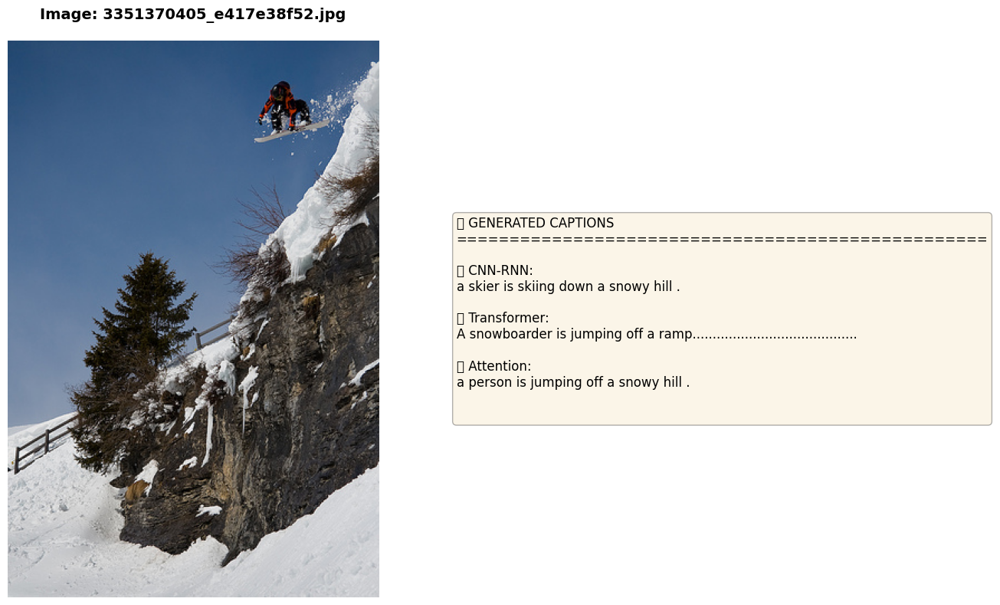


----------------------------------------------------------------------

Example 14/20

📝 Ground Truth:
   A man surfing on a big green wave .

📷 Predicting for: 2949337912_beba55698b.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: a surfer is riding a wave .

🔄 Generating with Transformer...
✅ Transformer: A person in a yellow wetsuit is surfing........................................

🔄 Generating with Attention Model...
✅ Attention: a surfer rides a wave .


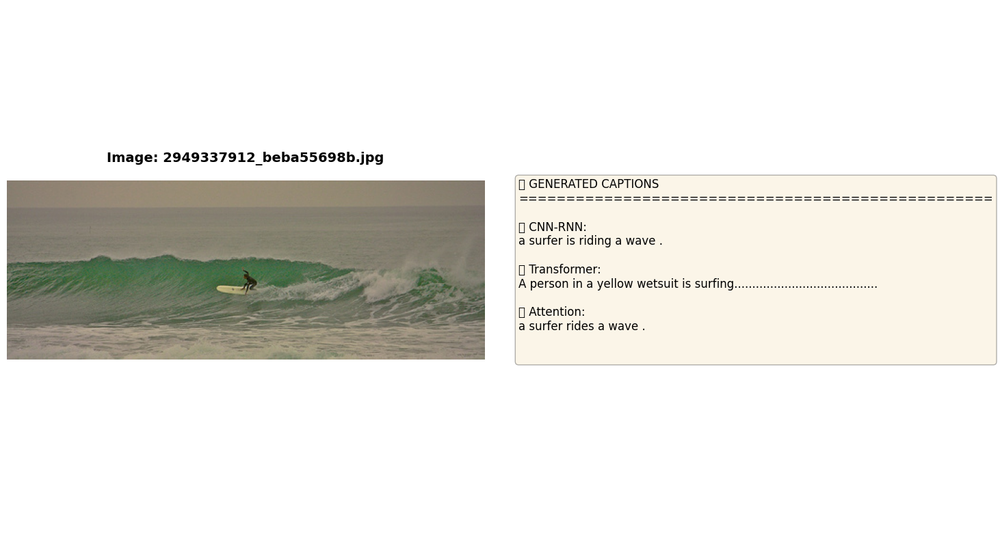


----------------------------------------------------------------------

Example 15/20

📝 Ground Truth:
   A woman is climbing a volleyball net on a beach as two others watch .

📷 Predicting for: 2194797921_96af7a9467.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: a group of children playing in the sand .

🔄 Generating with Transformer...
✅ Transformer: Two girls are standing on the beach with their arms around each other. One girl is holding a ball. Another girl is holding a ball. Another girl is standing on the beach. Another girl is standing on the beach. Another girl is holding a ball

🔄 Generating with Attention Model...
✅ Attention: a group of people are playing on the beach .


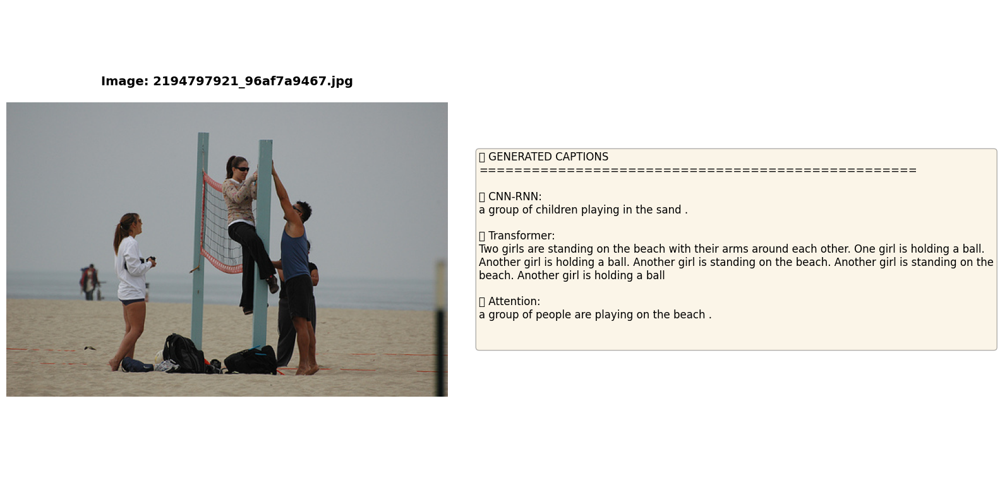


----------------------------------------------------------------------

Example 16/20

📝 Ground Truth:
   A woman leads three little boys in soccer uniforms .

📷 Predicting for: 2266901263_4324af1f03.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: a woman in a red shirt and a man in a blue shirt is standing in a field of

🔄 Generating with Transformer...
✅ Transformer: Two girls are playing soccer in a field. One girl is holding a soccer ball while the other girl is holding a ball. Another girl is running. Soon after, one girl is jumping. Soon after, one girl is jumping. Soon after, one

🔄 Generating with Attention Model...
✅ Attention: a group of people are standing in a field .


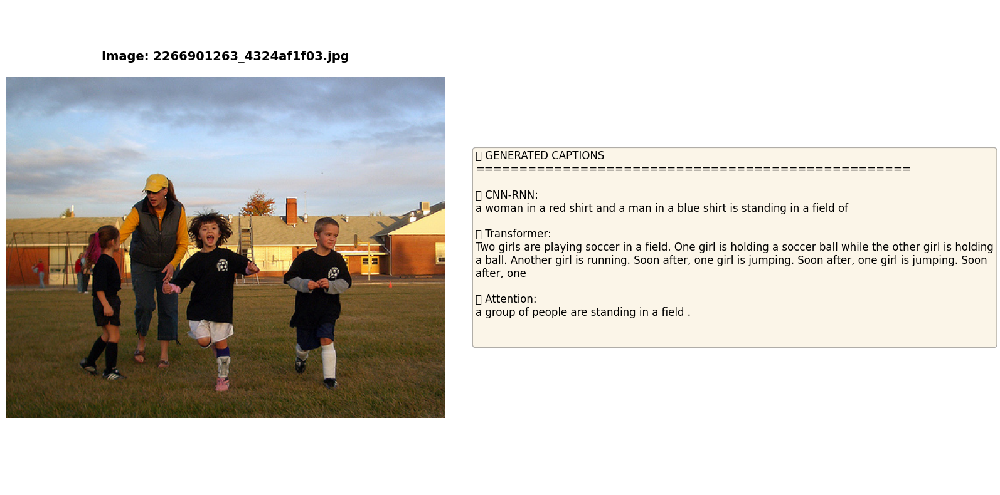


----------------------------------------------------------------------

Example 17/20

📝 Ground Truth:
   A couple ride bikes next to an orange fence by the ocean .

📷 Predicting for: 2541701582_0a651c380f.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: a woman in a red shirt is walking on a sidewalk with a man in the background .

🔄 Generating with Transformer...
✅ Transformer: A woman in a white shirt and black pants is walking down the street with a man in a white shirt and black pants. She is wearing a black hat. She is wearing a black jacket. She is wearing a backpack. She is walking. She

🔄 Generating with Attention Model...
✅ Attention: a woman is walking on a beach with a woman in the background .


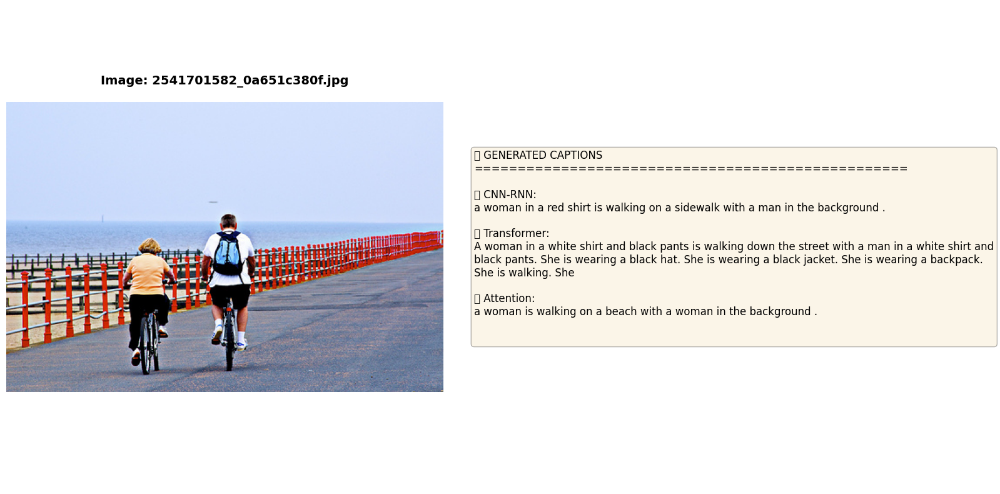


----------------------------------------------------------------------

Example 18/20

📝 Ground Truth:
   A bare chested man with a fierce expression on his face squats on a skateboard beside a furry dog .

📷 Predicting for: 2618538137_44fffe10c4.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: a woman with a white dog is walking on a sidewalk .

🔄 Generating with Transformer...
✅ Transformer: A man and a dog are playing on a park bench.......................................

🔄 Generating with Attention Model...
✅ Attention: a woman with a brown and white dog is walking on a sidewalk .


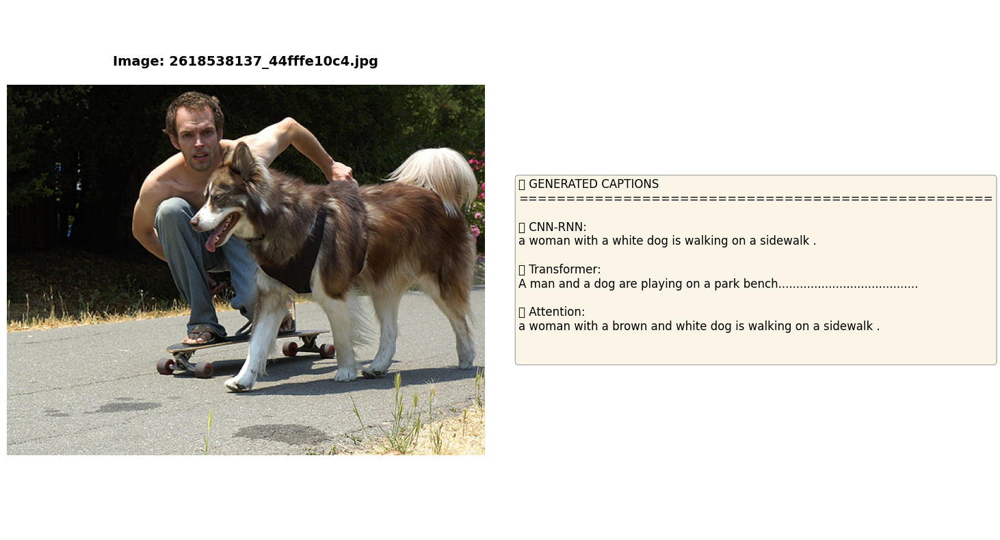


----------------------------------------------------------------------

Example 19/20

📝 Ground Truth:
   A man in cold-weather gear holding a large camera .

📷 Predicting for: 2711720095_0b98426d3c.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: a man wearing a black hat and a hat is standing on a rock .

🔄 Generating with Transformer...
✅ Transformer: A man wearing a black hat and sunglasses is standing next to a man wearing a white hat and sunglasses. Another man is wearing a black hat and sunglasses. Another man is wearing a red hat and sunglasses. Another man is wearing a red hat and sunglasses

🔄 Generating with Attention Model...
✅ Attention: a man in a black jacket and black jacket is standing on a snowy hill .


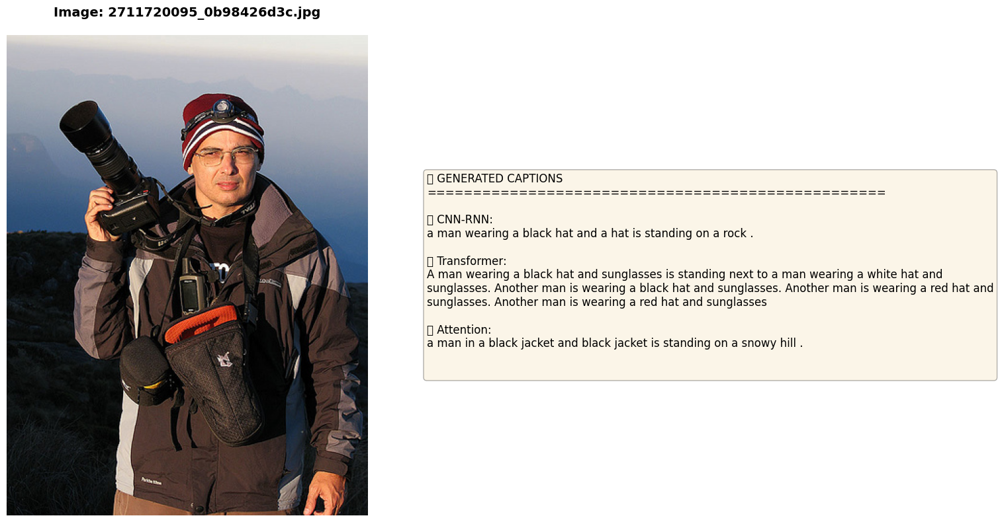


----------------------------------------------------------------------

Example 20/20

📝 Ground Truth:
   A dirt bike rider is in the air pulling off a trick .

📷 Predicting for: 3347798761_5c5260b000.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: a person is riding a horse on a dirt road .

🔄 Generating with Transformer...
✅ Transformer: A man is doing a trick on a dirt bike........................................

🔄 Generating with Attention Model...
✅ Attention: a man is jumping off a dirt bike .


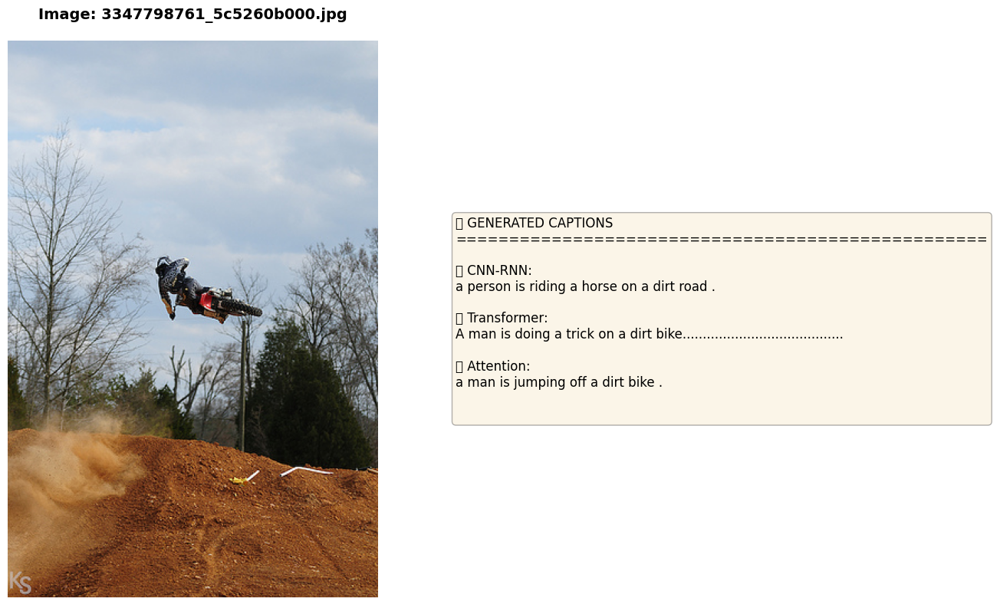


----------------------------------------------------------------------
✅ Custom image prediction function defined

🖼️  CUSTOM IMAGE PREDICTION
📁 Image: /kaggle/input/flickr8k/Images/3422219732_3d0be52cc3.jpg


📷 Predicting for: 3422219732_3d0be52cc3.jpg

🔄 Generating with CNN-RNN...
✅ CNN-RNN: a skier is skiing down a snowy hill .

🔄 Generating with Transformer...
✅ Transformer: A person skis down a snowy mountain.............................. snow covered with snow........

🔄 Generating with Attention Model...
✅ Attention: a man is standing on a snowy mountain .


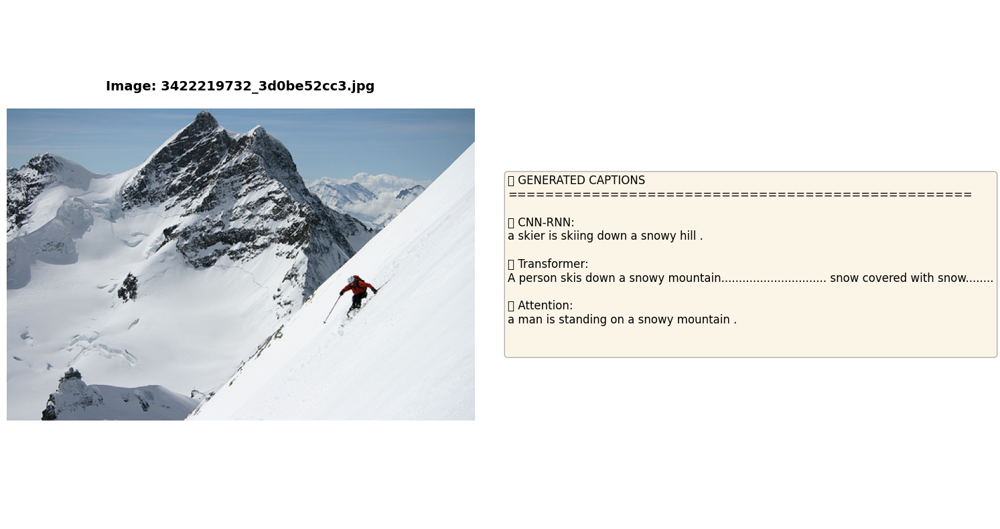


📊 PREDICTION SUMMARY

CNN-RNN:
  a skier is skiing down a snowy hill .

Transformer:
  A person skis down a snowy mountain.............................. snow covered with snow........

Attention:
  a man is standing on a snowy mountain .

✅ Batch prediction function defined
✅ Interactive prediction function defined

📊 PREDICTION MODELS SUMMARY

🔧 Available Functions:
   1. predict_cnn_rnn() - Predict with CNN-RNN model
   2. predict_transformer() - Predict with Transformer model
   3. predict_attention() - Predict with Attention model
   4. predict_image_all_models() - Predict with all models
   5. predict_custom_image() - Predict custom image
   6. batch_predict() - Batch prediction on folder
   7. interactive_predict() - Interactive prediction mode

💡 Usage Examples:
   # Single image
   >>> predictions = predict_custom_image('path/to/image.jpg')

   # Batch prediction
   >>> batch_predict('path/to/folder', 'output.csv')

   # Interactive mode
   >>> interactive_predict()

✅ PREDICT

In [41]:
# %% [markdown]
# ## PHẦN H: PREDICT TRÊN ẢNH MỚI

# %%
import os
from pathlib import Path
from PIL import Image
import matplotlib.pyplot as plt
import torch

print("=" * 70)
print("🔮 PREDICTION ON NEW IMAGES")
print("=" * 70)

# %% [markdown]
# ### 1. Prediction Functions

# %%
def predict_cnn_rnn(image_path, encoder, decoder, vocab, transform, device, max_len=20):
    """
    Predict caption using CNN-RNN model
    
    Args:
        image_path: Path to image file
        encoder: CNN encoder model
        decoder: RNN decoder model
        vocab: Vocabulary object
        transform: Image transform
        device: Device to run on
        max_len: Maximum caption length
    
    Returns:
        caption: Generated caption string
    """
    encoder.eval()
    decoder.eval()
    
    # Load and preprocess image
    image = Image.open(image_path).convert("RGB")
    image_tensor = transform(image).unsqueeze(0).to(device)
    
    with torch.no_grad():
        # Encode image
        feature = encoder(image_tensor)
        
        # Generate caption
        states = None
        sampled_ids = []
        inputs = feature.unsqueeze(1)
        
        for _ in range(max_len):
            hiddens, states = decoder.lstm(inputs, states)
            outputs = decoder.linear(hiddens.squeeze(1))
            _, predicted = outputs.max(1)
            
            word_id = predicted.item()
            sampled_ids.append(word_id)
            
            if word_id == vocab.stoi["<EOS>"]:
                break
                
            inputs = decoder.embed(predicted).unsqueeze(1)
        
        # Convert IDs to words
        caption_words = [vocab.itos.get(i, "<UNK>") for i in sampled_ids 
                        if i not in [vocab.stoi["<EOS>"], vocab.stoi["<SOS>"], vocab.stoi["<PAD>"]]]
        
        return ' '.join(caption_words)

def predict_transformer(image_path, model, tokenizer, transform, device, max_length=50):
    """
    Predict caption using Transformer model (ViT + GPT2)
    
    Args:
        image_path: Path to image file
        model: VisionEncoderDecoderModel
        tokenizer: GPT2 tokenizer
        transform: Image transform
        device: Device to run on
        max_length: Maximum caption length
    
    Returns:
        caption: Generated caption string
    """
    model.eval()
    
    # Load and preprocess image
    image = Image.open(image_path).convert("RGB")
    pixel_values = transform(image).unsqueeze(0).to(device)
    
    # Generate caption
    caption = model.generate_caption(pixel_values, tokenizer, max_length=max_length, device=device)
    
    return caption

def predict_attention(image_path, encoder, decoder, vocab, transform, device, beam_size=5, max_len=50):
    """
    Predict caption using Attention model with Beam Search
    
    Args:
        image_path: Path to image file
        encoder: AttentionEncoder model
        decoder: AttentionDecoder model
        vocab: Vocabulary object
        transform: Image transform
        device: Device to run on
        beam_size: Beam size for beam search
        max_len: Maximum caption length
    
    Returns:
        caption: Generated caption string
    """
    encoder.eval()
    decoder.eval()
    
    # Load and preprocess image
    image = Image.open(image_path).convert("RGB")
    image_tensor = transform(image).unsqueeze(0).to(device)
    
    # Generate with beam search
    caption_words = beam_search_caption(
        encoder, decoder, image_tensor, vocab, 
        beam_size=beam_size, max_len=max_len, device=device
    )
    
    return ' '.join(caption_words)

print("✅ Prediction functions defined")

# %% [markdown]
# ### 2. Unified Prediction Function

# %%
def predict_image_all_models(image_path, device='cuda'):
    """
    Generate captions for an image using all 3 models
    
    Args:
        image_path: Path to image file (str or Path)
        device: Device to run on
    
    Returns:
        dict: Dictionary with captions from all models
    """
    image_path = Path(image_path)
    
    if not image_path.exists():
        raise FileNotFoundError(f"Image not found: {image_path}")
    
    print(f"\n{'='*70}")
    print(f"📷 Predicting for: {image_path.name}")
    print(f"{'='*70}\n")
    
    results = {}
    
    # 1. CNN-RNN Model
    try:
        print("🔄 Generating with CNN-RNN...")
        caption_cnn = predict_cnn_rnn(
            image_path, encoder_en, decoder_en, vocab_en, 
            transform, device
        )
        results['CNN-RNN'] = caption_cnn
        print(f"✅ CNN-RNN: {caption_cnn}")
    except Exception as e:
        results['CNN-RNN'] = f"Error: {str(e)}"
        print(f"❌ CNN-RNN Error: {e}")
    
    # 2. Transformer Model
    try:
        print("\n🔄 Generating with Transformer...")
        caption_transformer = predict_transformer(
            image_path, model_en_transformer, tokenizer_en, 
            eval_transform, device
        )
        results['Transformer'] = caption_transformer
        print(f"✅ Transformer: {caption_transformer}")
    except Exception as e:
        results['Transformer'] = f"Error: {str(e)}"
        print(f"❌ Transformer Error: {e}")
    
    # 3. Attention Model
    try:
        print("\n🔄 Generating with Attention Model...")
        caption_attention = predict_attention(
            image_path, attention_encoder_en, attention_decoder_en, 
            vocab_en, transform_attention, device, beam_size=5
        )
        results['Attention'] = caption_attention
        print(f"✅ Attention: {caption_attention}")
    except Exception as e:
        results['Attention'] = f"Error: {str(e)}"
        print(f"❌ Attention Error: {e}")
    
    return results

print("✅ Unified prediction function defined")

# %% [markdown]
# ### 3. Visualization Function

# %%
def visualize_prediction(image_path, predictions, save_path=None):
    """
    Visualize image with predictions from all models
    
    Args:
        image_path: Path to image file
        predictions: Dict with model predictions
        save_path: Optional path to save figure
    """
    image = Image.open(image_path).convert("RGB")
    
    # Create figure
    fig, axes = plt.subplots(1, 2, figsize=(16, 8))
    
    # Left: Display image
    axes[0].imshow(image)
    axes[0].axis('off')
    axes[0].set_title(f"Image: {Path(image_path).name}", 
                     fontsize=14, fontweight='bold', pad=20)
    
    # Right: Display predictions
    axes[1].axis('off')
    
    # Format predictions text
    pred_text = "📝 GENERATED CAPTIONS\n" + "="*50 + "\n\n"
    
    for i, (model_name, caption) in enumerate(predictions.items(), 1):
        icon = "🤖" if not caption.startswith("Error") else "❌"
        pred_text += f"{icon} {model_name}:\n{caption}\n\n"
    
    axes[1].text(
        0.05, 0.5, pred_text, 
        fontsize=12,
        verticalalignment='center',
        wrap=True,
        bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.3)
    )
    
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=150, bbox_inches='tight')
        print(f"💾 Saved to: {save_path}")
    
    plt.show()

print("✅ Visualization function defined")

# %% [markdown]
# ### 4. Example Usage - Predict on Test Images

# %%
# Select random test images
import random

sample_images = random.sample(test_imgs, min(20, len(test_imgs)))

print("\n" + "="*70)
print("🎯 PREDICTION EXAMPLES")
print("="*70)

for idx, img_name in enumerate(sample_images, 1):
    img_path = IMG_DIR / img_name
    
    print(f"\n{'='*70}")
    print(f"Example {idx}/{len(sample_images)}")
    print(f"{'='*70}")
    
    # Get ground truth
    print(f"\n📝 Ground Truth:")
    print(f"   {en_test_caps[img_name][0]}")
    
    # Predict with all models
    predictions = predict_image_all_models(img_path, device)
    
    # Visualize
    visualize_prediction(img_path, predictions)
    
    print("\n" + "-"*70)

# %% [markdown]
# ### 5. Predict on Custom Image (User Upload)

# %%
def predict_custom_image(image_path, device='cuda'):
    """
    Predict caption for a custom image (outside dataset)
    
    Args:
        image_path: Path to custom image file
        device: Device to run on
    
    Usage:
        >>> predict_custom_image('/path/to/your/image.jpg')
    """
    image_path = Path(image_path)
    
    if not image_path.exists():
        print(f"❌ Image not found: {image_path}")
        return
    
    print(f"\n{'='*70}")
    print(f"🖼️  CUSTOM IMAGE PREDICTION")
    print(f"{'='*70}")
    print(f"📁 Image: {image_path}")
    print(f"{'='*70}\n")
    
    # Predict with all models
    predictions = predict_image_all_models(image_path, device)
    
    # Visualize
    visualize_prediction(image_path, predictions)
    
    # Print summary
    print("\n" + "="*70)
    print("📊 PREDICTION SUMMARY")
    print("="*70)
    for model_name, caption in predictions.items():
        print(f"\n{model_name}:")
        print(f"  {caption}")
    print("\n" + "="*70)
    
    return predictions

print("✅ Custom image prediction function defined")

# %% [markdown]
# ### 6. Example: Predict on a specific image

# %%
# Example 1: Predict on a test image
sample_img = IMG_DIR / test_imgs[0]
predictions = predict_custom_image(sample_img, device)

# %%
# Example 2: Uncomment and replace with your own image path
# custom_img_path = "/path/to/your/image.jpg"
# predictions = predict_custom_image(custom_img_path, device)

# %% [markdown]
# ### 7. Batch Prediction Function

# %%
def batch_predict(image_folder, output_csv='predictions.csv', device='cuda'):
    """
    Predict captions for all images in a folder
    
    Args:
        image_folder: Path to folder containing images
        output_csv: Path to save predictions CSV
        device: Device to run on
    """
    import csv
    from pathlib import Path
    
    image_folder = Path(image_folder)
    image_files = list(image_folder.glob('*.jpg')) + list(image_folder.glob('*.png'))
    
    if not image_files:
        print(f"❌ No images found in {image_folder}")
        return
    
    print(f"\n{'='*70}")
    print(f"📦 BATCH PREDICTION")
    print(f"{'='*70}")
    print(f"📁 Folder: {image_folder}")
    print(f"🖼️  Images: {len(image_files)}")
    print(f"{'='*70}\n")
    
    results = []
    
    for img_path in tqdm(image_files, desc="Predicting"):
        try:
            predictions = predict_image_all_models(img_path, device)
            results.append({
                'image': img_path.name,
                'cnn_rnn': predictions.get('CNN-RNN', ''),
                'transformer': predictions.get('Transformer', ''),
                'attention': predictions.get('Attention', '')
            })
        except Exception as e:
            print(f"⚠️  Error on {img_path.name}: {e}")
            results.append({
                'image': img_path.name,
                'cnn_rnn': f'Error: {e}',
                'transformer': f'Error: {e}',
                'attention': f'Error: {e}'
            })
    
    # Save to CSV
    with open(output_csv, 'w', newline='', encoding='utf-8') as f:
        writer = csv.DictWriter(f, fieldnames=['image', 'cnn_rnn', 'transformer', 'attention'])
        writer.writeheader()
        writer.writerows(results)
    
    print(f"\n✅ Predictions saved to: {output_csv}")
    return results

print("✅ Batch prediction function defined")

# %% [markdown]
# ### 8. Interactive Prediction (Optional)

# %%
def interactive_predict(device='cuda'):
    """
    Interactive prediction loop
    User can input image paths to get predictions
    """
    print("\n" + "="*70)
    print("🎮 INTERACTIVE PREDICTION MODE")
    print("="*70)
    print("Enter image path (or 'quit' to exit)")
    print("="*70 + "\n")
    
    while True:
        user_input = input("📁 Image path: ").strip()
        
        if user_input.lower() in ['quit', 'exit', 'q']:
            print("👋 Exiting...")
            break
        
        if not user_input:
            continue
        
        try:
            predict_custom_image(user_input, device)
        except Exception as e:
            print(f"❌ Error: {e}\n")

print("✅ Interactive prediction function defined")

# %% [markdown]
# ### 9. Save Prediction Models Summary

# %%
print("\n" + "="*70)
print("📊 PREDICTION MODELS SUMMARY")
print("="*70)

print("\n🔧 Available Functions:")
print("   1. predict_cnn_rnn() - Predict with CNN-RNN model")
print("   2. predict_transformer() - Predict with Transformer model")
print("   3. predict_attention() - Predict with Attention model")
print("   4. predict_image_all_models() - Predict with all models")
print("   5. predict_custom_image() - Predict custom image")
print("   6. batch_predict() - Batch prediction on folder")
print("   7. interactive_predict() - Interactive prediction mode")

print("\n💡 Usage Examples:")
print("   # Single image")
print("   >>> predictions = predict_custom_image('path/to/image.jpg')")
print()
print("   # Batch prediction")
print("   >>> batch_predict('path/to/folder', 'output.csv')")
print()
print("   # Interactive mode")
print("   >>> interactive_predict()")

print("\n" + "="*70)
print("✅ PREDICTION MODULE READY!")
print("="*70)